In [1]:
import numpy as np
import matplotlib.pyplot as plt
import sklearn.metrics as metrics
import tensorflow as tf
from tensorflow.keras import backend as K

from SupervisedAD_methods import *

## Data

In [2]:
ratio = 0.75
data = generate_data(100, ratio=ratio, seed=0)

data.shape

(100, 3)

In [3]:
data_test = generate_data(100, ratio=ratio, fake_r=0.5, seed=100)

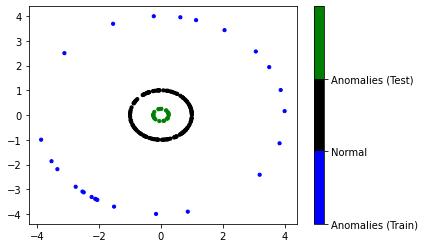

In [4]:
X = data[:, :-1]
y = data[:, -1]
x_test = data_test[:, :-1]
y_test = data_test[:, -1]

# for plotting: visualise 2 different OOD classes
y_test_transform = np.abs((y_test-1))+1

import matplotlib
x_plot = np.vstack((X, x_test))
colours = ["blue", "black", "green"]
plt.scatter(x_plot[:, 0], x_plot[:, 1], c=np.hstack((y, y_test_transform)),
            cmap=matplotlib.colors.ListedColormap(colours), s=10)
cb = plt.colorbar()
loc = np.arange(0, 2, 2/float(len(colours)))
cb.set_ticks(loc)
cb.set_ticklabels(["Anomalies (Train)", "Normal", "Anomalies (Test)"])
plt.show()

In [5]:
lim = 2.25
grid = int(lim*100*2)
a = np.linspace(-lim, lim, grid)
xv, yv = np.meshgrid(a, a)
data_viz = np.hstack((xv.reshape(-1, 1), yv.reshape(-1, 1)))

radius_sq = (data_viz ** 2).sum(axis=1)
radius2 = (np.abs(radius_sq - 4) < 1e-1).reshape(grid, grid)
radius1 = (np.abs(radius_sq - 1) < 5e-2).reshape(grid, grid)
radius05 = (np.abs(radius_sq - 0.25) < 3e-2).reshape(grid, grid)

xv.shape, data_viz.shape

((450, 450), (202500, 2))

# Training Neural Networks with 3 Hidden Layers

## Halfspace Separation

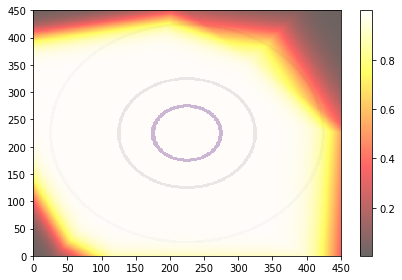

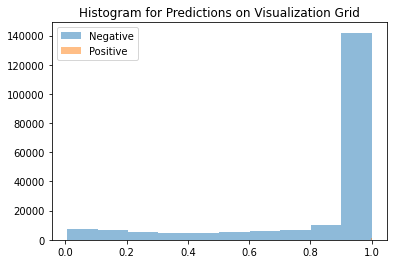

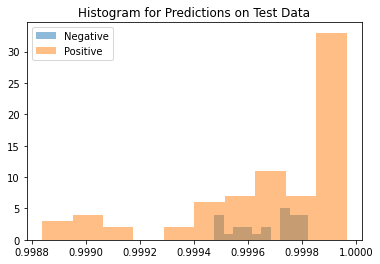

Average Difference between Positive and Negative Class: 1.6093254089355469e-06


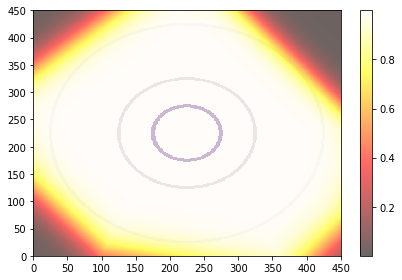

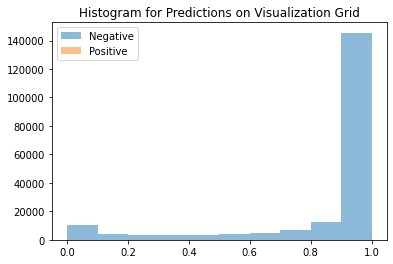

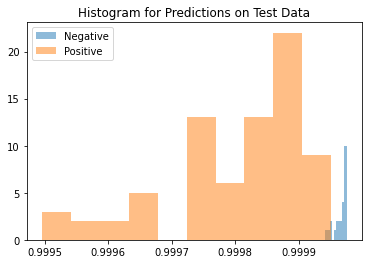

Average Difference between Positive and Negative Class: -0.00016367435455322266


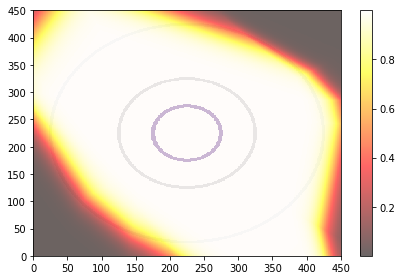

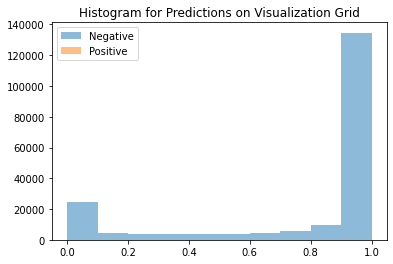

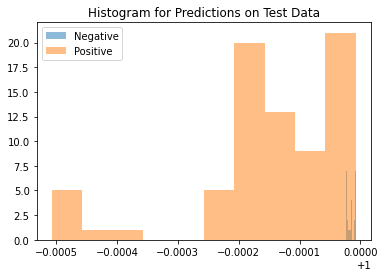

Average Difference between Positive and Negative Class: -0.000133514404296875


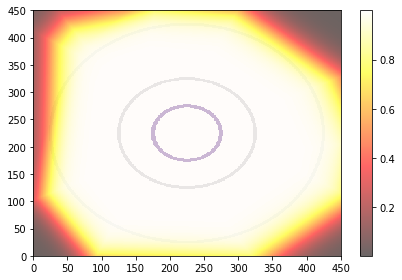

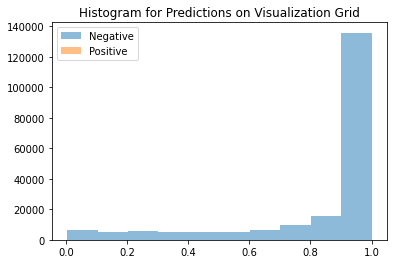

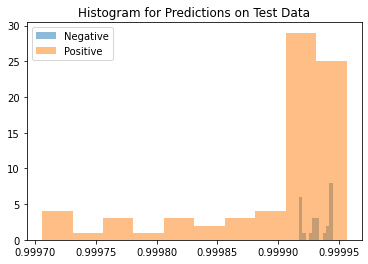

Average Difference between Positive and Negative Class: -3.3020973205566406e-05


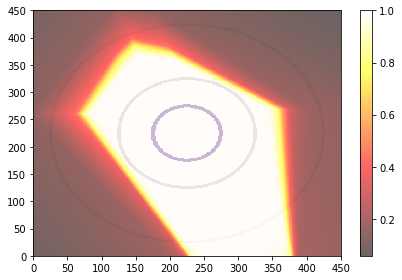

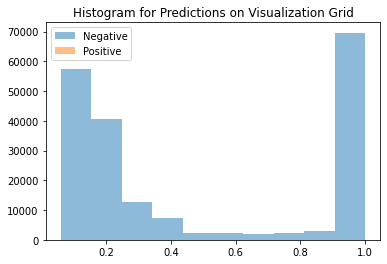

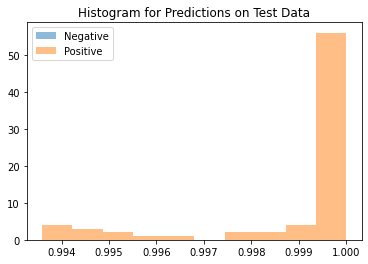

Average Difference between Positive and Negative Class: -0.0009563565254211426


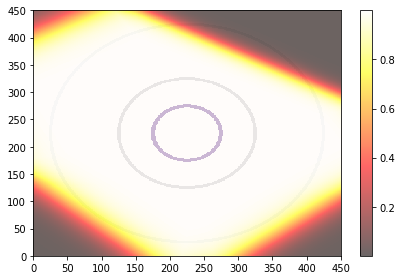

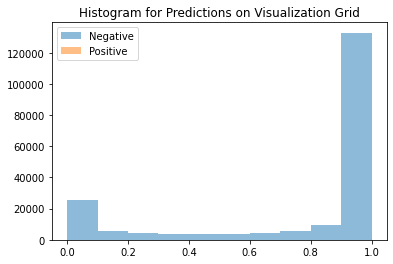

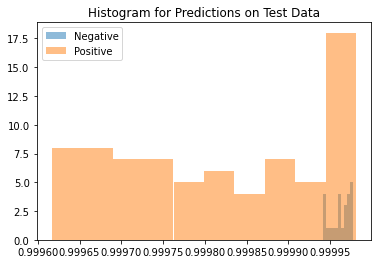

Average Difference between Positive and Negative Class: -0.00014764070510864258


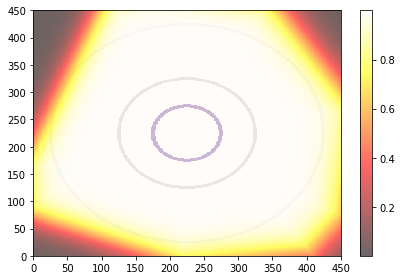

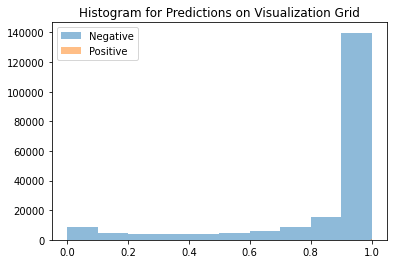

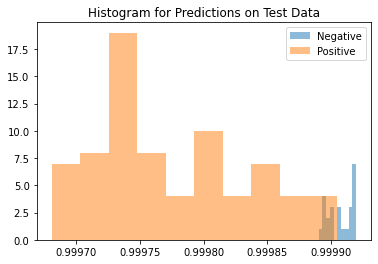

Average Difference between Positive and Negative Class: -0.00013214349746704102


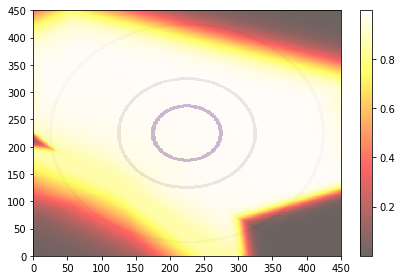

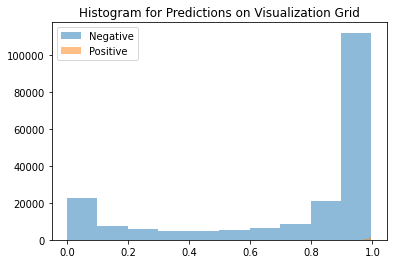

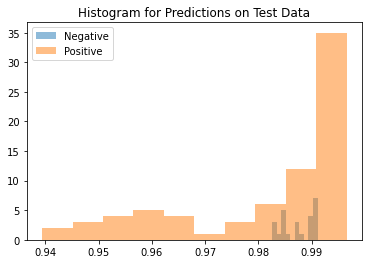

Average Difference between Positive and Negative Class: -0.0057190656661987305


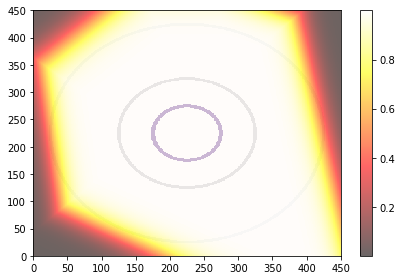

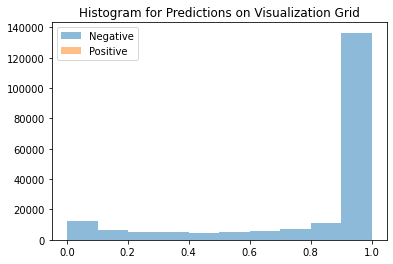

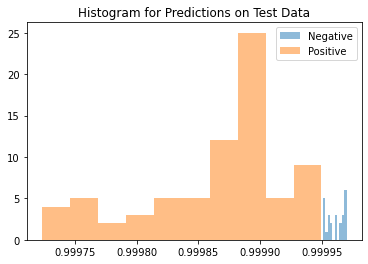

Average Difference between Positive and Negative Class: -9.72747802734375e-05


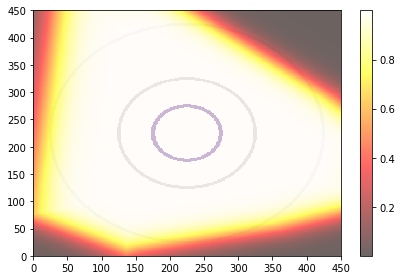

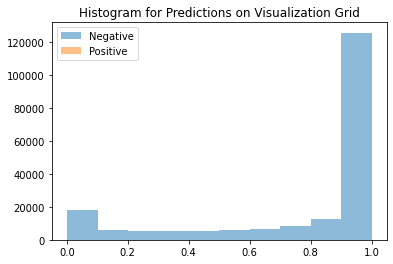

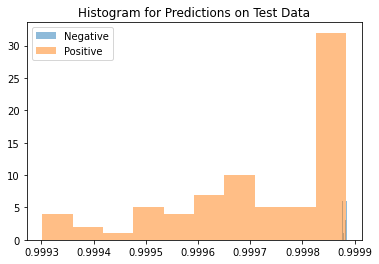

Average Difference between Positive and Negative Class: -0.00016057491302490234


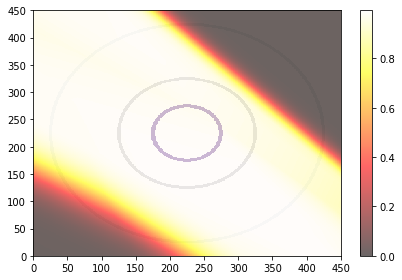

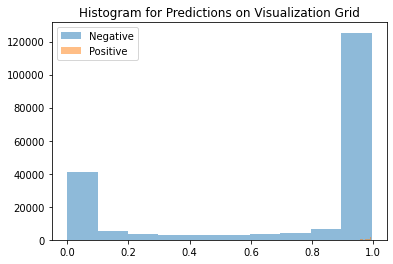

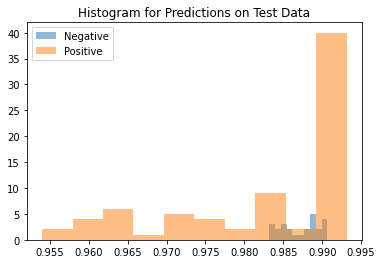

Average Difference between Positive and Negative Class: -0.0047740936279296875


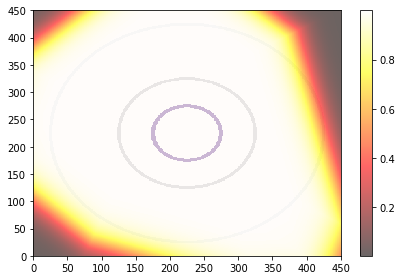

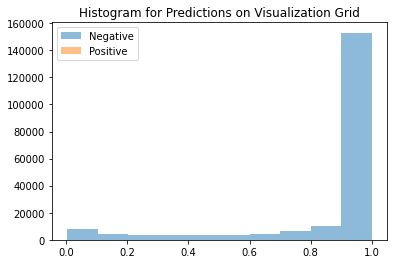

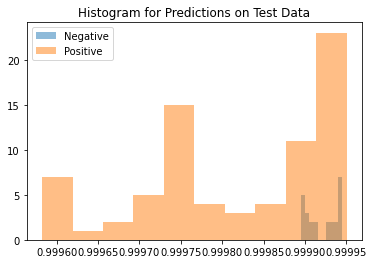

Average Difference between Positive and Negative Class: -0.00010526180267333984


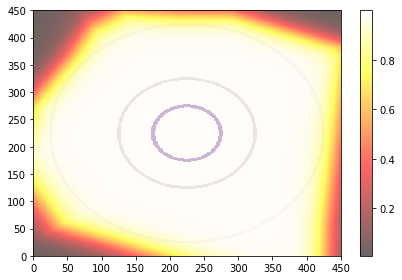

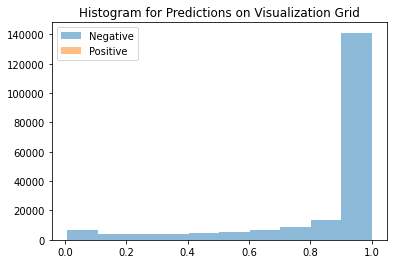

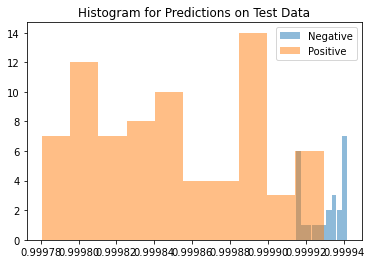

Average Difference between Positive and Negative Class: -8.016824722290039e-05


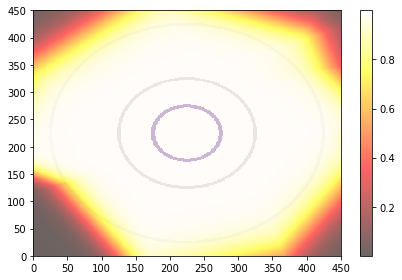

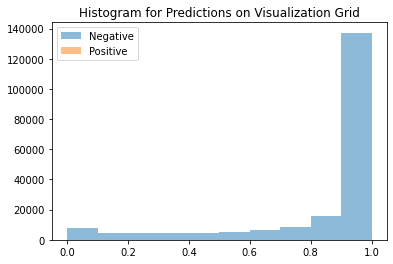

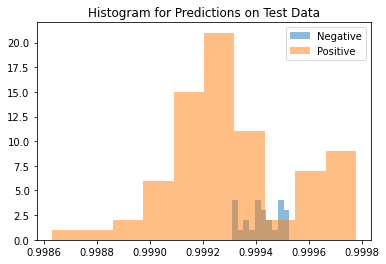

Average Difference between Positive and Negative Class: -0.00011456012725830078


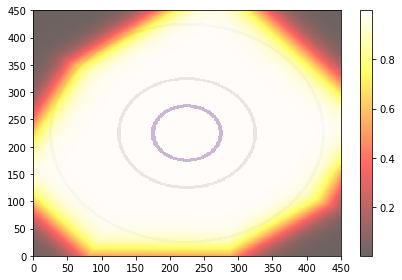

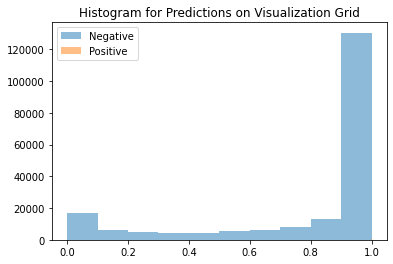

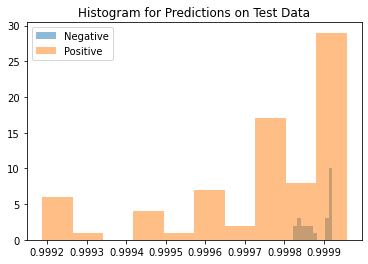

Average Difference between Positive and Negative Class: -0.0001404881477355957


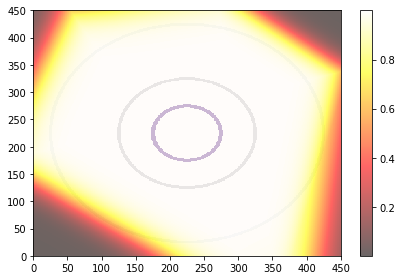

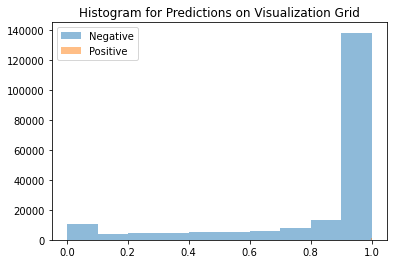

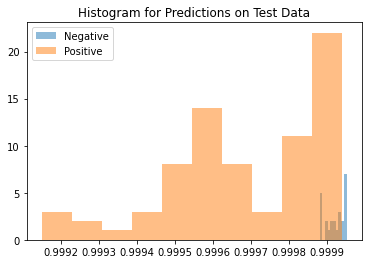

Average Difference between Positive and Negative Class: -0.00023037195205688477


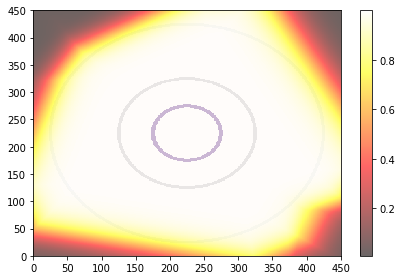

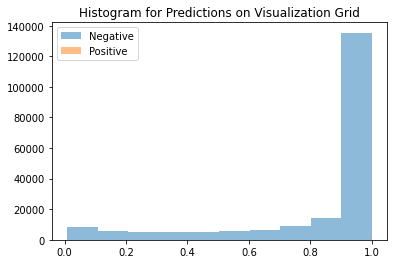

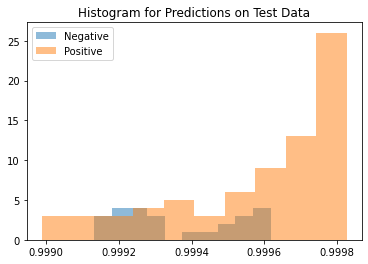

Average Difference between Positive and Negative Class: 0.0002181529998779297


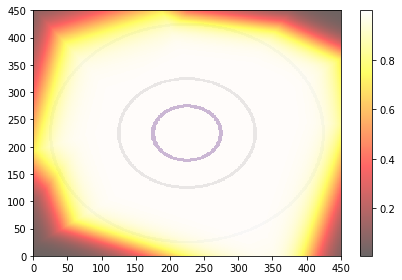

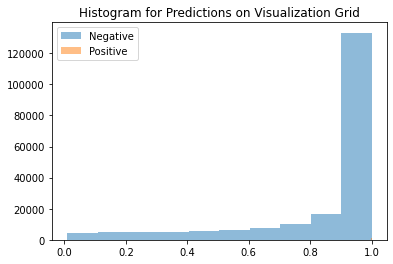

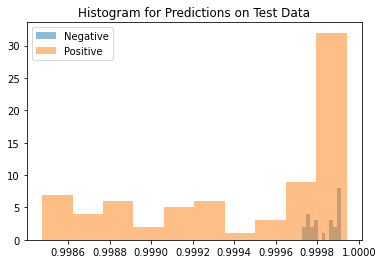

Average Difference between Positive and Negative Class: -0.0003769993782043457


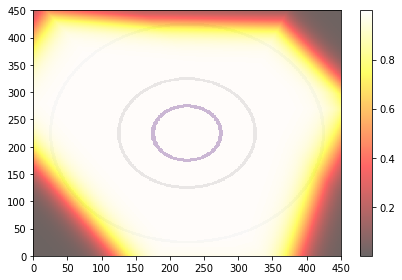

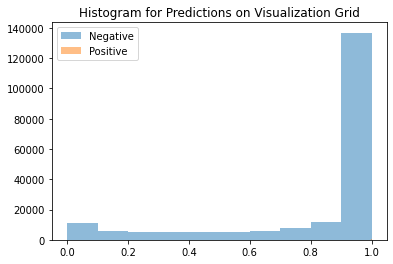

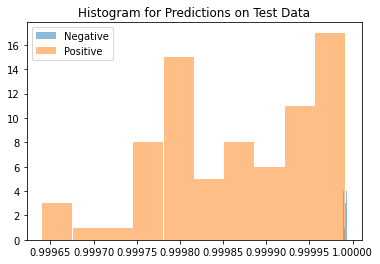

Average Difference between Positive and Negative Class: -0.00012385845184326172


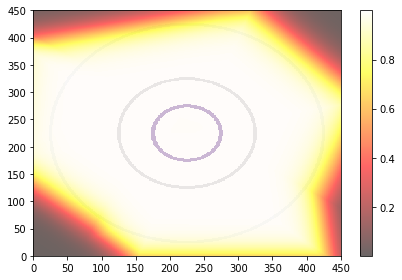

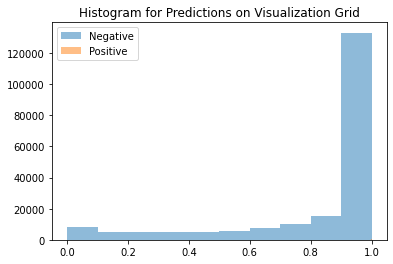

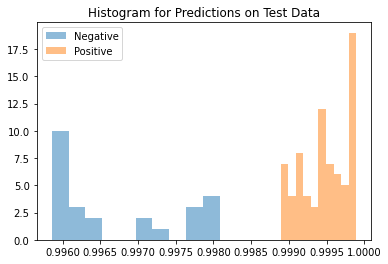

Average Difference between Positive and Negative Class: 0.0027613043785095215
AUPR (Train): 0.9998642625291883+-0.0005916659181205827
AUPR (Test): 0.6876060309048683+-0.1471184121032756
Average Distance between Means: -0.0005254000425338745+-0.0017167835030704737


([1.0,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  1.0000000000000002,
  1.0,
  1.0,
  0.9999999999999999,
  0.9999999999999998,
  0.9999999999999999,
  0.9972852505837633,
  0.9999999999999998,
  0.9999999999999998,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  1.0,
  1.0,
  0.9999999999999999,
  1.0],
 [0.8783606866608693,
  0.537980862038562,
  0.5565356674246834,
  0.7790032264537683,
  0.6429840529099724,
  0.6363290575845334,
  0.5395791335655808,
  0.8533191921991397,
  0.5378372879874669,
  0.5521743463674205,
  0.843990293191784,
  0.6127541785739647,
  0.540511615830544,
  0.7234134790758986,
  0.7134200099752342,
  0.5639770040778476,
  0.9311451702487189,
  0.767911356121709,
  0.5408939978096674,
  0.9999999999999999],
 [1.6093254e-06,
  -0.00016367435,
  -0.0001335144,
  -3.3020973e-05,
  -0.0009563565,
  -0.0001476407,
  -0.0001321435,
  -0.0057190657,
  -9.727478e-05,
  -0.00016057491,
  -0.0047740936,
  -0.0001052618,
  -8.016825e-05,
  -0.00011456013,


In [6]:
# HS3
separation = "HS"
bumped = ""
sigma = 0.5
hidden_layers = 3
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='binary_crossentropy',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

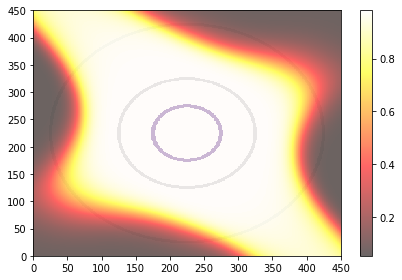

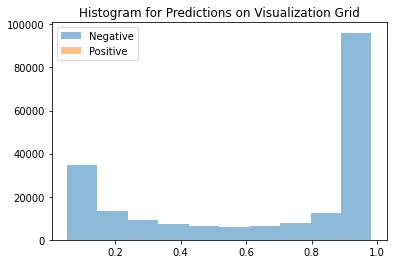

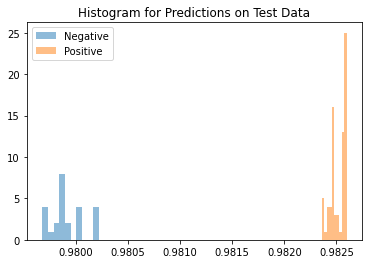

Average Difference between Positive and Negative Class: 0.002604365348815918


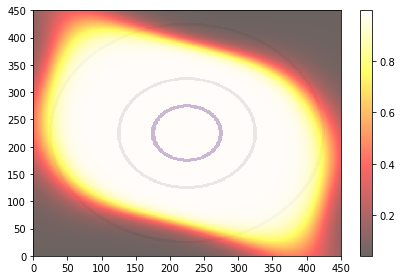

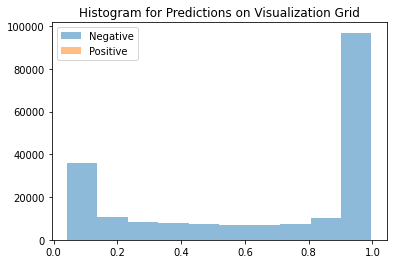

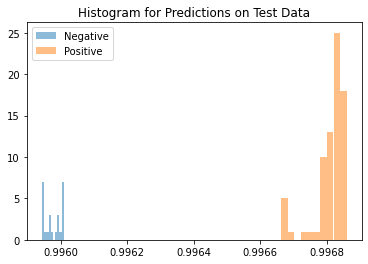

Average Difference between Positive and Negative Class: 0.0008344650268554688


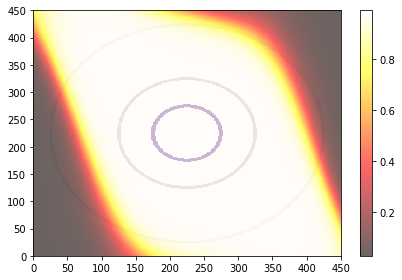

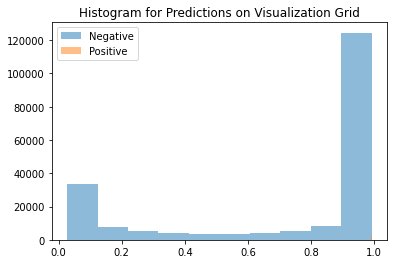

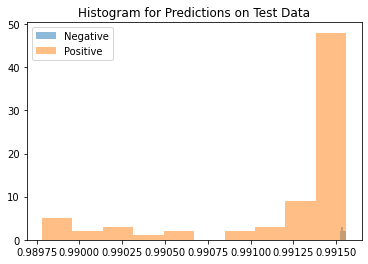

Average Difference between Positive and Negative Class: -0.00031942129135131836


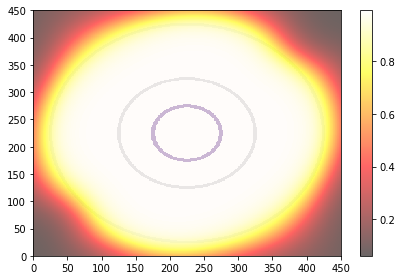

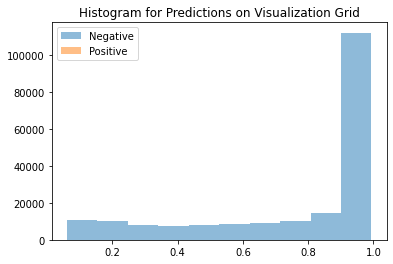

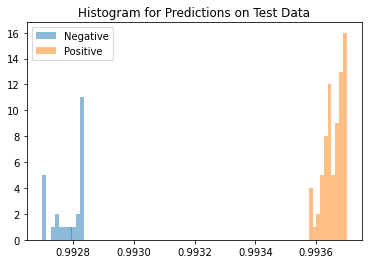

Average Difference between Positive and Negative Class: 0.0008732080459594727


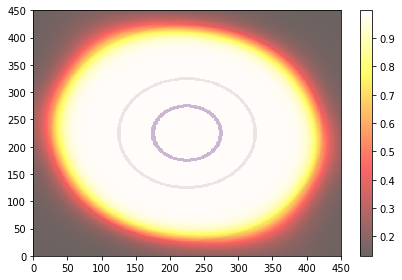

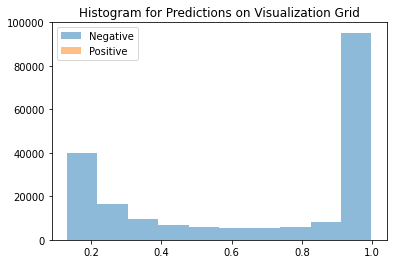

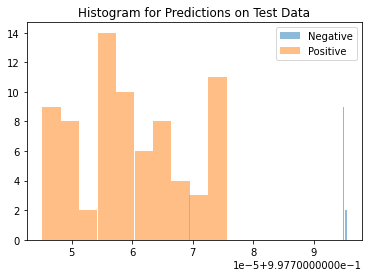

Average Difference between Positive and Negative Class: -3.510713577270508e-05


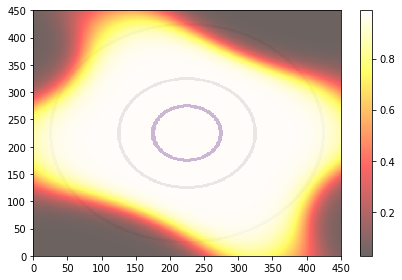

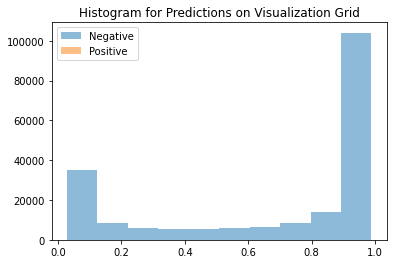

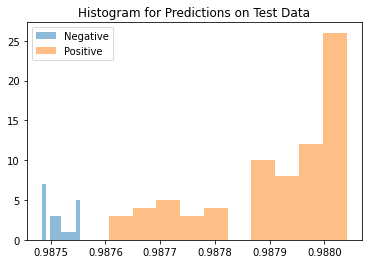

Average Difference between Positive and Negative Class: 0.0003924369812011719


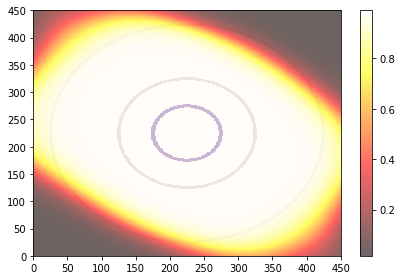

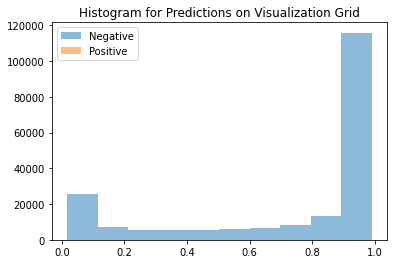

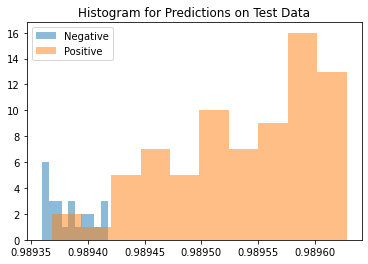

Average Difference between Positive and Negative Class: 0.00015407800674438477


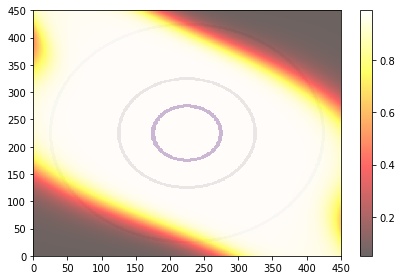

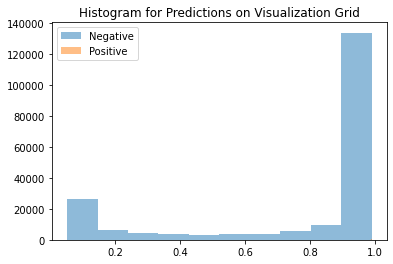

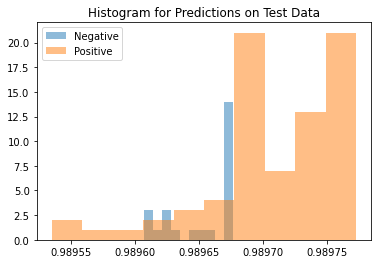

Average Difference between Positive and Negative Class: 5.453824996948242e-05


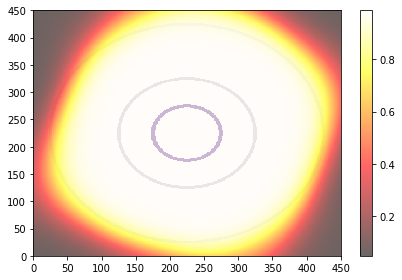

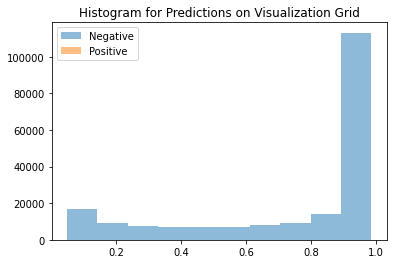

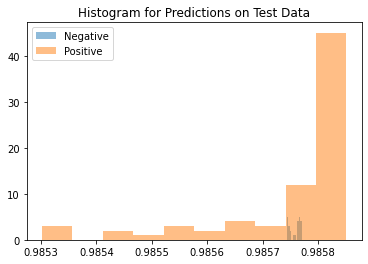

Average Difference between Positive and Negative Class: -8.821487426757812e-06


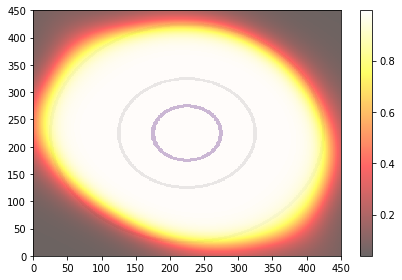

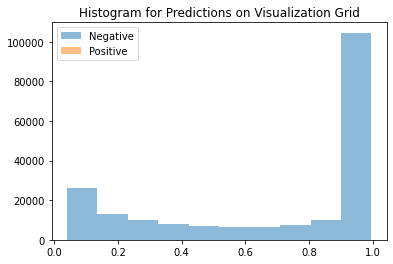

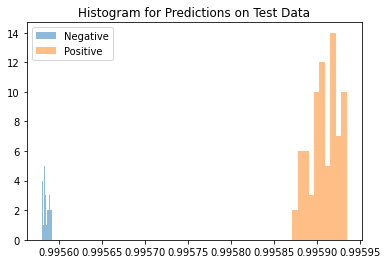

Average Difference between Positive and Negative Class: 0.0003224611282348633


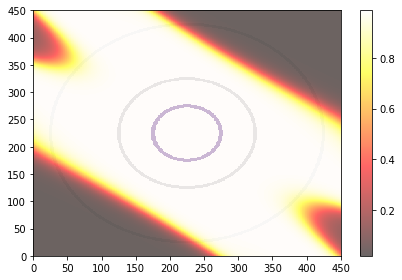

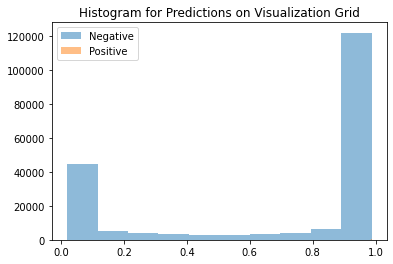

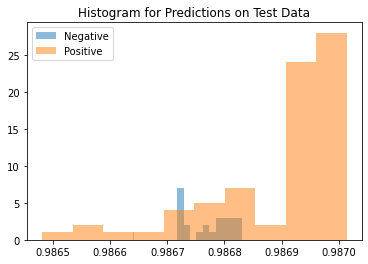

Average Difference between Positive and Negative Class: 0.00013196468353271484


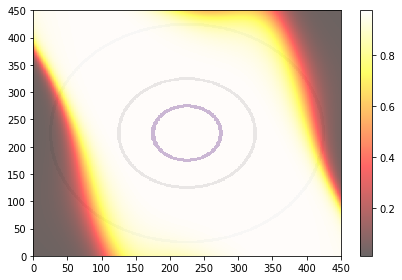

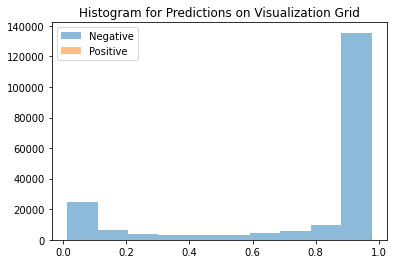

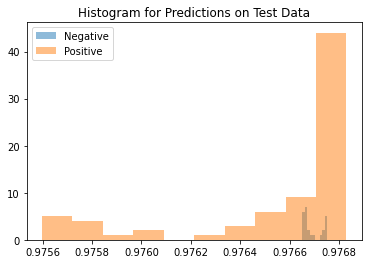

Average Difference between Positive and Negative Class: -0.00012969970703125


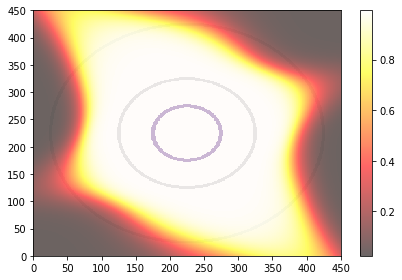

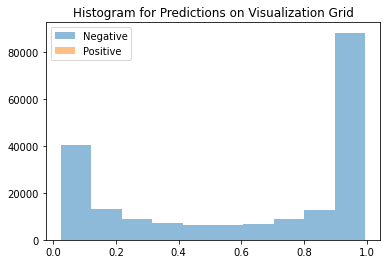

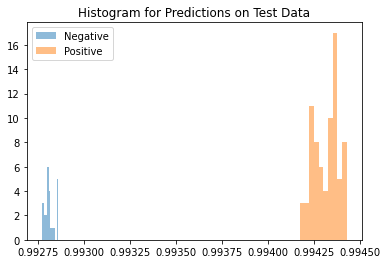

Average Difference between Positive and Negative Class: 0.001502692699432373


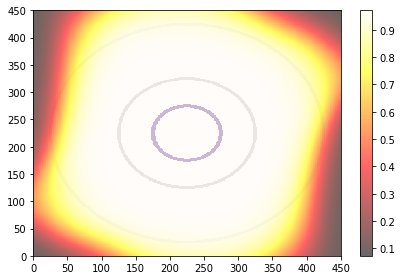

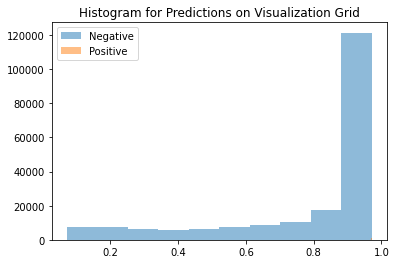

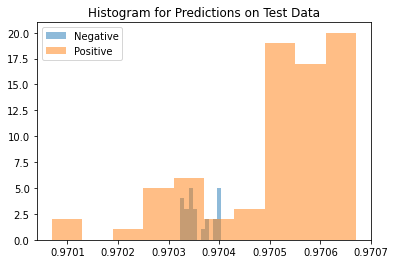

Average Difference between Positive and Negative Class: 0.00015413761138916016


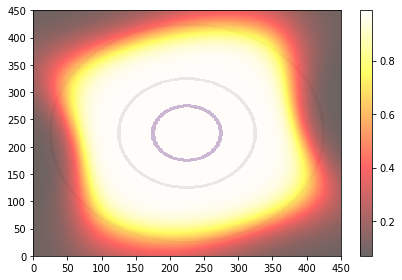

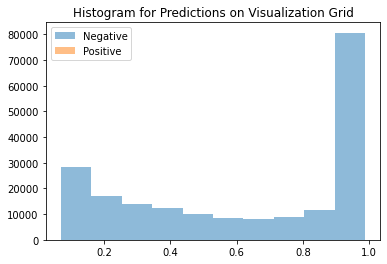

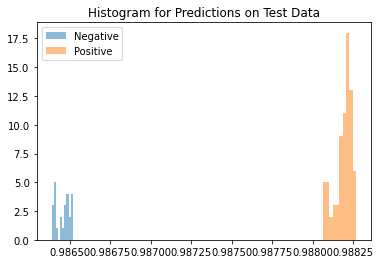

Average Difference between Positive and Negative Class: 0.0017313957214355469


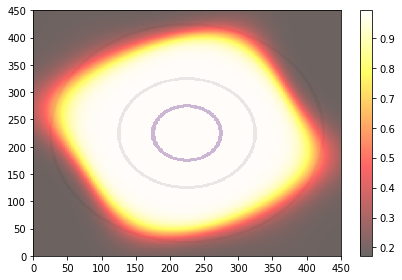

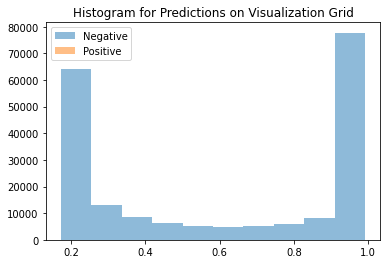

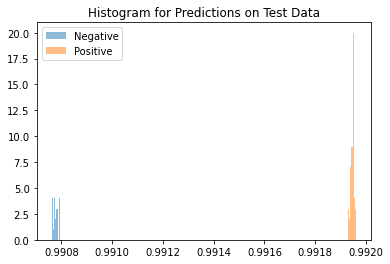

Average Difference between Positive and Negative Class: 0.0011693835258483887


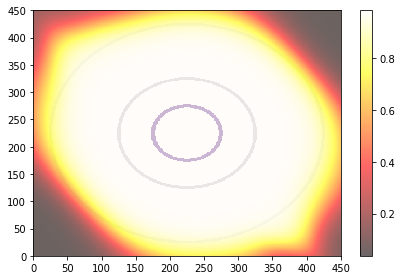

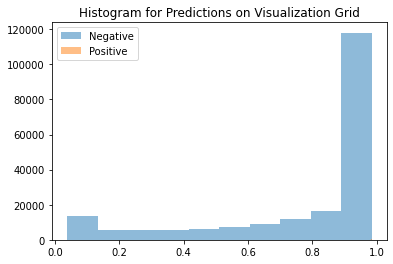

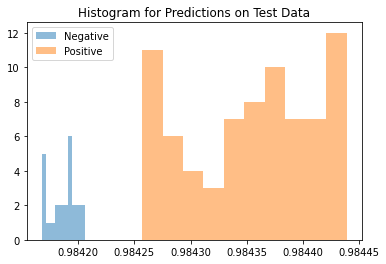

Average Difference between Positive and Negative Class: 0.00016748905181884766


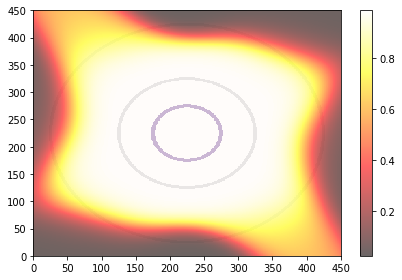

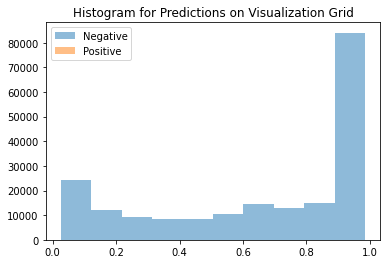

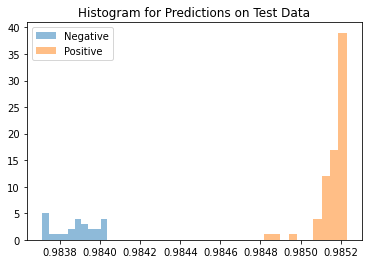

Average Difference between Positive and Negative Class: 0.001289665699005127


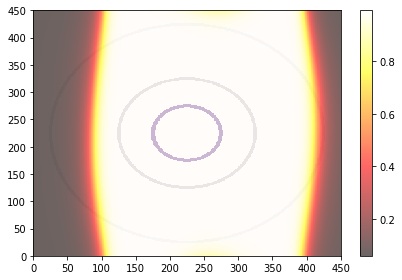

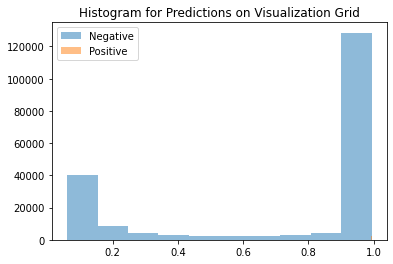

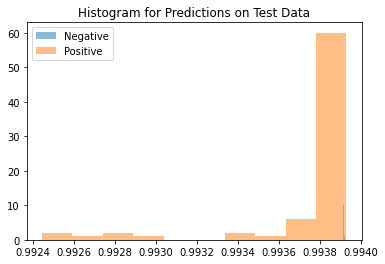

Average Difference between Positive and Negative Class: -0.0001652836799621582


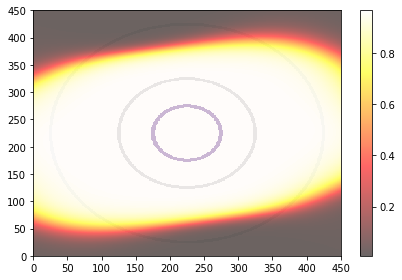

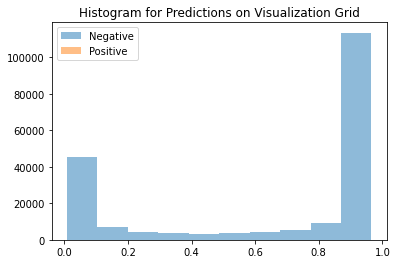

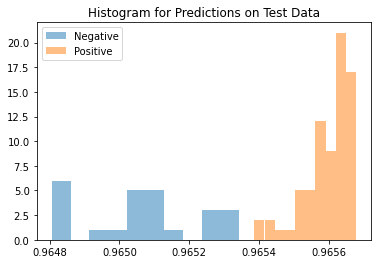

Average Difference between Positive and Negative Class: 0.0005347132682800293
AUPR (Train): 1.0+-1.2899625854847775e-16
AUPR (Test): 0.9230165236829588+-0.1391601293534863
Average Distance between Means: 0.0005629330989904702+-0.0007408613455481827


([1.0000000000000002,
  0.9999999999999998,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0000000000000002,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  1.0,
  1.0,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999998,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999],
 [0.9999999999999999,
  0.9999999999999998,
  0.6433268736955748,
  0.9999999999999999,
  0.5378421360491852,
  0.9999999999999999,
  0.9952414200525223,
  0.9644395847582194,
  0.9108419798190909,
  0.9999999999999999,
  0.9571136639666851,
  0.8643074465452768,
  0.9999999999999999,
  0.952277423163944,
  1.0,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.6349399456086781,
  1.0],
 [0.0026043653,
  0.000834465,
  -0.0003194213,
  0.00087320805,
  -3.5107136e-05,
  0.00039243698,
  0.000154078,
  5.453825e-05,
  -8.821487e-06,
  0.00032246113,
  0.00013196468,
  -0.0001296997,
  0.0015026927,
  0.00015413761,
  0.001

In [7]:
# HS3b
separation = "HS"
bumped = "b"
sigma = 0.5
hidden_layers = 3
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='binary_crossentropy',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

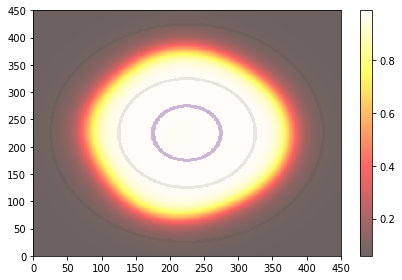

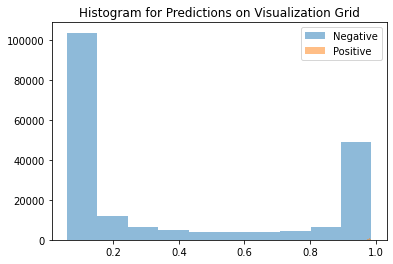

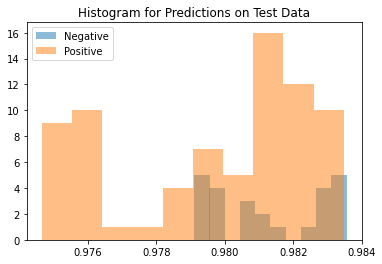

Average Difference between Positive and Negative Class: -0.0015997886657714844


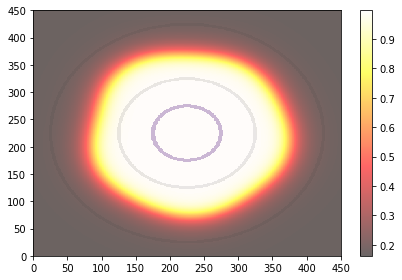

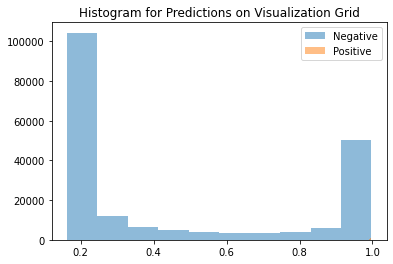

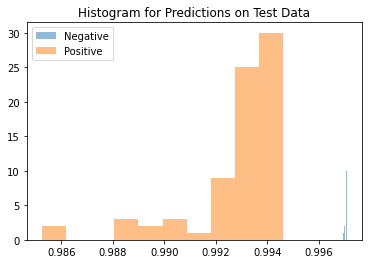

Average Difference between Positive and Negative Class: -0.004112124443054199


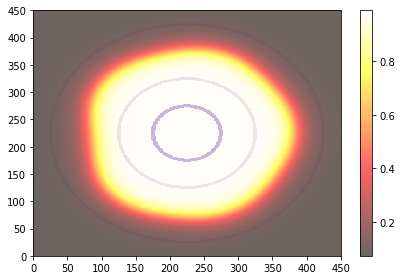

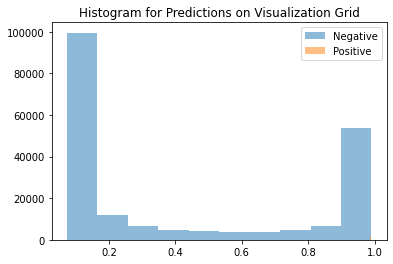

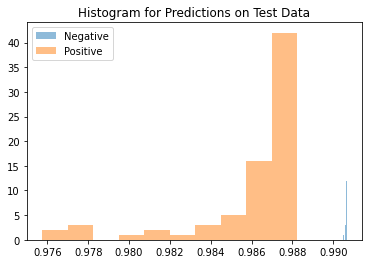

Average Difference between Positive and Negative Class: -0.004487574100494385


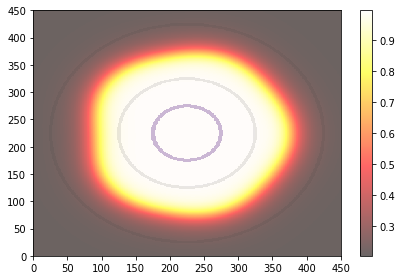

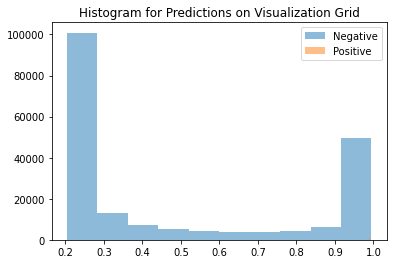

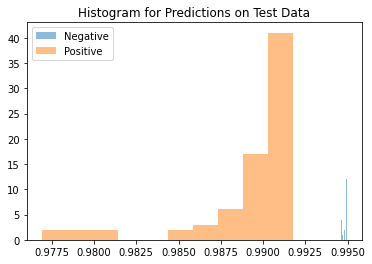

Average Difference between Positive and Negative Class: -0.005567669868469238


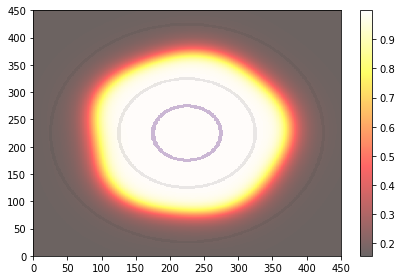

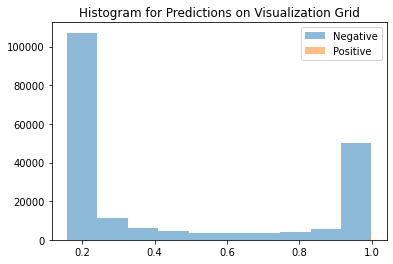

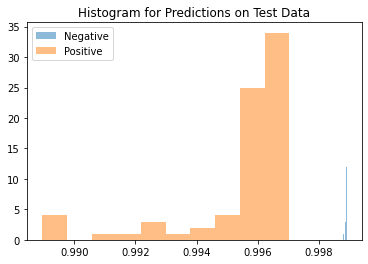

Average Difference between Positive and Negative Class: -0.0033632516860961914


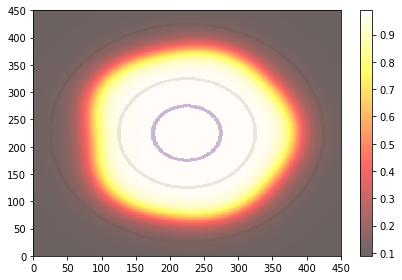

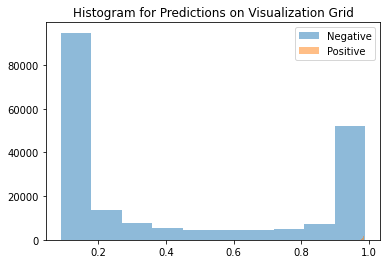

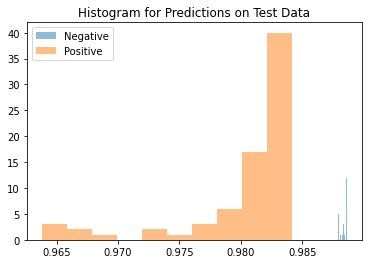

Average Difference between Positive and Negative Class: -0.0077933669090271


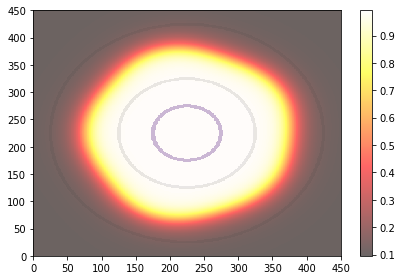

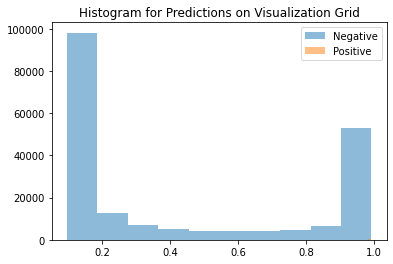

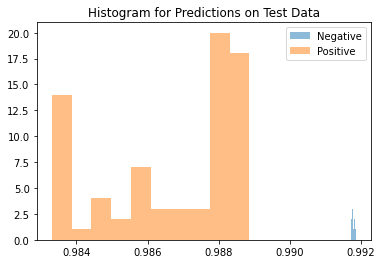

Average Difference between Positive and Negative Class: -0.005113184452056885


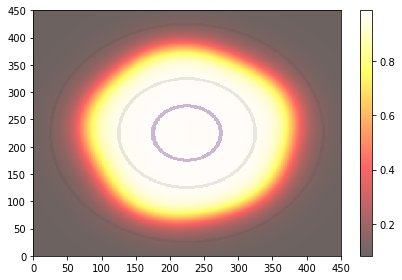

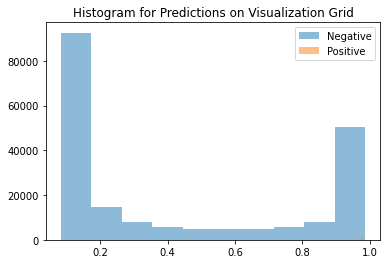

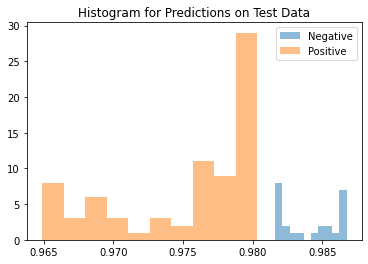

Average Difference between Positive and Negative Class: -0.008805394172668457


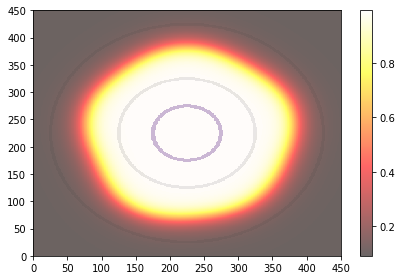

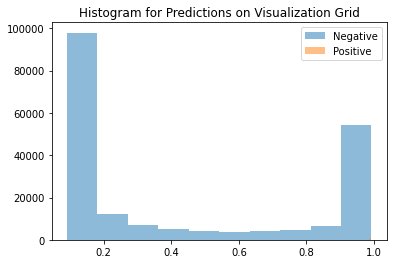

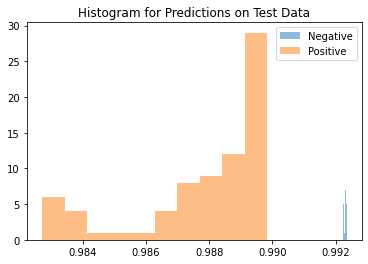

Average Difference between Positive and Negative Class: -0.004458367824554443


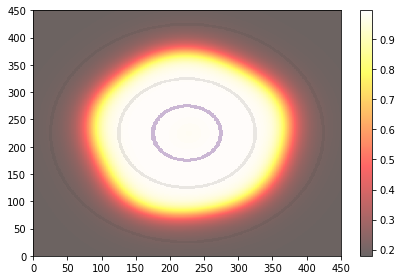

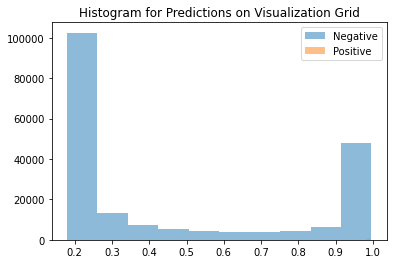

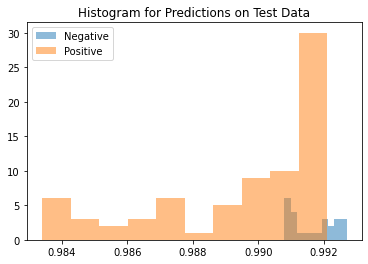

Average Difference between Positive and Negative Class: -0.0020614266395568848


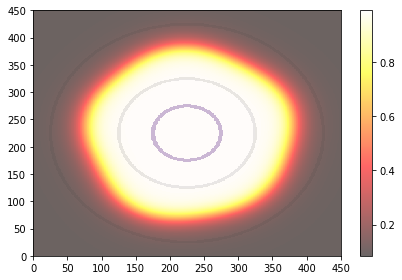

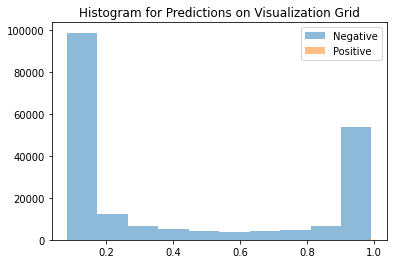

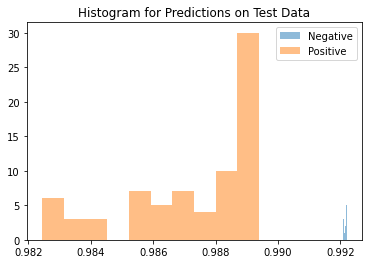

Average Difference between Positive and Negative Class: -0.0048673152923583984


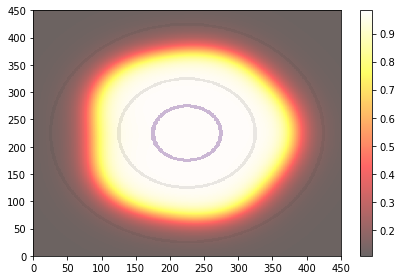

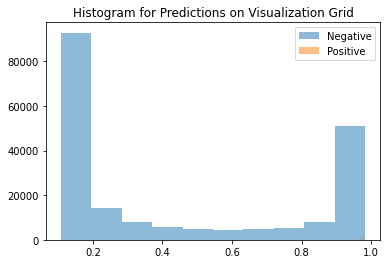

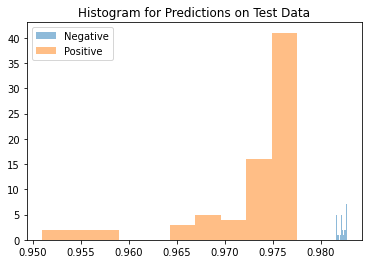

Average Difference between Positive and Negative Class: -0.009407877922058105


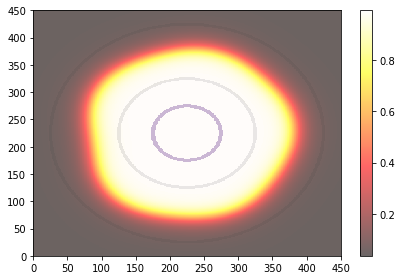

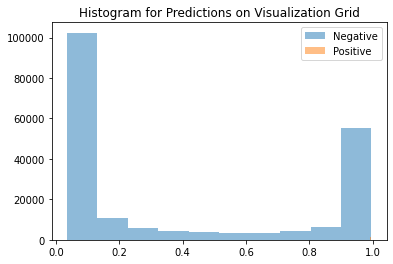

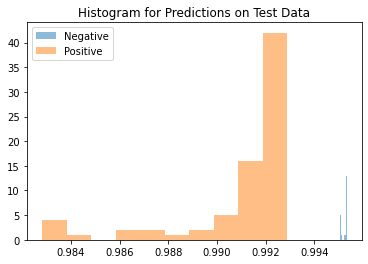

Average Difference between Positive and Negative Class: -0.004163384437561035


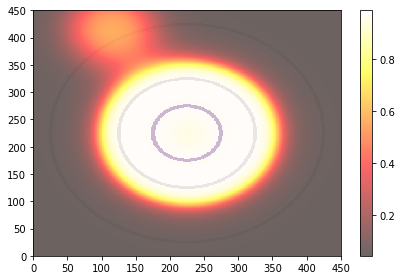

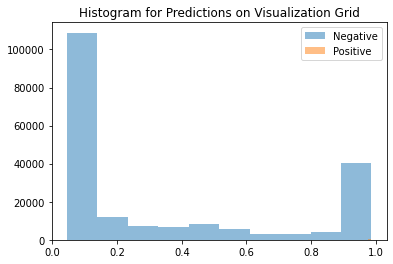

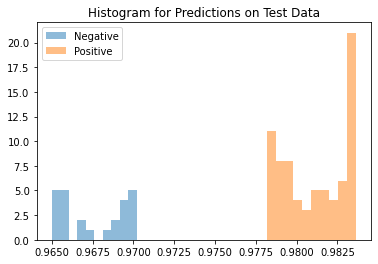

Average Difference between Positive and Negative Class: 0.013531088829040527


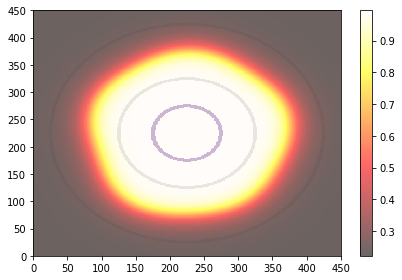

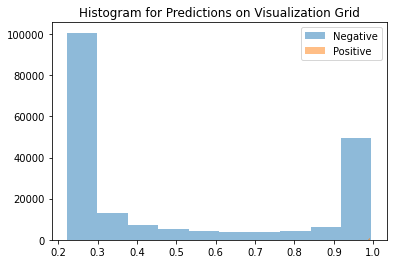

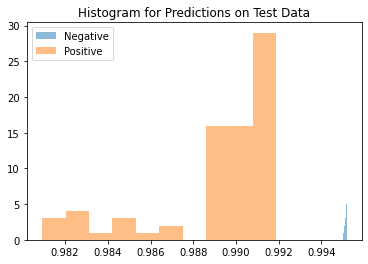

Average Difference between Positive and Negative Class: -0.005816936492919922


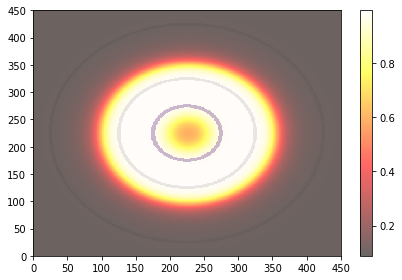

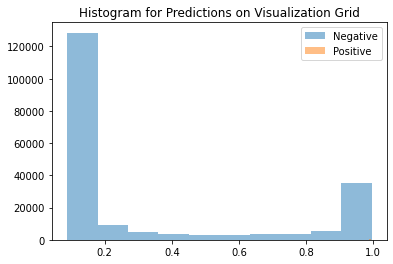

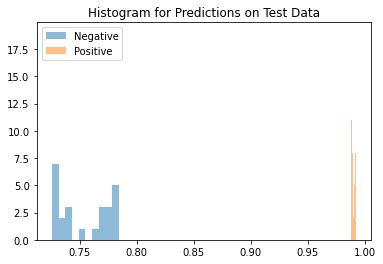

Average Difference between Positive and Negative Class: 0.23584884405136108


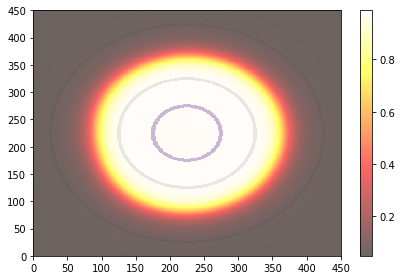

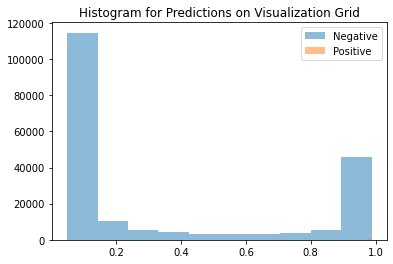

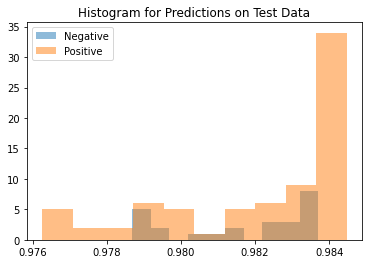

Average Difference between Positive and Negative Class: 0.0004813671112060547


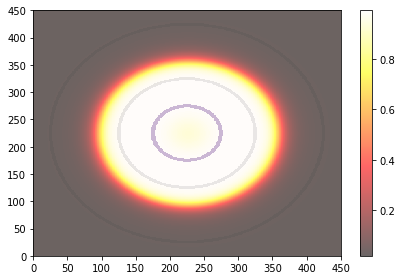

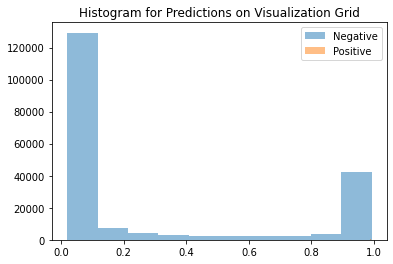

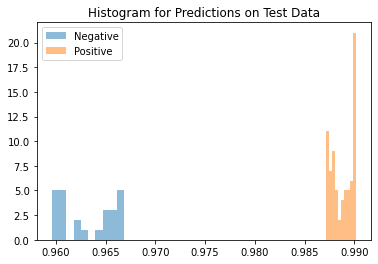

Average Difference between Positive and Negative Class: 0.02561366558074951


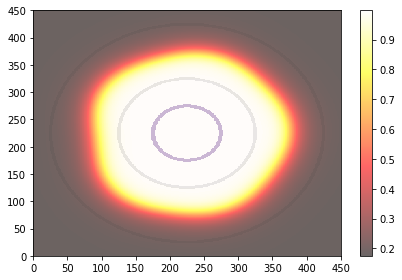

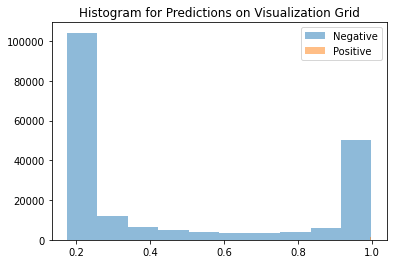

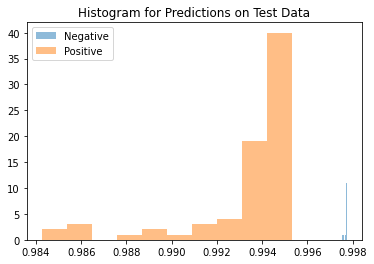

Average Difference between Positive and Negative Class: -0.004269421100616455


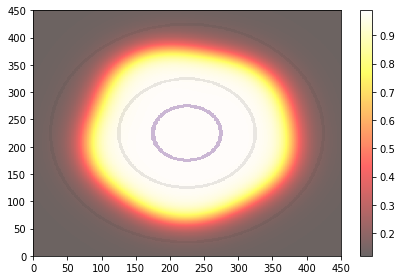

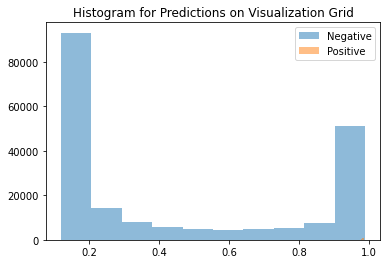

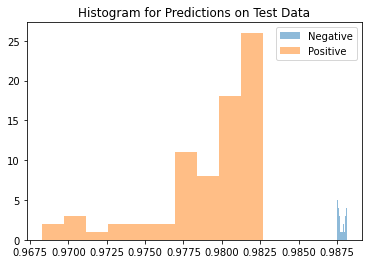

Average Difference between Positive and Negative Class: -0.008538424968719482
AUPR (Train): 1.0+-1.0235750533041807e-16
AUPR (Test): 0.6341396928863345+-0.17216475828988118
Average Distance between Means: 0.009552473202347755+-0.052518580108881


([0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999],
 [0.6605498454672234,
  0.5378602200379622,
  0.5378602200379622,
  0.5378602200379622,
  0.5378602200379622,
  0.5378602200379622,
  0.5378536345050609,
  0.5378602200379622,
  0.5378602200379622,
  0.6125065159119087,
  0.5378602200379622,
  0.5378602200379622,
  0.5378602200379622,
  0.9999999999999999,
  0.5378602200379622,
  0.9999999999999999,
  0.8797146849833655,
  0.9999999999999999,
  0.5378465364035889,
  0.5378602200379622],
 [-0.0015997887,
  -0.0041121244,
  -0.004487574,
  -0.00556767,
  -0.0033632517,
  -0.007793367,
  -0.0051131845,
  -0.008805394,
  -0.004458368,
  -0.0020614266,

In [8]:
# HS3r
separation = "HS"
bumped = "r"
sigma = 0.5
hidden_layers = 3
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='binary_crossentropy',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

## RBF Separation

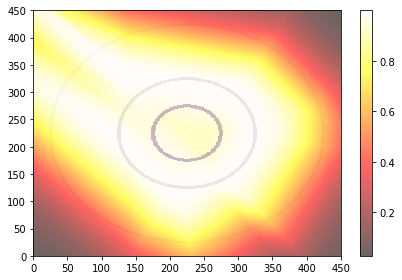

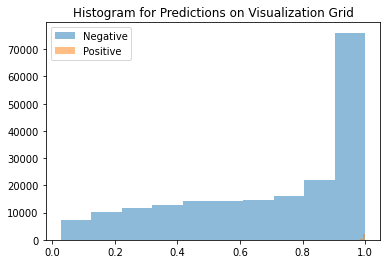

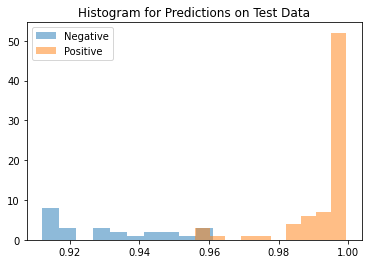

Average Difference between Positive and Negative Class: 0.06266778707504272


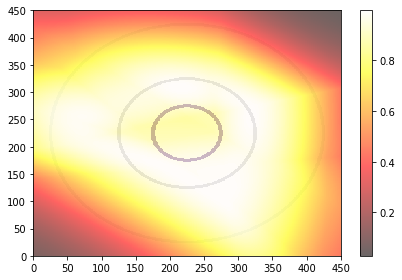

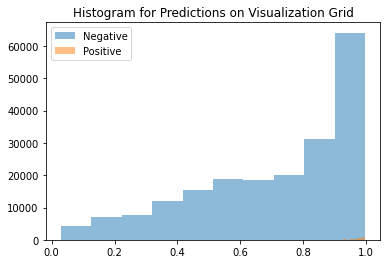

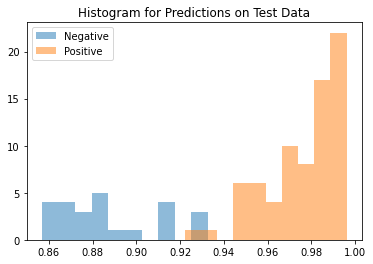

Average Difference between Positive and Negative Class: 0.08941936492919922


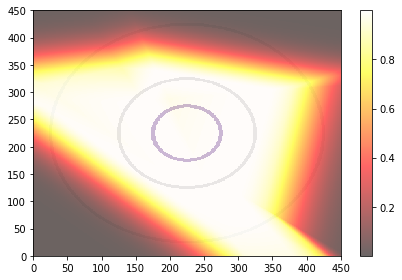

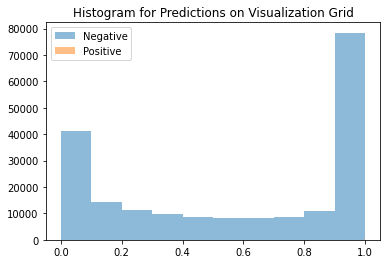

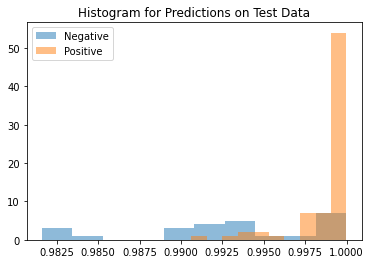

Average Difference between Positive and Negative Class: 0.005637824535369873


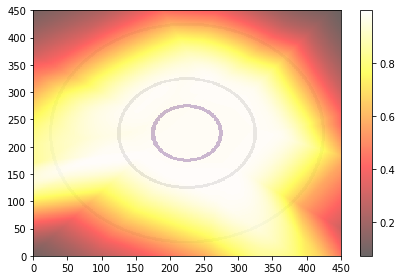

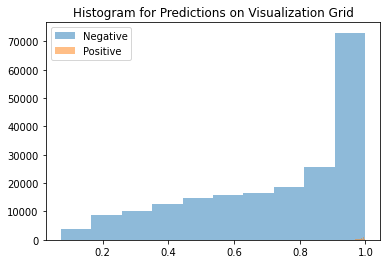

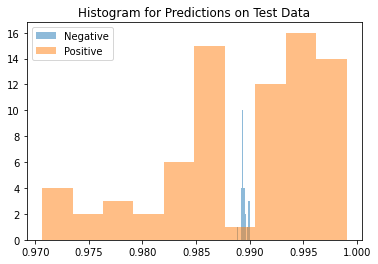

Average Difference between Positive and Negative Class: 3.933906555175781e-05


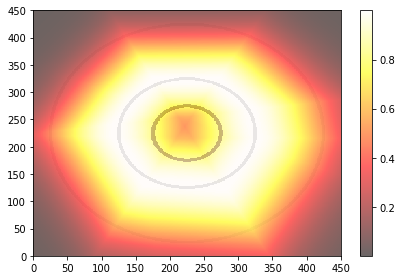

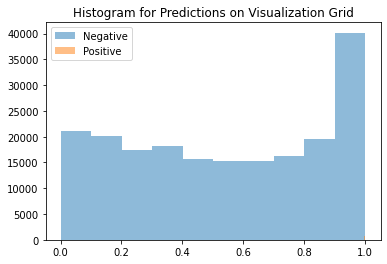

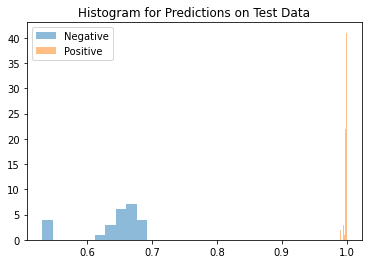

Average Difference between Positive and Negative Class: 0.35889530181884766


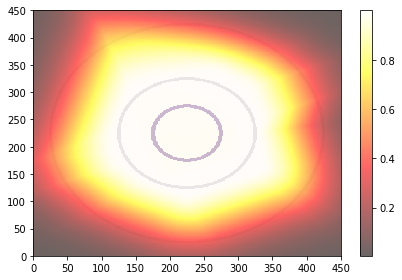

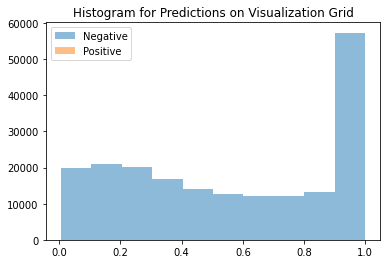

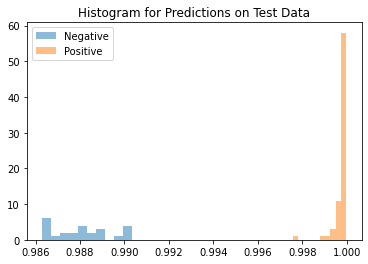

Average Difference between Positive and Negative Class: 0.011732041835784912


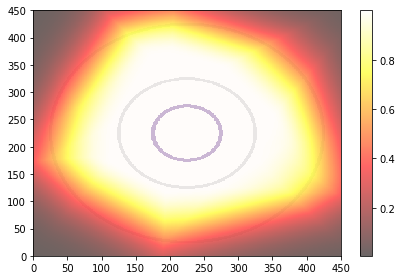

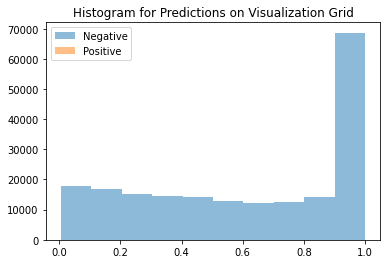

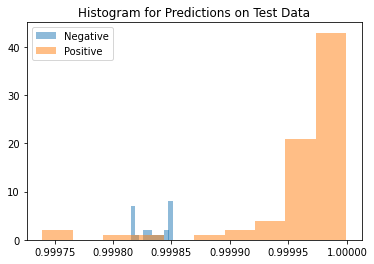

Average Difference between Positive and Negative Class: 0.0001291036605834961


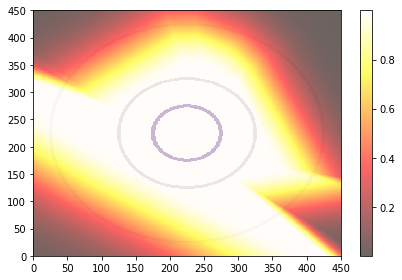

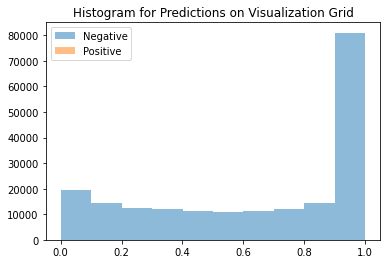

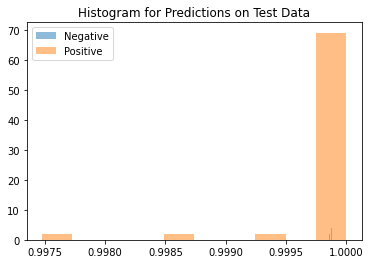

Average Difference between Positive and Negative Class: -3.6776065826416016e-05


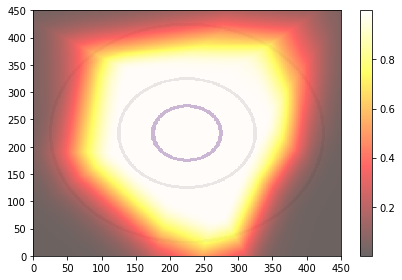

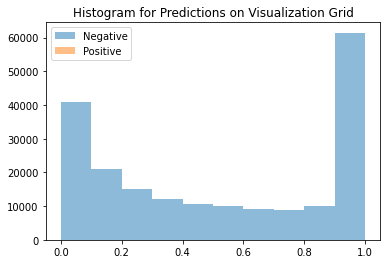

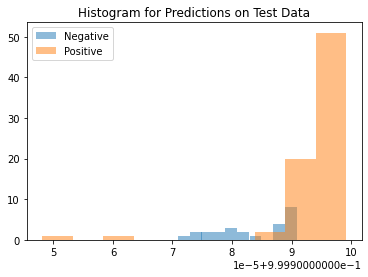

Average Difference between Positive and Negative Class: 1.0728836059570312e-05


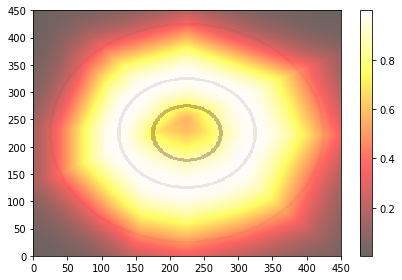

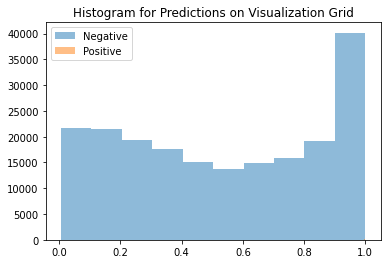

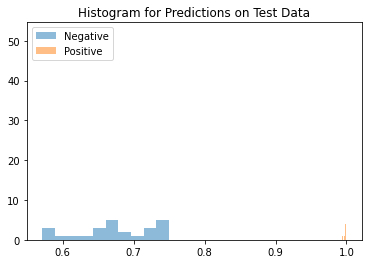

Average Difference between Positive and Negative Class: 0.32452648878097534


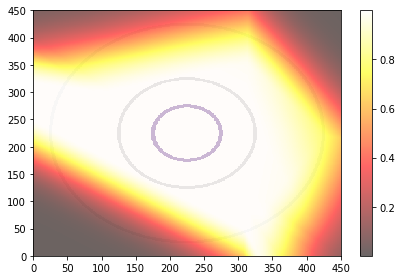

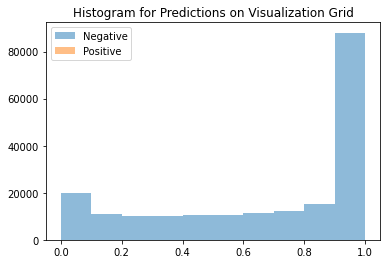

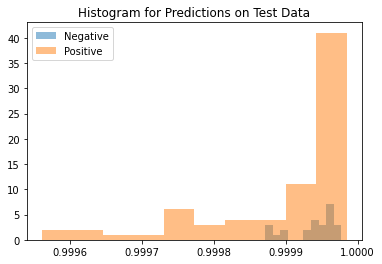

Average Difference between Positive and Negative Class: -4.112720489501953e-05


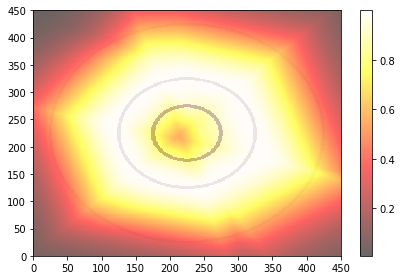

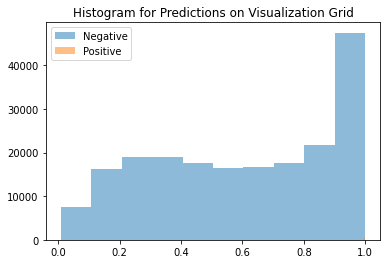

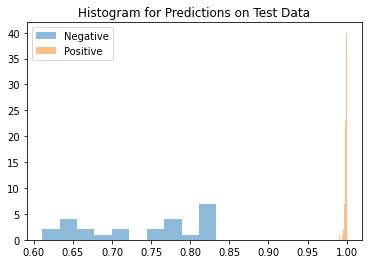

Average Difference between Positive and Negative Class: 0.25915247201919556


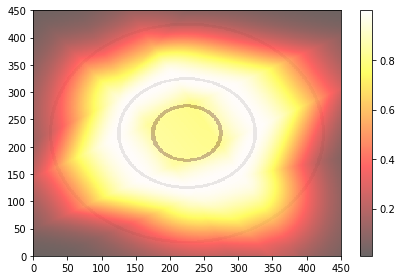

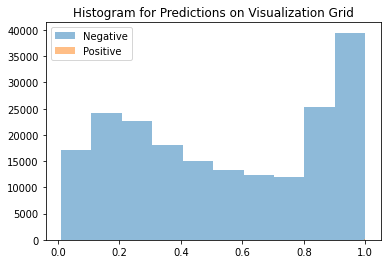

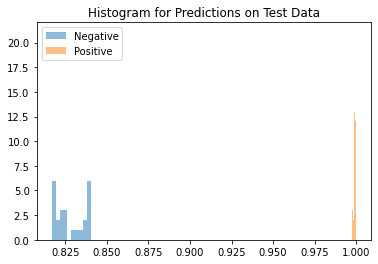

Average Difference between Positive and Negative Class: 0.17131143808364868


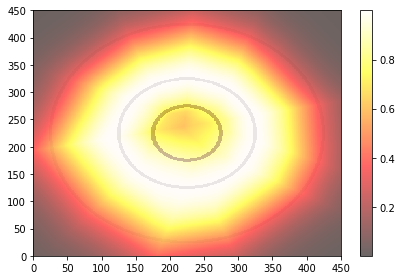

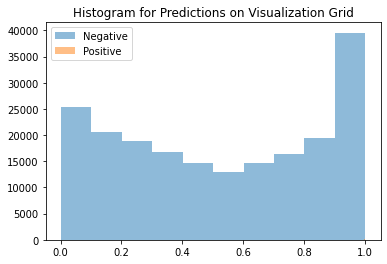

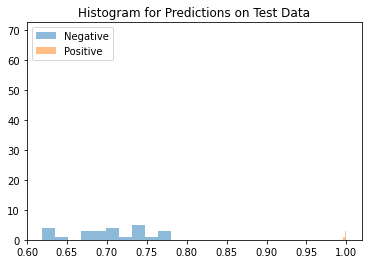

Average Difference between Positive and Negative Class: 0.2977808117866516


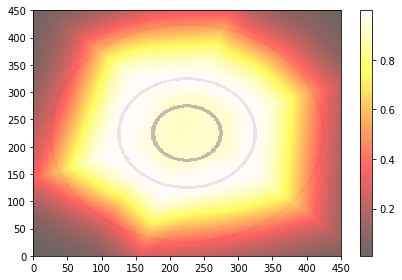

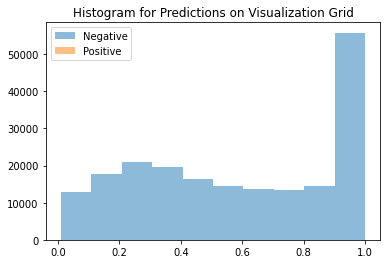

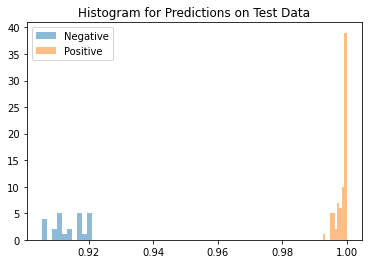

Average Difference between Positive and Negative Class: 0.08461350202560425


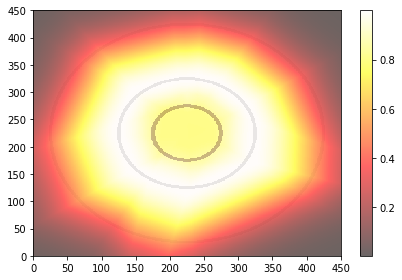

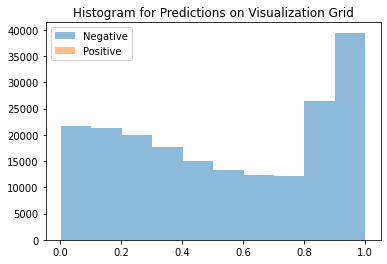

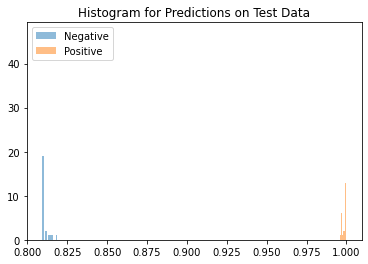

Average Difference between Positive and Negative Class: 0.1885583996772766


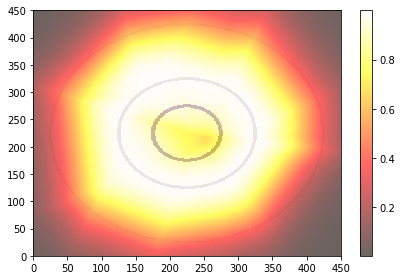

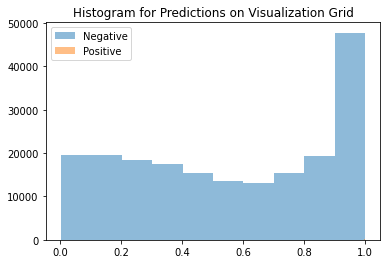

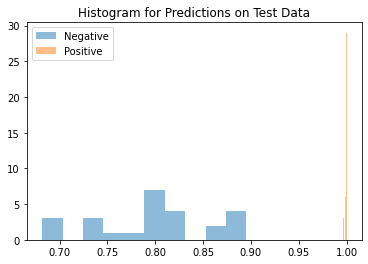

Average Difference between Positive and Negative Class: 0.20217353105545044


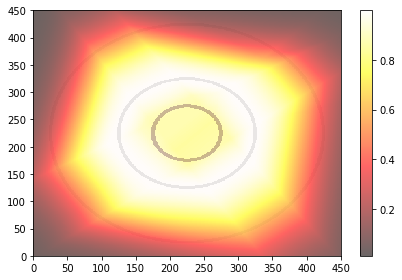

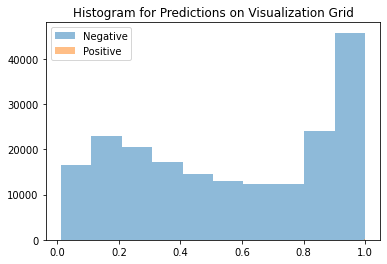

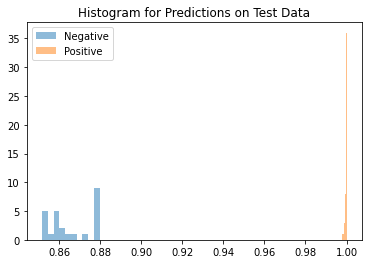

Average Difference between Positive and Negative Class: 0.13329672813415527


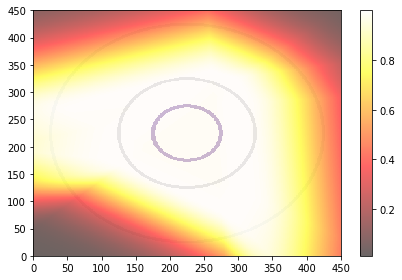

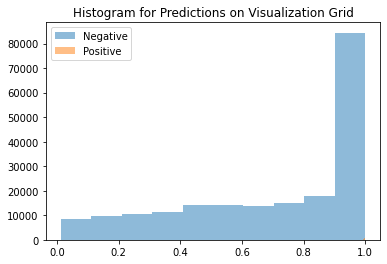

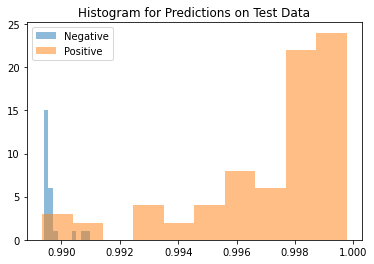

Average Difference between Positive and Negative Class: 0.0074506402015686035


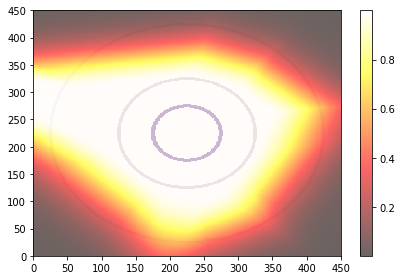

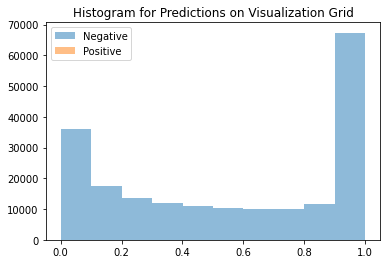

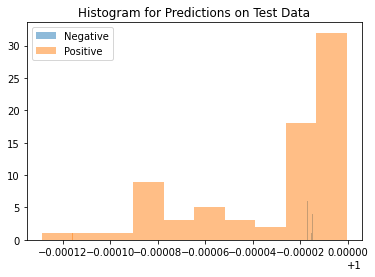

Average Difference between Positive and Negative Class: -1.4722347259521484e-05
AUPR (Train): 1.0+-8.95090418262362e-17
AUPR (Test): 0.9604960569944374+-0.07099338938477241
Average Distance between Means: 0.10986514389514923+-0.12070650607347488


([0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  1.0,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  1.0],
 [0.9986029933714142,
  0.9994838494838494,
  0.8040989322940876,
  0.8666303081786244,
  0.9999999999999999,
  1.0,
  0.9880689132840572,
  0.9458259566288281,
  0.9876844024242167,
  0.9999999999999999,
  0.7745188009635607,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9923729965508109,
  0.8526339867093018],
 [0.06266779,
  0.089419365,
  0.0056378245,
  3.9339066e-05,
  0.3588953,
  0.011732042,
  0.00012910366,
  -3.6776066e-05,
  1.0728836e-05,
  0.3245265,
  -4.1127205e-05,
  0.25915247,
  0.17131144,
  0.2977808,
  0.0846135,
  0.1885584,
  0.20217353,

In [9]:
# RBF3
separation = "RBF"
bumped = ""
sigma = 0.5
hidden_layers = 3
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='binary_crossentropy',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

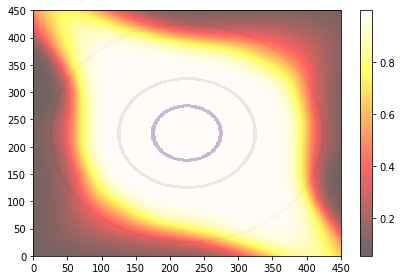

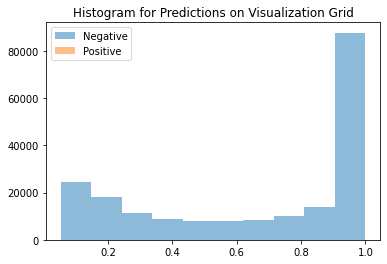

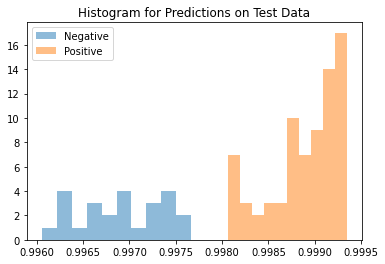

Average Difference between Positive and Negative Class: 0.001979529857635498


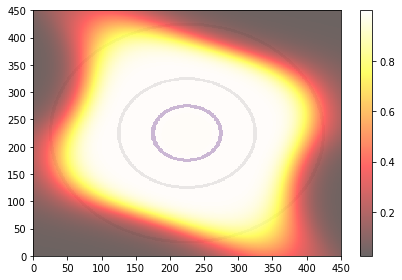

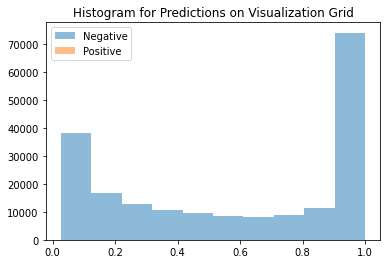

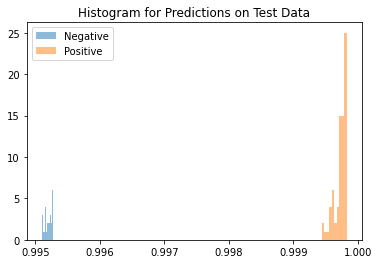

Average Difference between Positive and Negative Class: 0.004527151584625244


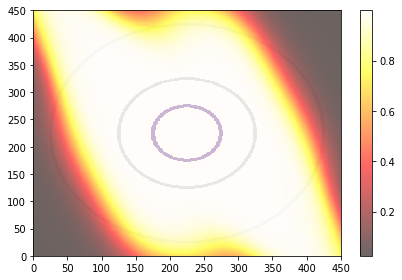

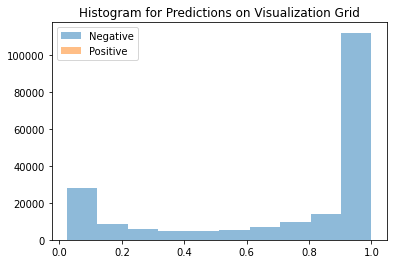

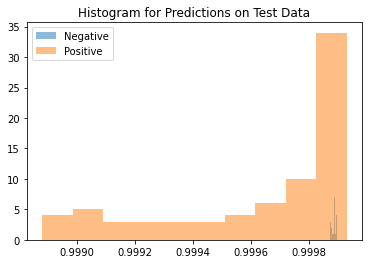

Average Difference between Positive and Negative Class: -0.0002466440200805664


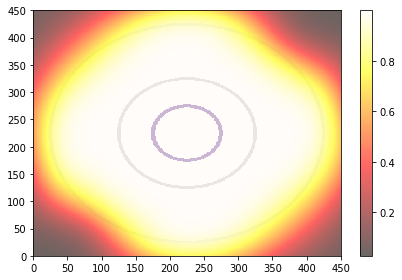

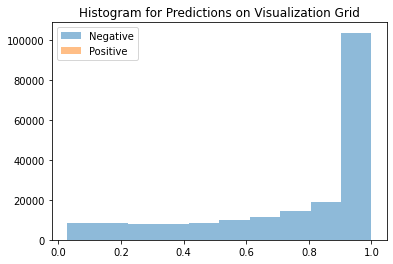

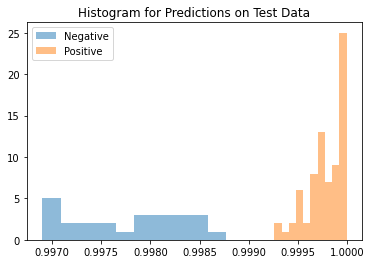

Average Difference between Positive and Negative Class: 0.0020401477813720703


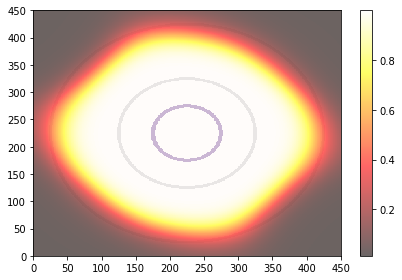

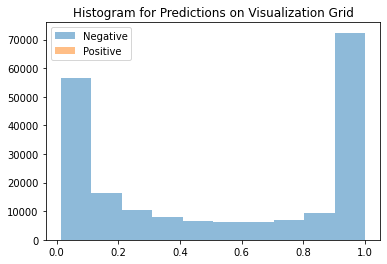

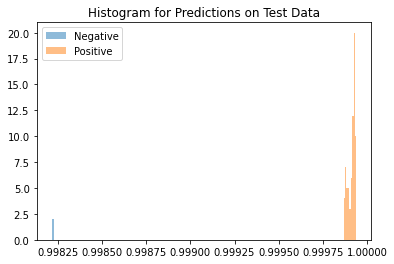

Average Difference between Positive and Negative Class: 0.001692652702331543


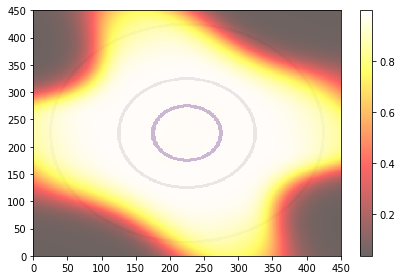

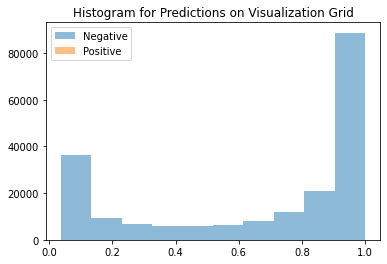

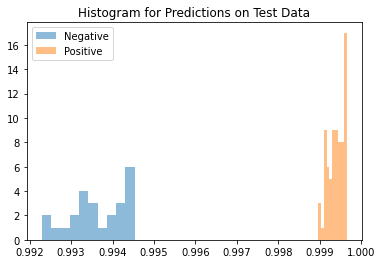

Average Difference between Positive and Negative Class: 0.005765736103057861


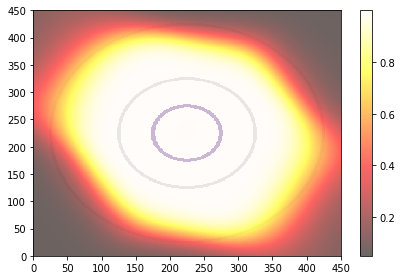

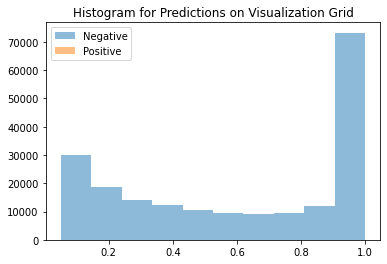

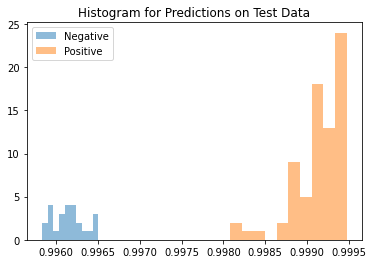

Average Difference between Positive and Negative Class: 0.0029825568199157715


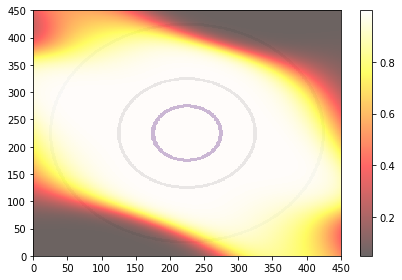

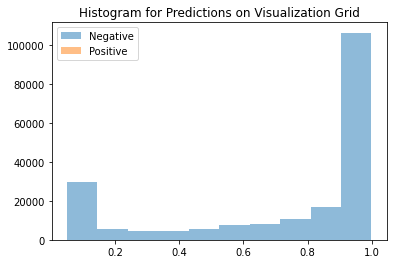

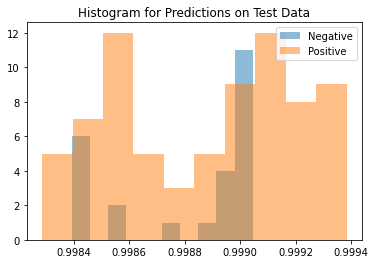

Average Difference between Positive and Negative Class: 5.8710575103759766e-05


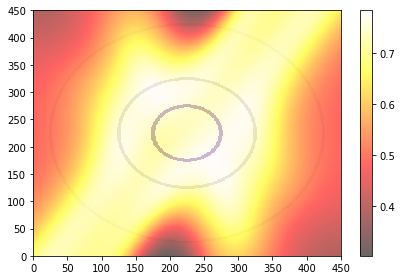

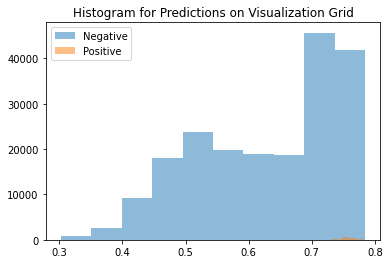

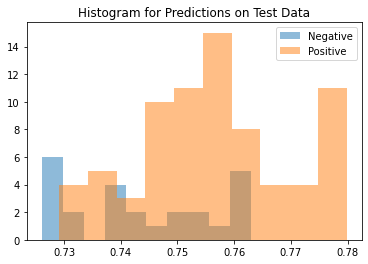

Average Difference between Positive and Negative Class: 0.012948095798492432


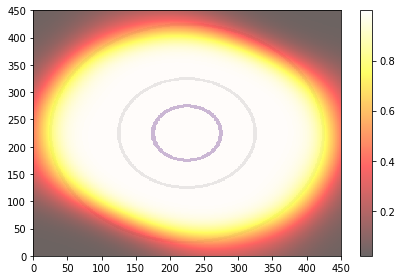

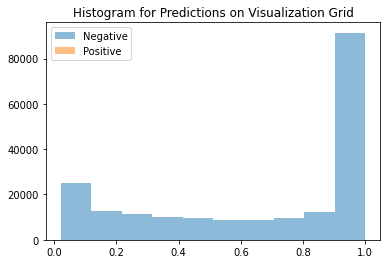

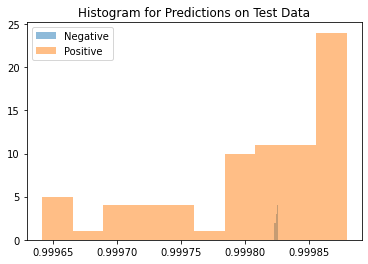

Average Difference between Positive and Negative Class: -1.7404556274414062e-05


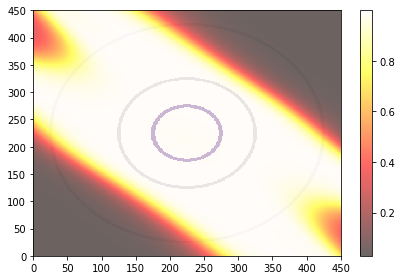

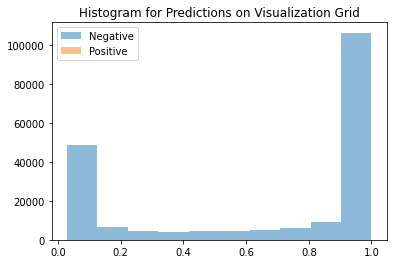

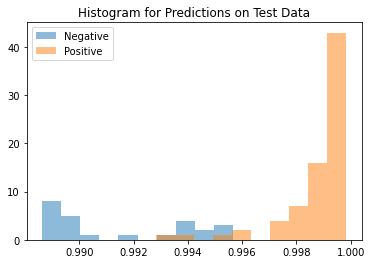

Average Difference between Positive and Negative Class: 0.007375597953796387


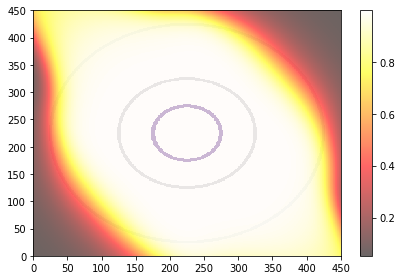

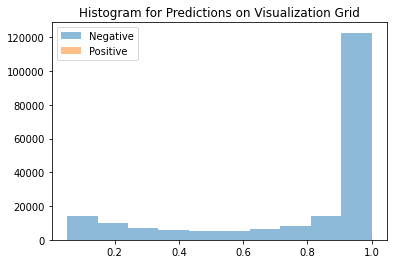

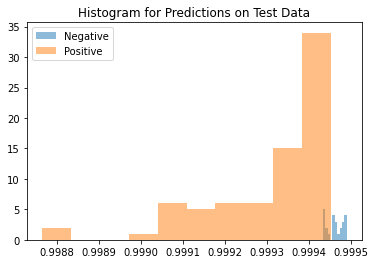

Average Difference between Positive and Negative Class: -0.00015419721603393555


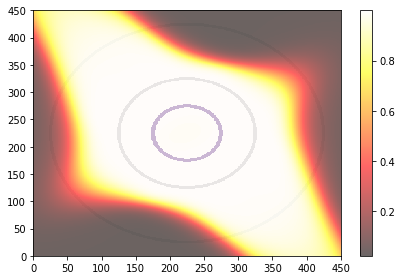

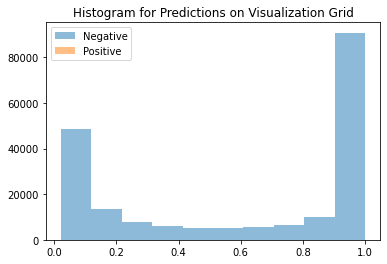

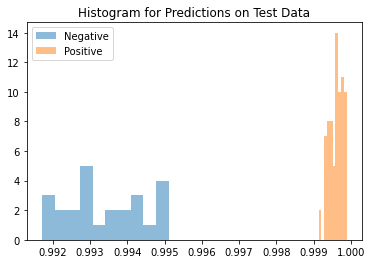

Average Difference between Positive and Negative Class: 0.006184279918670654


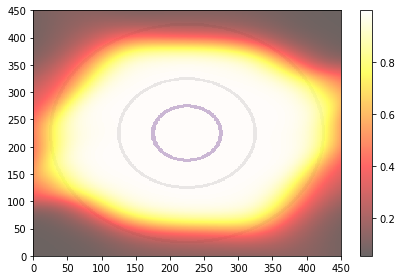

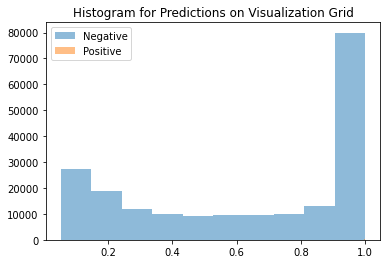

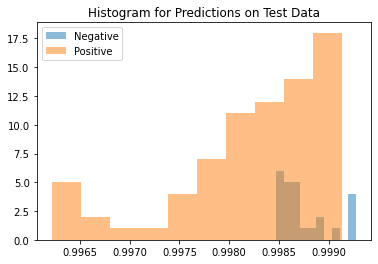

Average Difference between Positive and Negative Class: -0.0005208849906921387


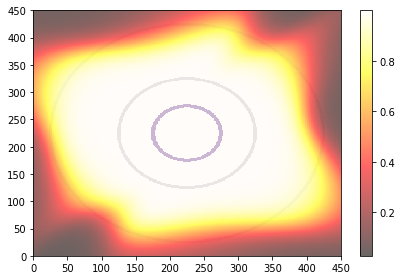

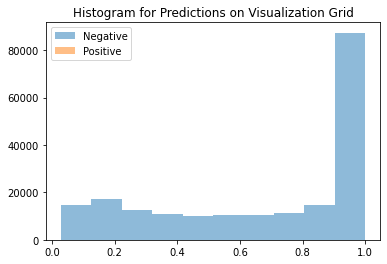

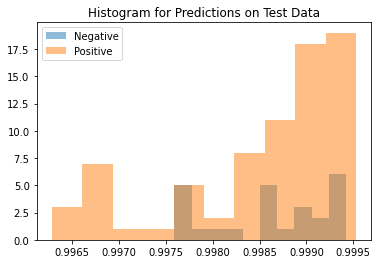

Average Difference between Positive and Negative Class: -8.082389831542969e-05


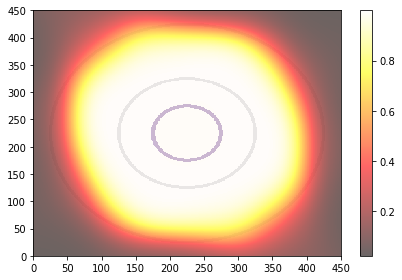

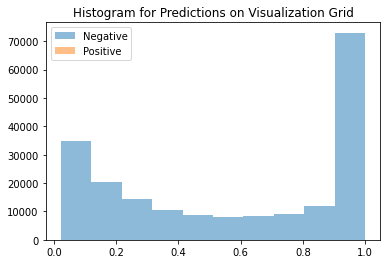

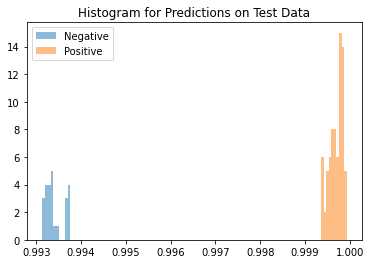

Average Difference between Positive and Negative Class: 0.006285965442657471


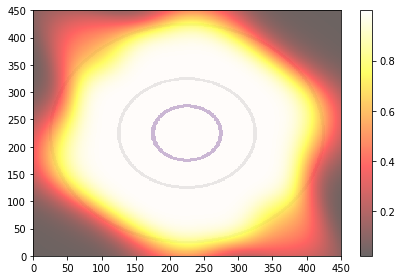

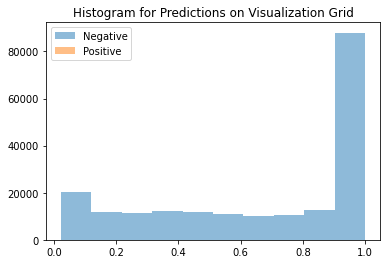

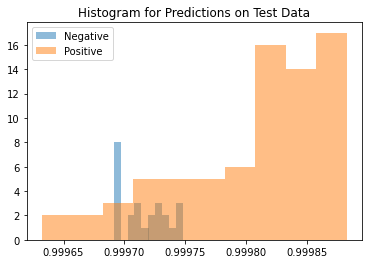

Average Difference between Positive and Negative Class: 9.018182754516602e-05


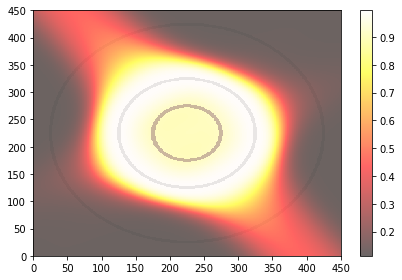

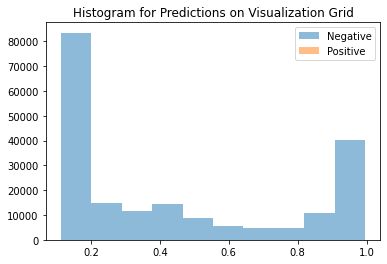

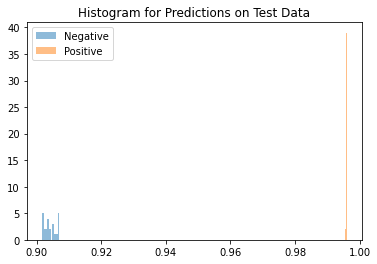

Average Difference between Positive and Negative Class: 0.09173721075057983


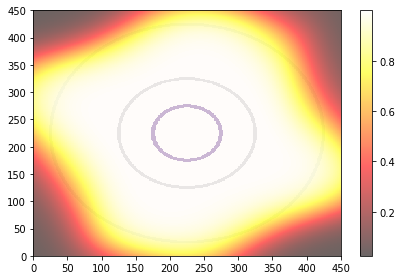

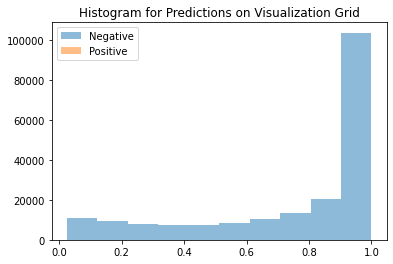

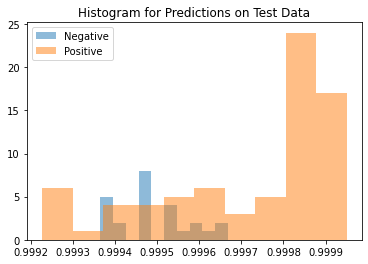

Average Difference between Positive and Negative Class: 0.00022339820861816406


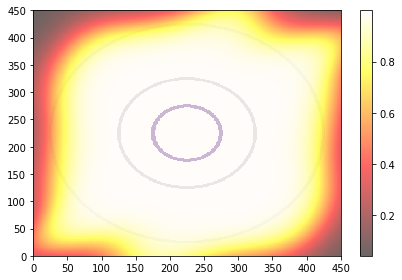

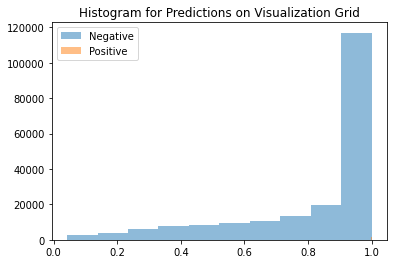

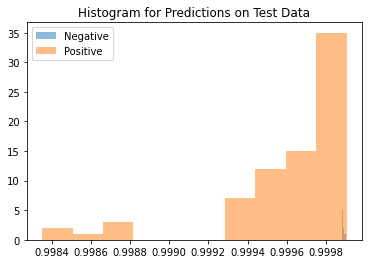

Average Difference between Positive and Negative Class: -0.0002631545066833496
AUPR (Train): 0.9999100887100527+-0.00039191422676361254
AUPR (Test): 0.8923687211229062+-0.1440576901299697
Average Distance between Means: 0.0071304053999483585+-0.019713887944817543


([0.9999999999999999,
  0.9999999999999999,
  1.0,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9982017742010542,
  1.0,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999998,
  0.9999999999999999,
  1.0],
 [0.9999999999999999,
  1.0,
  0.7733660065572693,
  1.0000000000000002,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.8525944421054242,
  0.8911491164536571,
  0.8564018979194855,
  0.9965833682013986,
  0.5400325088000815,
  1.0,
  0.6462374286255225,
  0.7546893366924999,
  0.9999999999999999,
  0.9670013158431174,
  1.0,
  0.9434721119813161,
  0.6258468892783533],
 [0.0019795299,
  0.0045271516,
  -0.00024664402,
  0.0020401478,
  0.0016926527,
  0.005765736,
  0.0029825568,
  5.8710575e-05,
  0.012948096,
  -1.7404556e-05,
  0.007375598,
  -0.00015419722,
  0.00618428,
  -0.000520885,
  -8.08239e-05,
  0.0062859

In [10]:
# RBF3b w BCE
separation = "RBF"
bumped = "b"
sigma = 0.5
hidden_layers = 3
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='binary_crossentropy',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

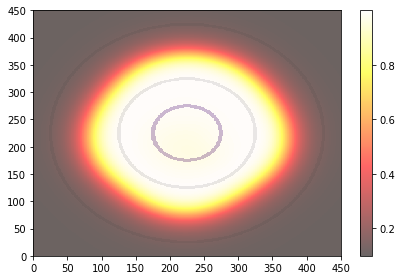

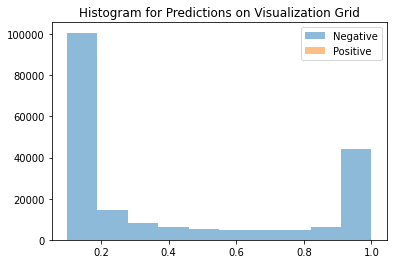

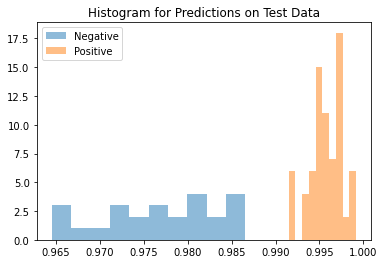

Average Difference between Positive and Negative Class: 0.018731772899627686


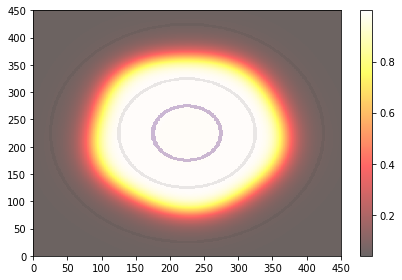

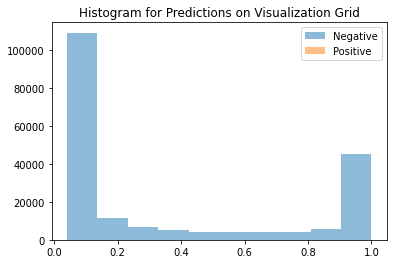

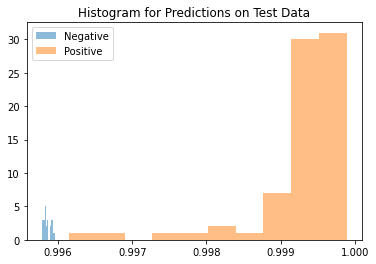

Average Difference between Positive and Negative Class: 0.0034522414207458496


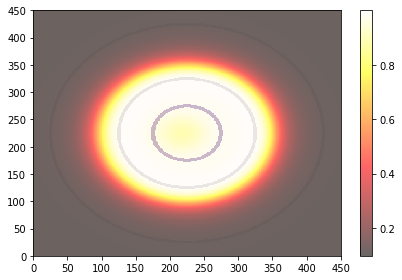

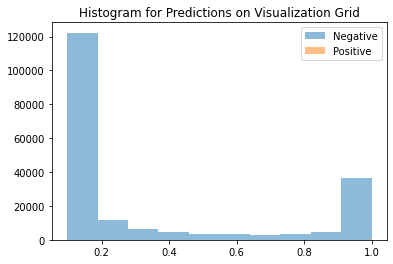

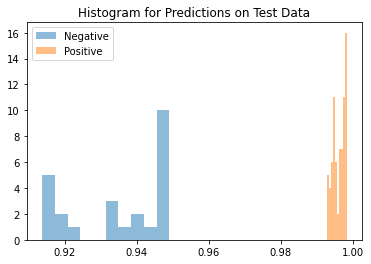

Average Difference between Positive and Negative Class: 0.06136280298233032


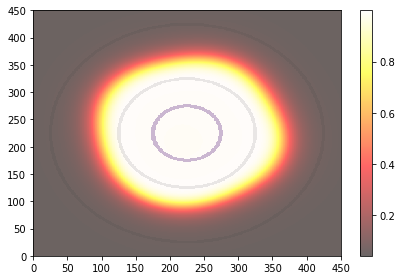

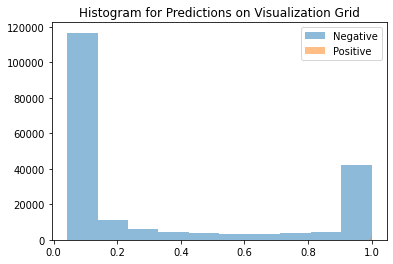

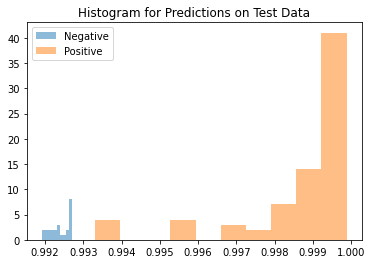

Average Difference between Positive and Negative Class: 0.006301760673522949


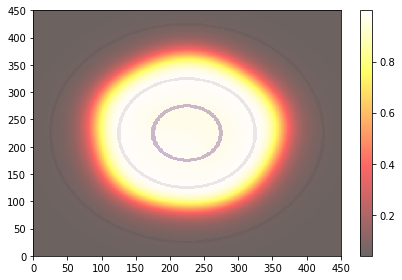

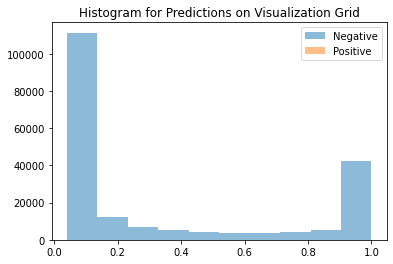

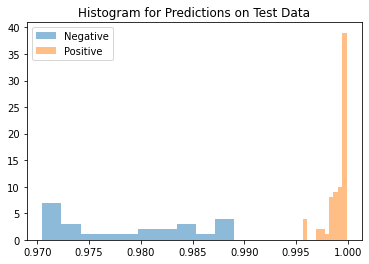

Average Difference between Positive and Negative Class: 0.020465433597564697


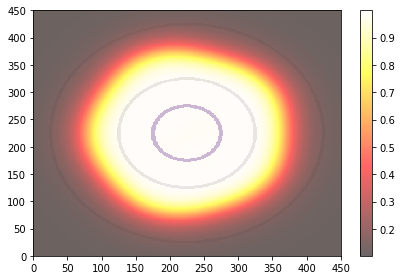

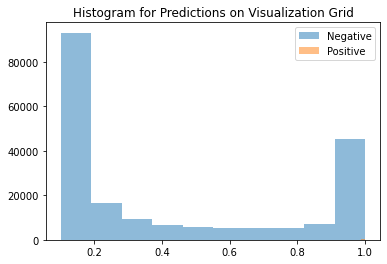

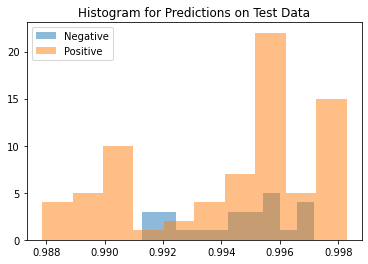

Average Difference between Positive and Negative Class: -0.00017493963241577148


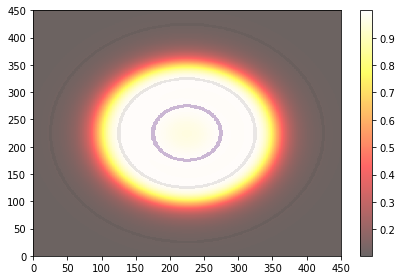

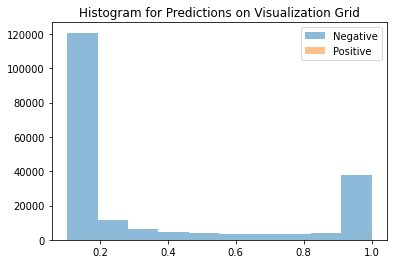

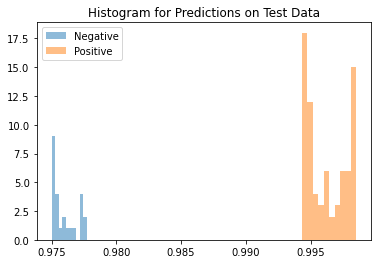

Average Difference between Positive and Negative Class: 0.020289897918701172


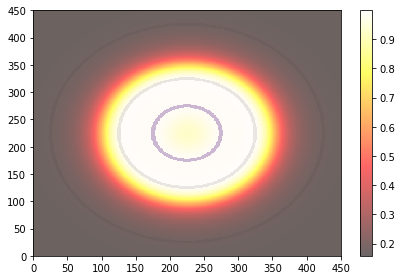

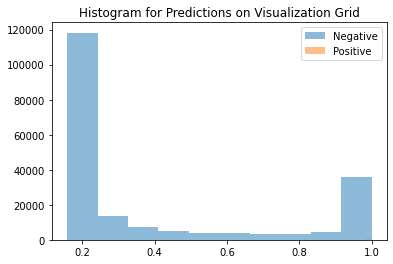

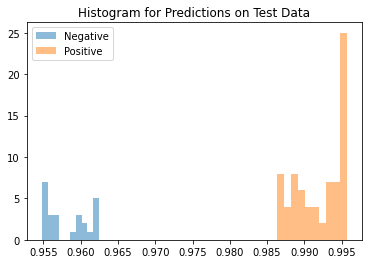

Average Difference between Positive and Negative Class: 0.03387564420700073


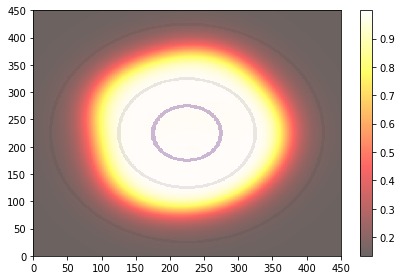

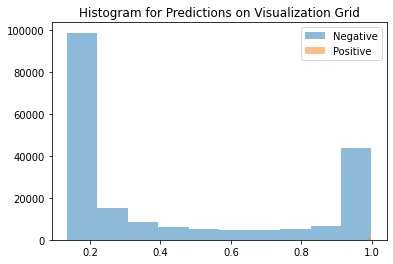

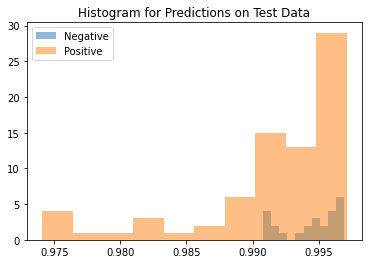

Average Difference between Positive and Negative Class: -0.0027527213096618652


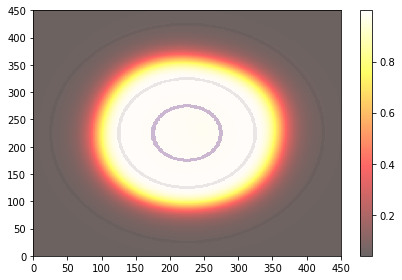

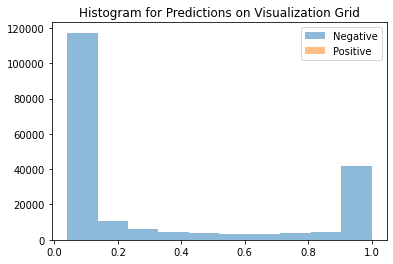

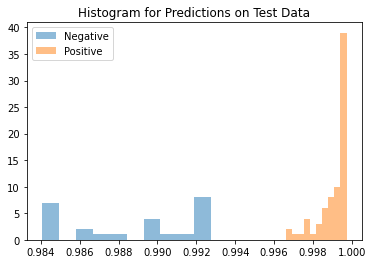

Average Difference between Positive and Negative Class: 0.010264098644256592


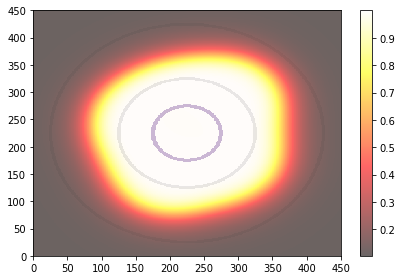

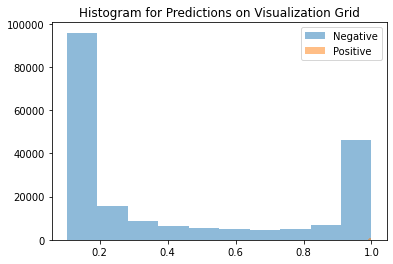

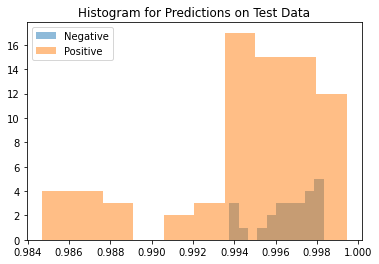

Average Difference between Positive and Negative Class: -0.002014458179473877


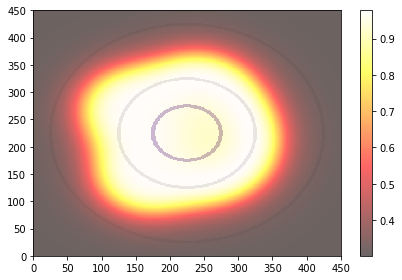

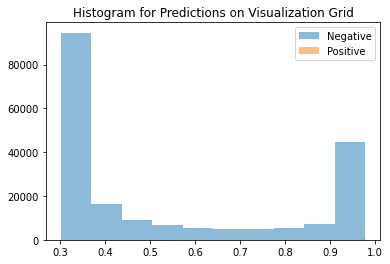

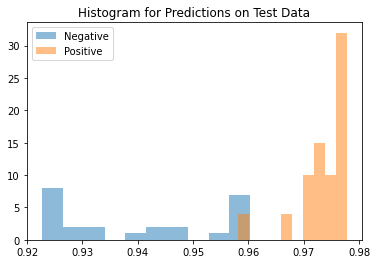

Average Difference between Positive and Negative Class: 0.033145785331726074


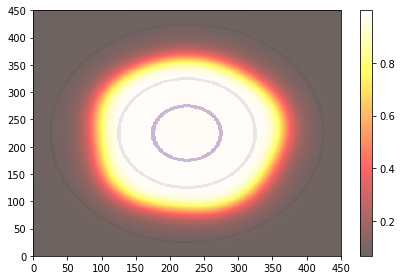

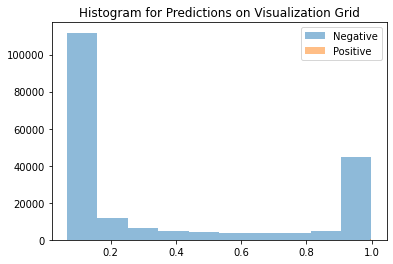

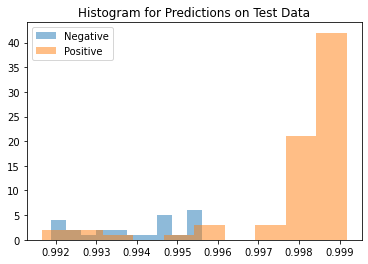

Average Difference between Positive and Negative Class: 0.0040413737297058105


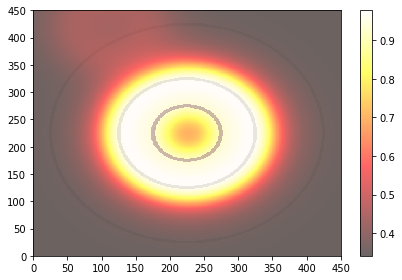

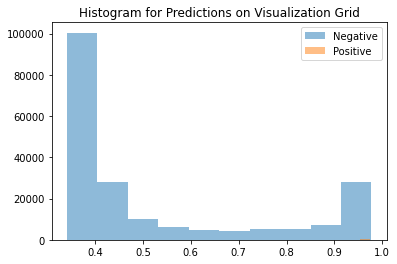

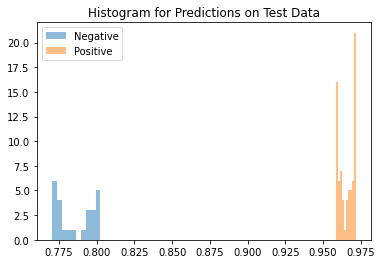

Average Difference between Positive and Negative Class: 0.1799781322479248


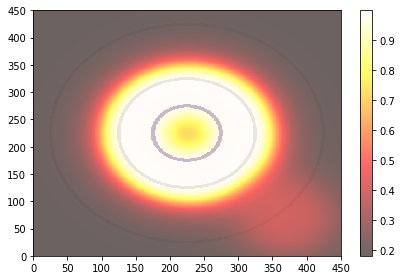

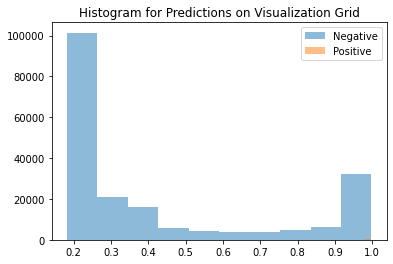

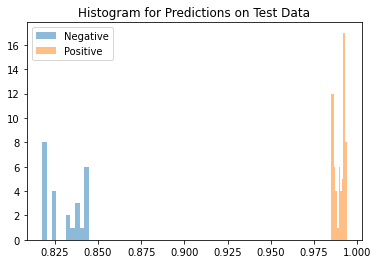

Average Difference between Positive and Negative Class: 0.1586010456085205


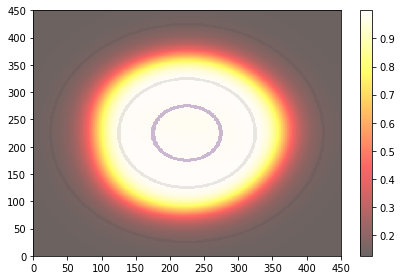

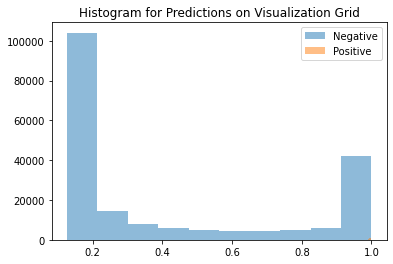

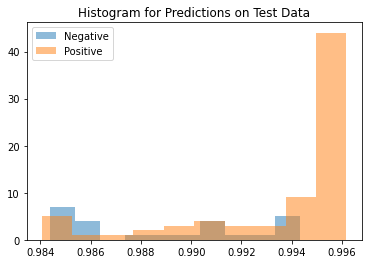

Average Difference between Positive and Negative Class: 0.004731297492980957


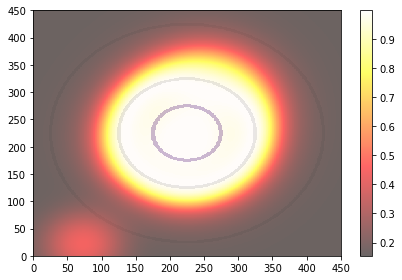

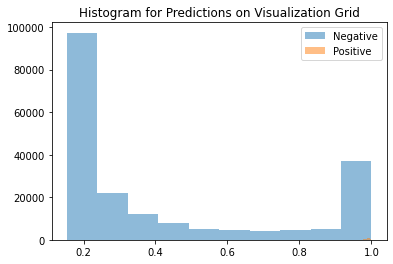

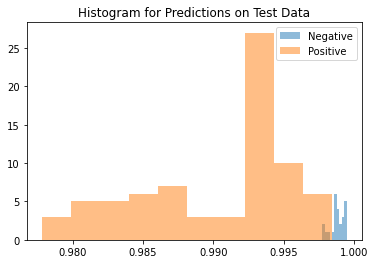

Average Difference between Positive and Negative Class: -0.008506417274475098


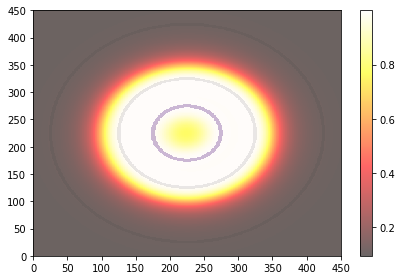

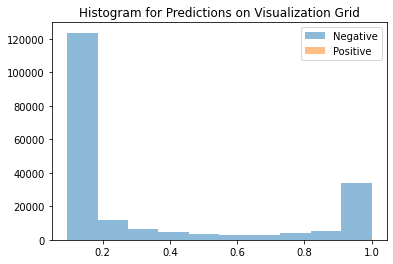

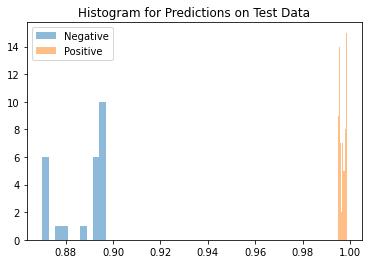

Average Difference between Positive and Negative Class: 0.10947948694229126


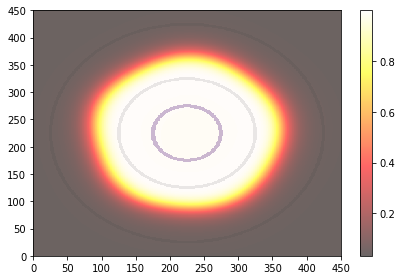

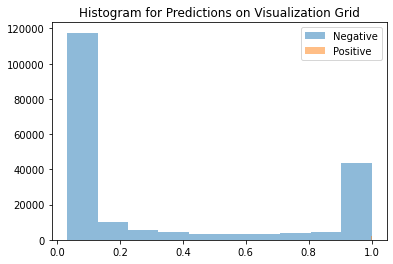

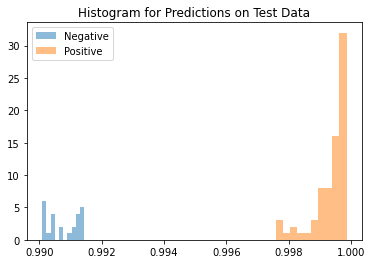

Average Difference between Positive and Negative Class: 0.008588910102844238


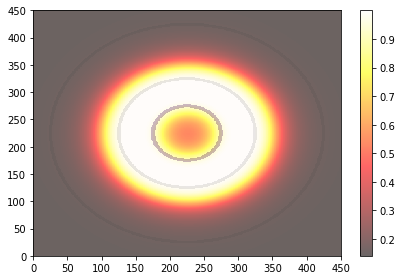

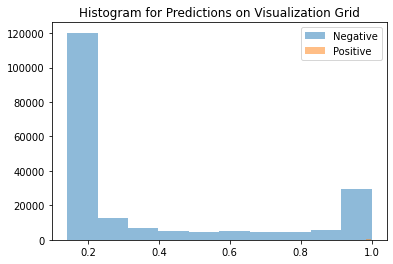

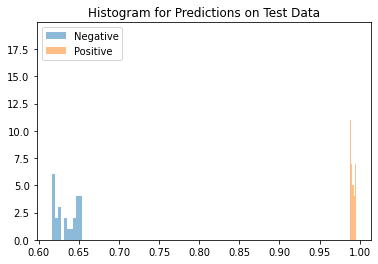

Average Difference between Positive and Negative Class: 0.35775643587112427
AUPR (Train): 1.0+-9.614813431917819e-17
AUPR (Test): 0.936246864800262+-0.12793710064621674
Average Distance between Means: 0.050880879163742065+-0.0875474289059639


([0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999],
 [0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.8110746896306404,
  0.9999999999999999,
  0.9999999999999999,
  0.7198430663658307,
  0.9999999999999999,
  0.7189497226725541,
  0.996745417440654,
  0.9845926711115114,
  0.9999999999999999,
  0.9999999999999999,
  0.9555229770586275,
  0.5382087517254244,
  0.9999999999999999,
  1.0,
  0.9999999999999999],
 [0.018731773,
  0.0034522414,
  0.061362803,
  0.0063017607,
  0.020465434,
  -0.00017493963,
  0.020289898,
  0.033875644,
  -0.0027527213,
  0.010264099,
  -0.0020144582,
  0.033145785,
  0.0040413737,
  0.

In [11]:
# RBF3r with bce
separation = "RBF"
bumped = "r"
sigma = 0.5
hidden_layers = 3
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='binary_crossentropy',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

## Equality Separation

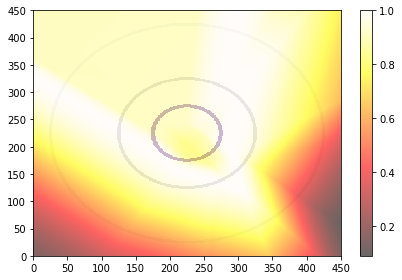

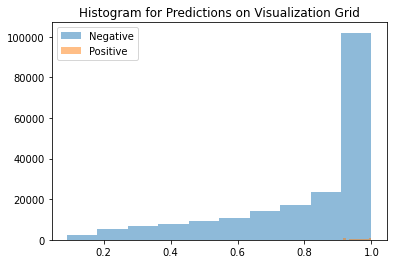

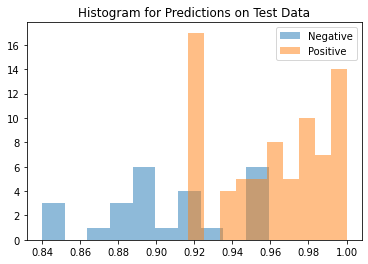

Average Difference between Positive and Negative Class: 0.054344356060028076


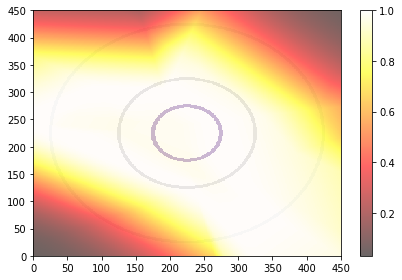

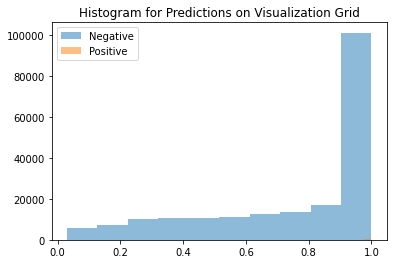

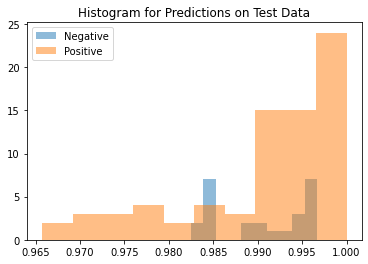

Average Difference between Positive and Negative Class: 0.00039714574813842773


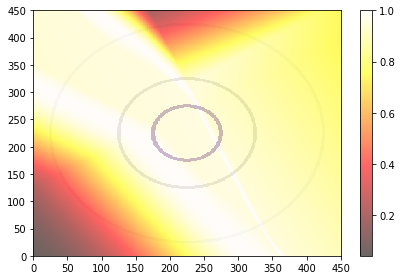

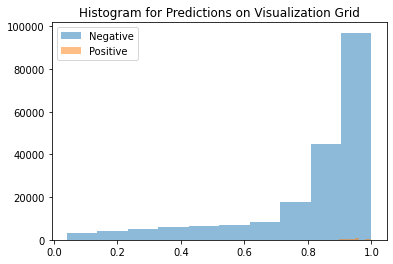

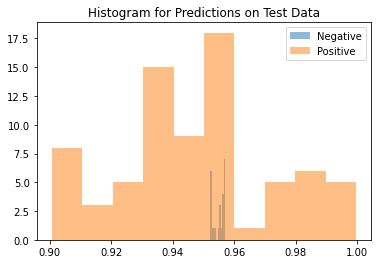

Average Difference between Positive and Negative Class: -0.007214188575744629


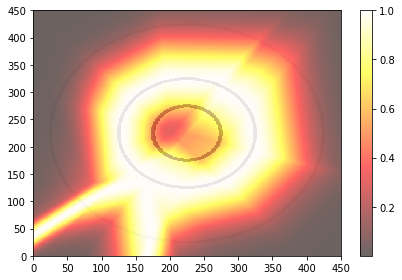

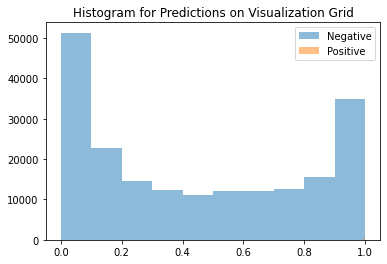

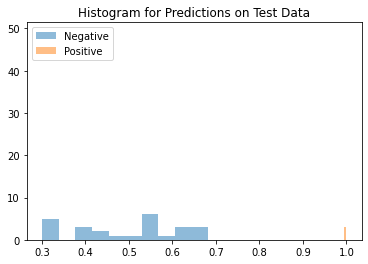

Average Difference between Positive and Negative Class: 0.5035978555679321


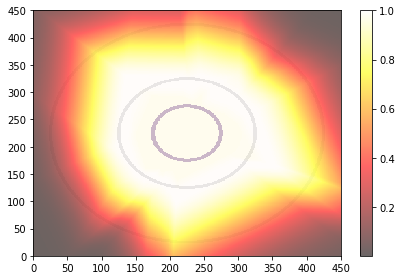

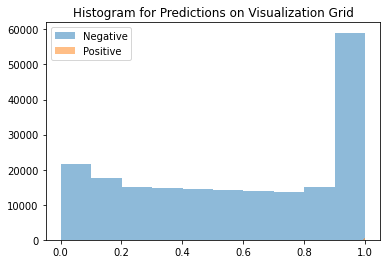

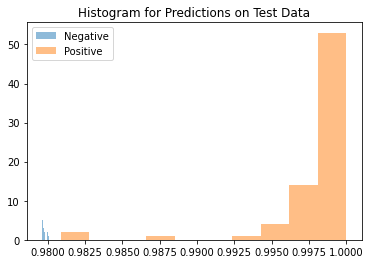

Average Difference between Positive and Negative Class: 0.018174052238464355


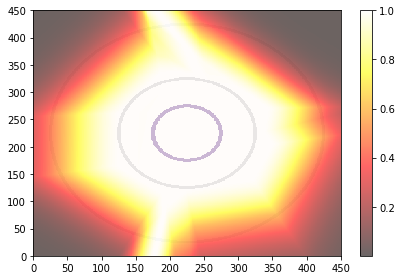

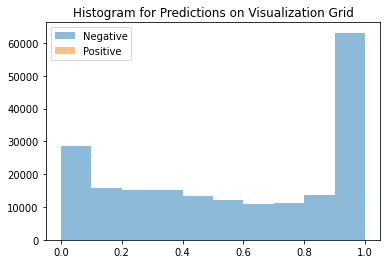

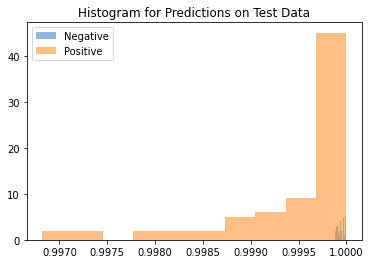

Average Difference between Positive and Negative Class: -0.0004940032958984375


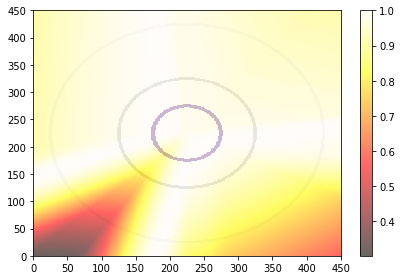

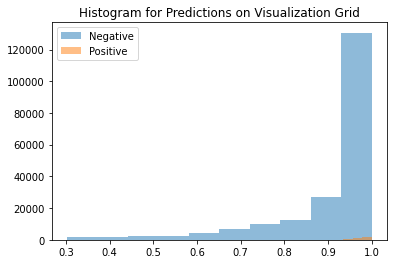

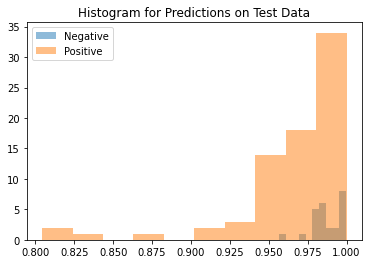

Average Difference between Positive and Negative Class: -0.019554853439331055


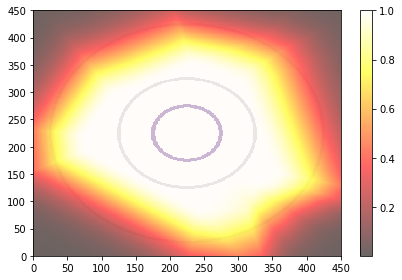

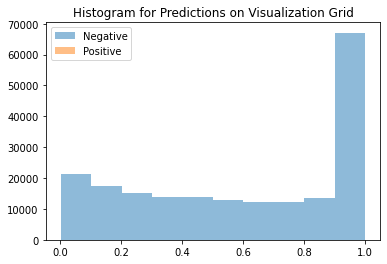

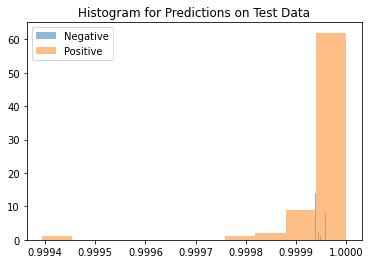

Average Difference between Positive and Negative Class: 1.6987323760986328e-05


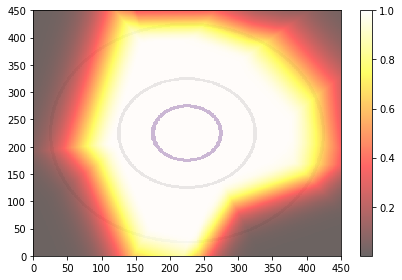

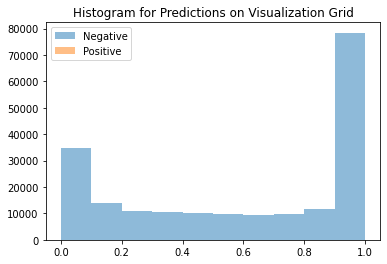

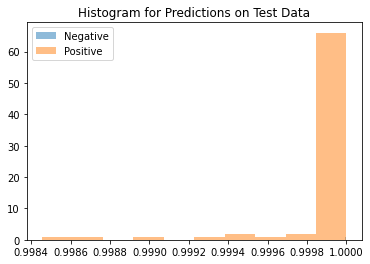

Average Difference between Positive and Negative Class: -0.00011664628982543945


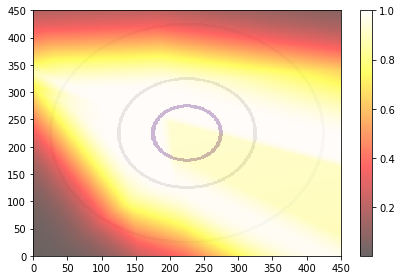

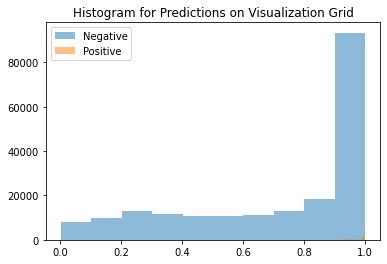

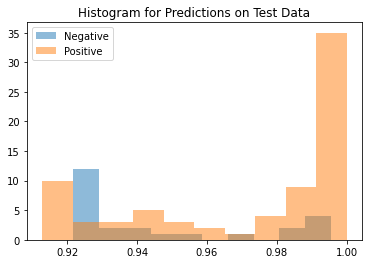

Average Difference between Positive and Negative Class: 0.0264737606048584


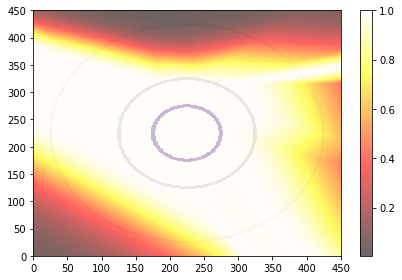

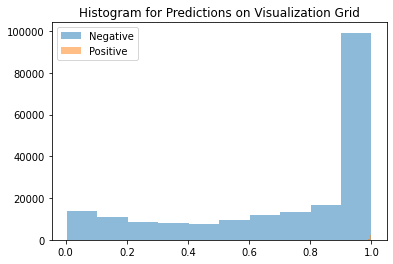

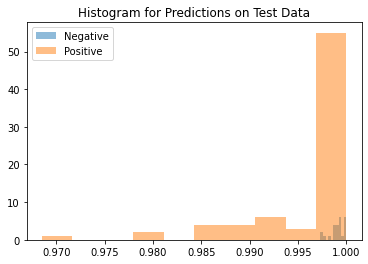

Average Difference between Positive and Negative Class: -0.002834022045135498


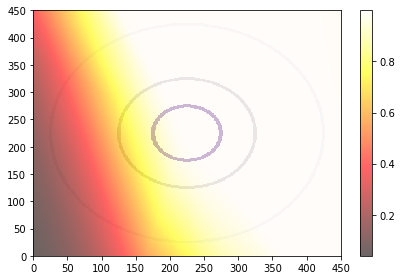

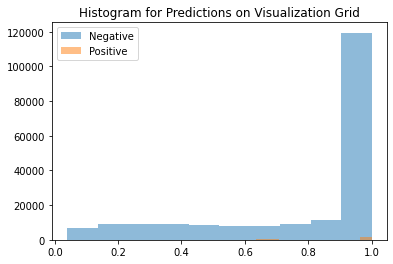

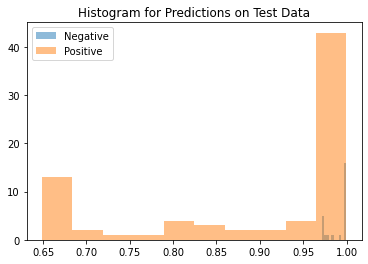

Average Difference between Positive and Negative Class: -0.09122830629348755


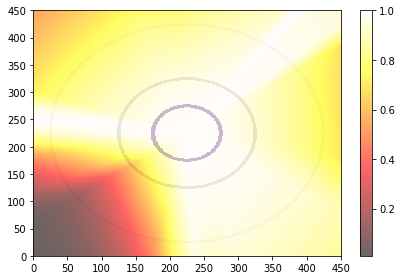

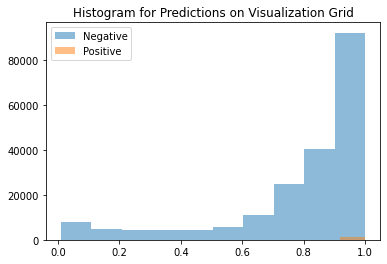

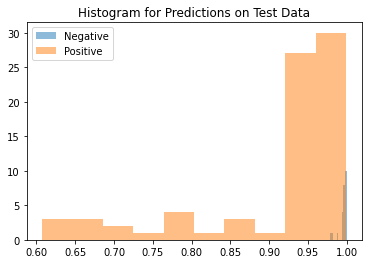

Average Difference between Positive and Negative Class: -0.0833437442779541


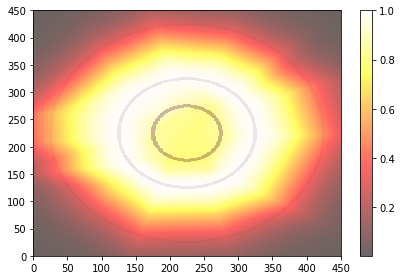

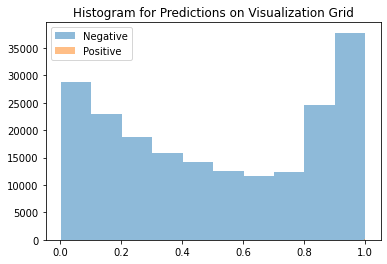

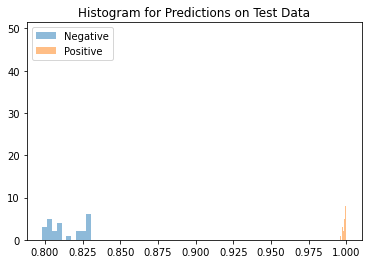

Average Difference between Positive and Negative Class: 0.18523579835891724


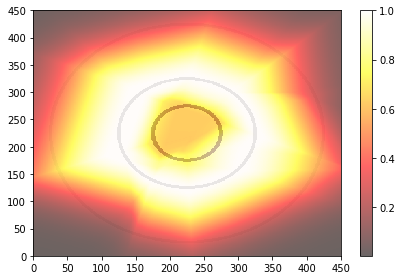

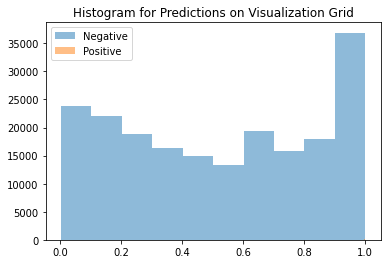

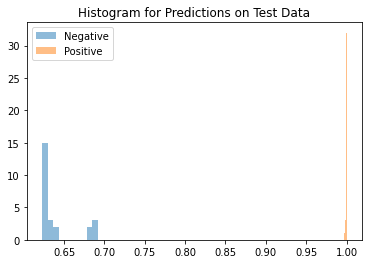

Average Difference between Positive and Negative Class: 0.3595511317253113


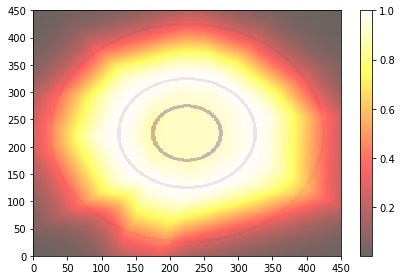

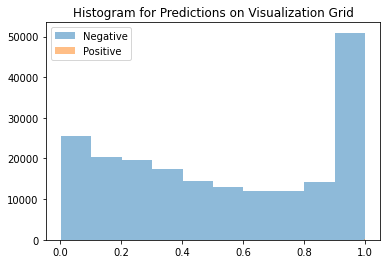

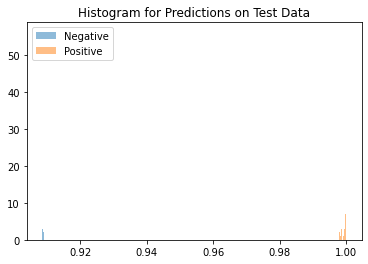

Average Difference between Positive and Negative Class: 0.09106326103210449


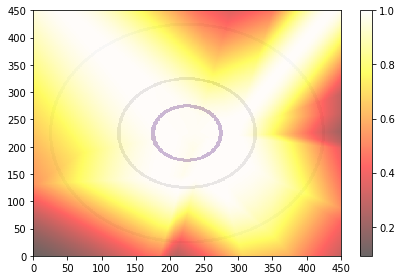

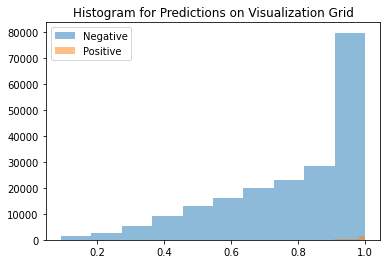

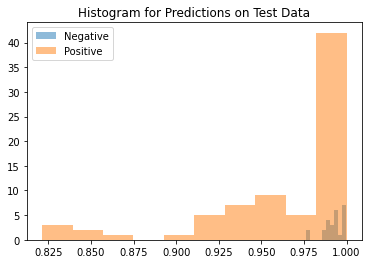

Average Difference between Positive and Negative Class: -0.027880191802978516


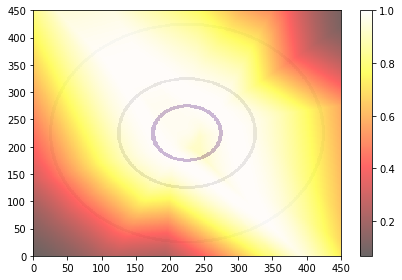

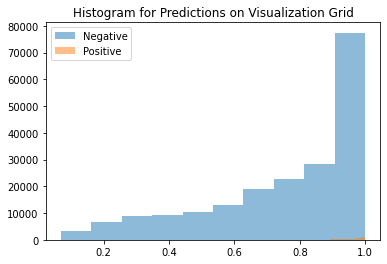

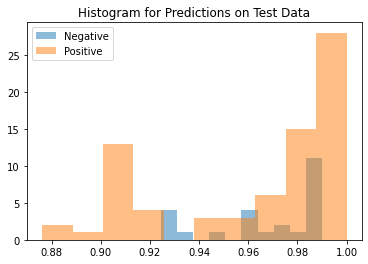

Average Difference between Positive and Negative Class: -0.0037679076194763184


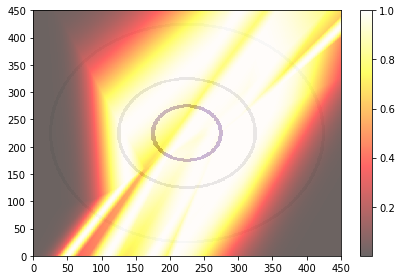

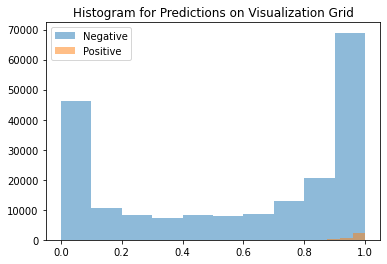

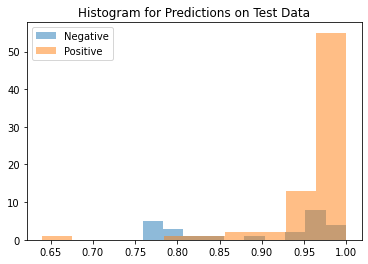

Average Difference between Positive and Negative Class: 0.07325714826583862


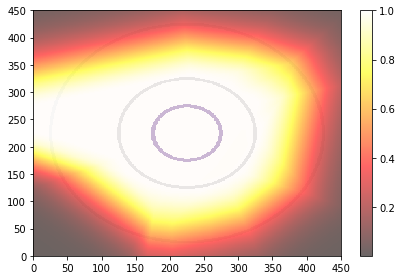

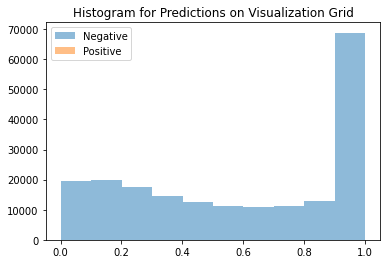

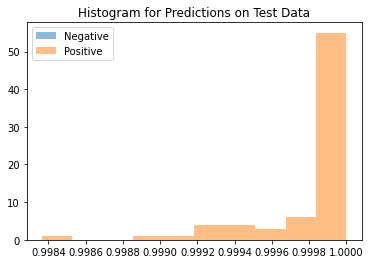

Average Difference between Positive and Negative Class: -0.0001748204231262207
AUPR (Train): 0.9930016957603065+-0.01717114447011824
AUPR (Test): 0.8271359793596702+-0.145168249178178
Average Distance between Means: 0.05377514287829399+-0.1402696818113327


([0.9756229741104263,
  0.9999999999999999,
  0.9951939111338683,
  1.0,
  0.9999999999999999,
  1.0,
  0.9662386835069461,
  1.0,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9286491260959852,
  0.9946848075250178,
  1.0,
  1.0,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9996444128338864,
  0.9999999999999999],
 [0.9488944082934762,
  0.8462753299752472,
  0.7599331905051006,
  1.0,
  0.9999999999999999,
  0.6008912651932157,
  0.6991451158829092,
  0.9304668646814032,
  0.7797277274320465,
  0.9090937608981525,
  0.7421450945155542,
  0.5999076865069298,
  0.5433630128112676,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.741405714061107,
  0.8365190167774085,
  0.8949729213478865,
  0.7099784783116995],
 [0.054344356,
  0.00039714575,
  -0.0072141886,
  0.50359786,
  0.018174052,
  -0.0004940033,
  -0.019554853,
  1.6987324e-05,
  -0.00011664629,
  0.02647376,
  -0.002834022,
  -0.09122831,
  -0.083343744,
  0.1852358,
  0.35955113,
  0.09106326,
  -0.0

In [12]:
# ES3 with BCE fixed sigma=0.5
separation = "ES"
bumped = ""
sigma = 0.5
hidden_layers = 3
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='binary_crossentropy',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

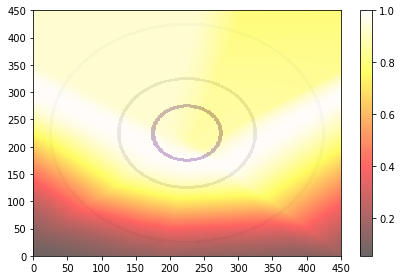

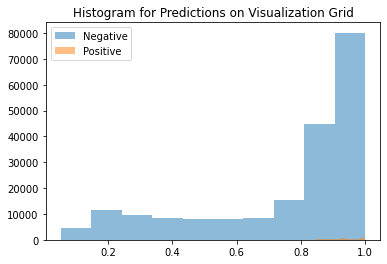

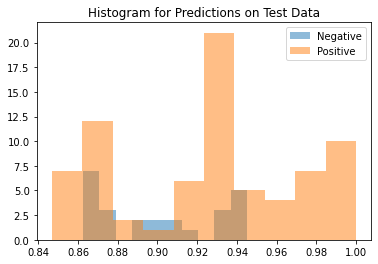

Average Difference between Positive and Negative Class: 0.02702653408050537


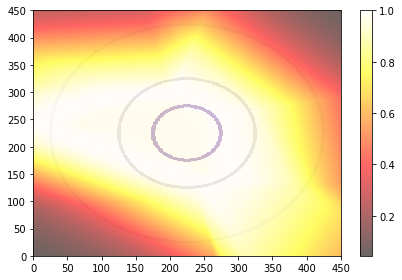

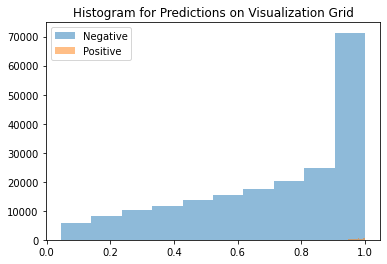

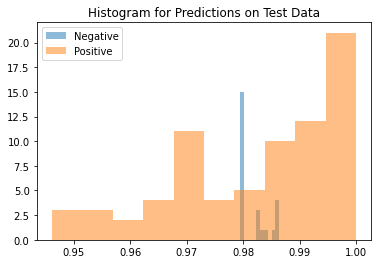

Average Difference between Positive and Negative Class: 0.0012192130088806152


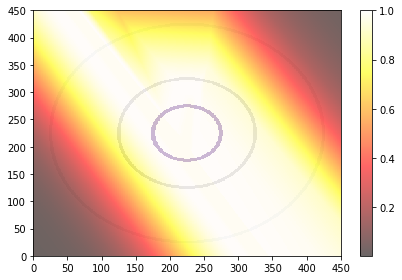

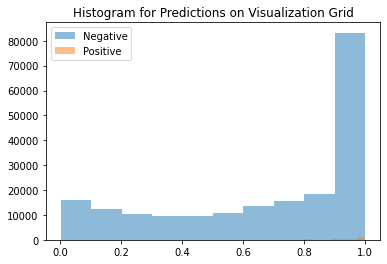

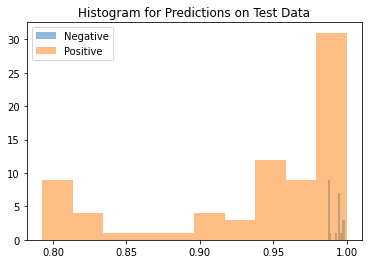

Average Difference between Positive and Negative Class: -0.05478948354721069


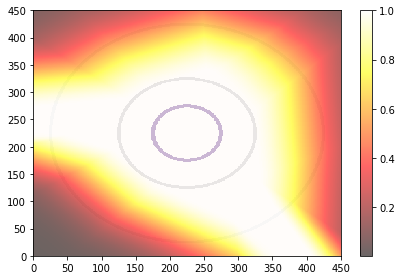

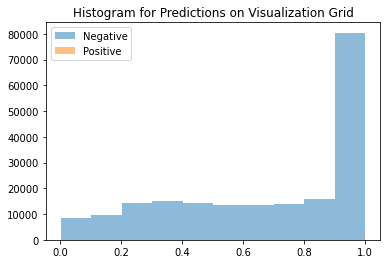

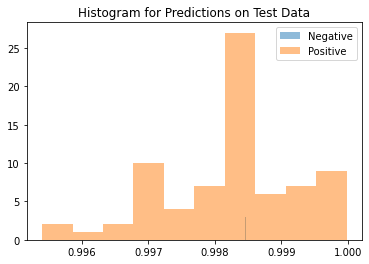

Average Difference between Positive and Negative Class: -0.00021594762802124023


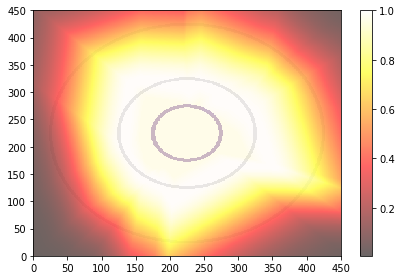

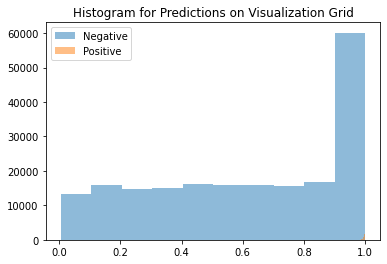

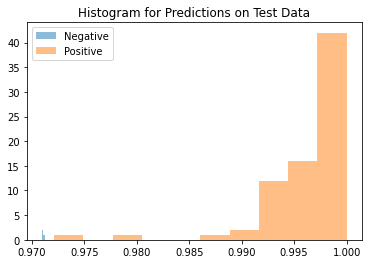

Average Difference between Positive and Negative Class: 0.02514249086380005


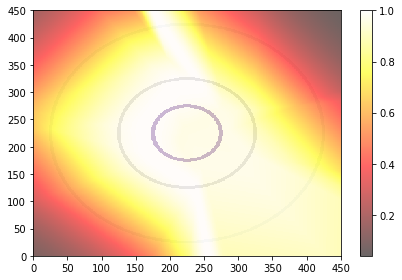

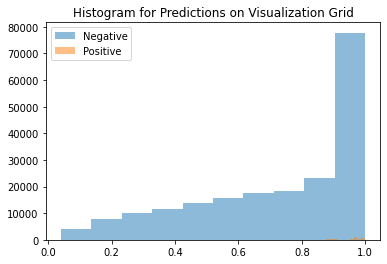

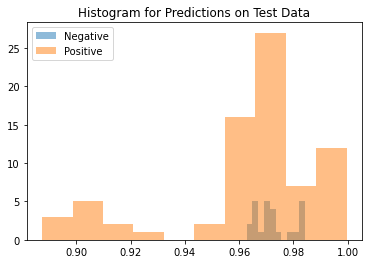

Average Difference between Positive and Negative Class: -0.00865083932876587


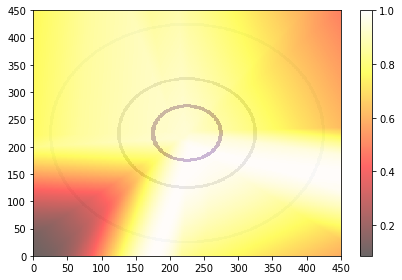

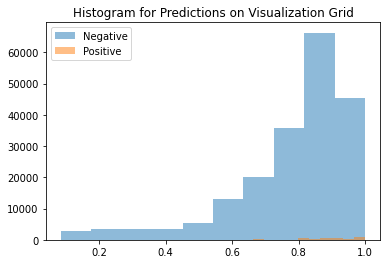

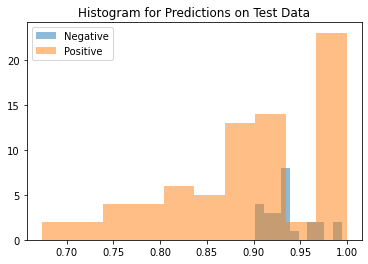

Average Difference between Positive and Negative Class: -0.043585121631622314


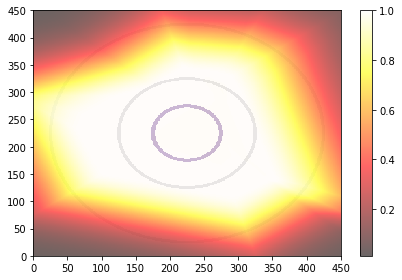

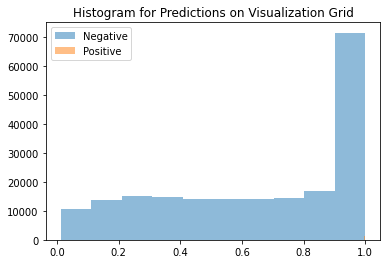

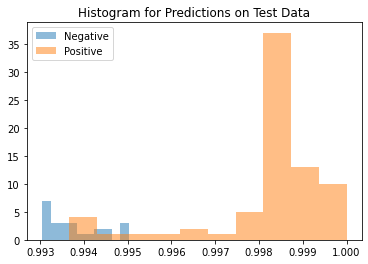

Average Difference between Positive and Negative Class: 0.004432976245880127


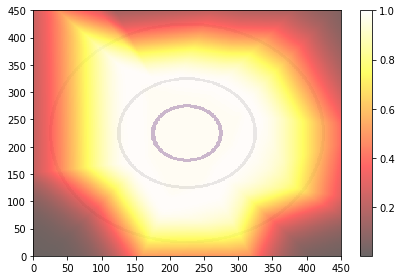

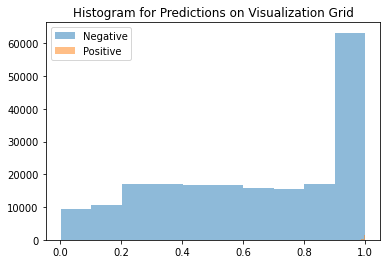

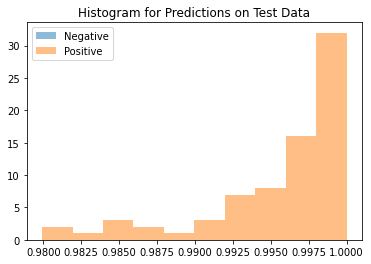

Average Difference between Positive and Negative Class: 0.008875250816345215


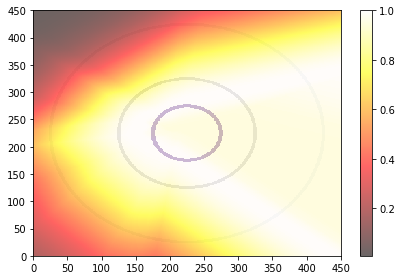

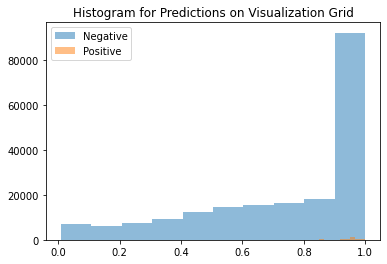

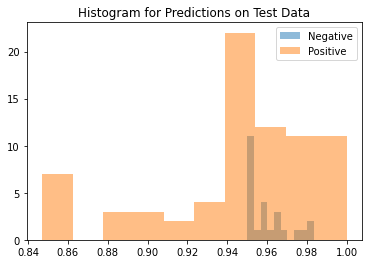

Average Difference between Positive and Negative Class: -0.013389050960540771


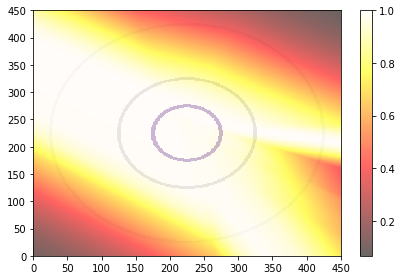

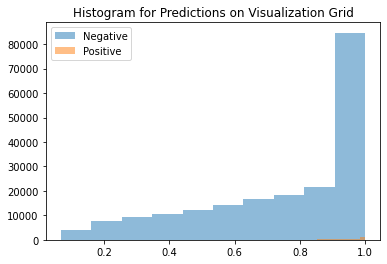

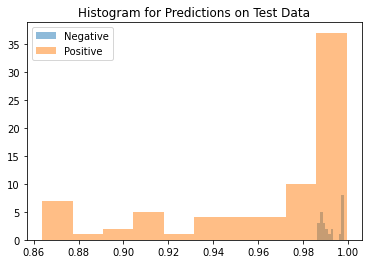

Average Difference between Positive and Negative Class: -0.029795944690704346


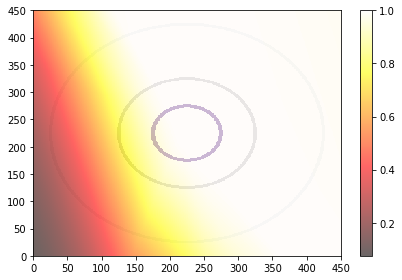

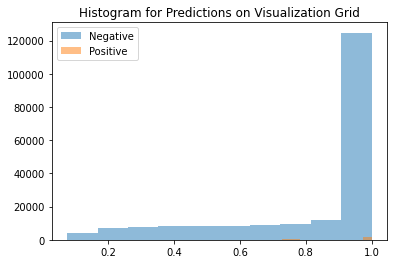

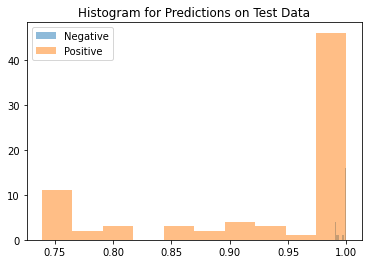

Average Difference between Positive and Negative Class: -0.0673295259475708


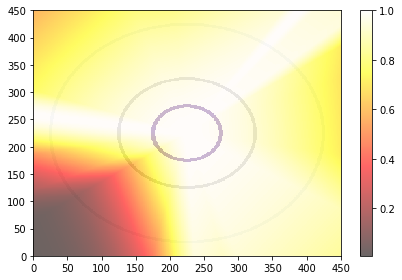

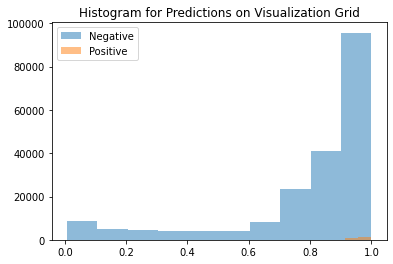

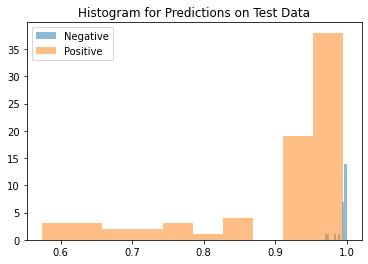

Average Difference between Positive and Negative Class: -0.08697950839996338


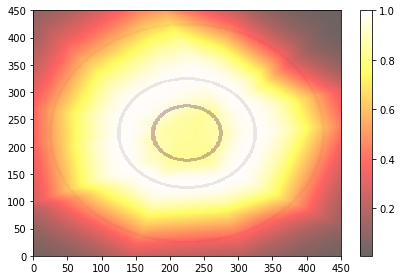

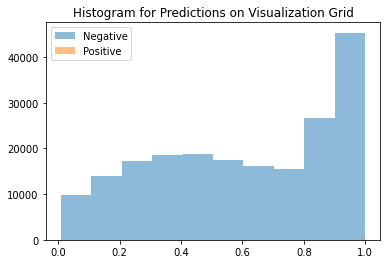

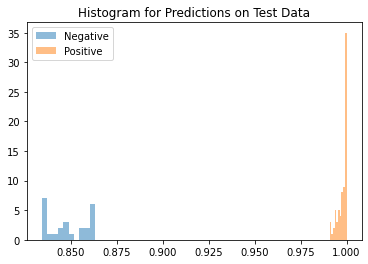

Average Difference between Positive and Negative Class: 0.14909785985946655


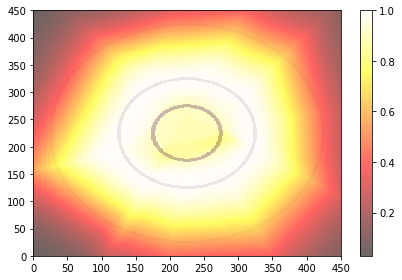

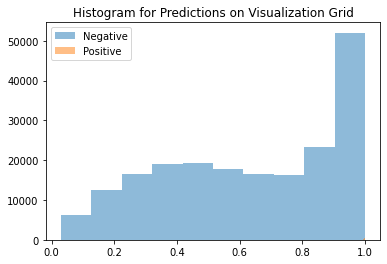

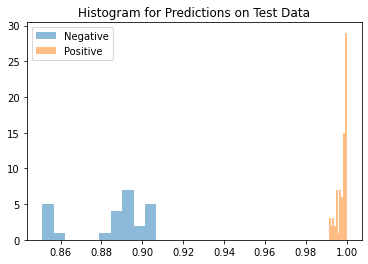

Average Difference between Positive and Negative Class: 0.11247819662094116


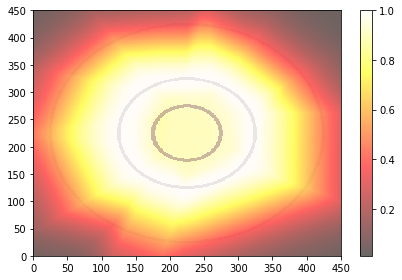

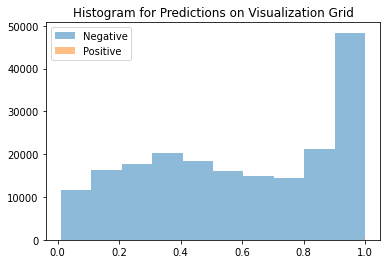

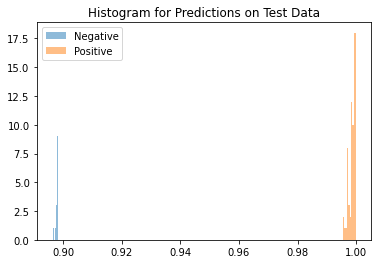

Average Difference between Positive and Negative Class: 0.10086697340011597


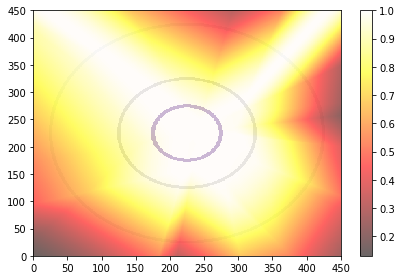

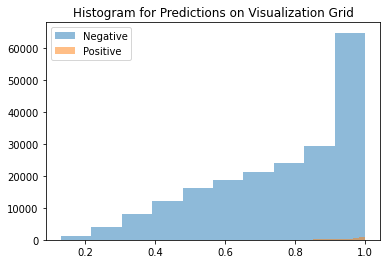

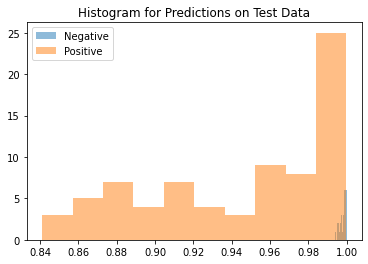

Average Difference between Positive and Negative Class: -0.052187323570251465


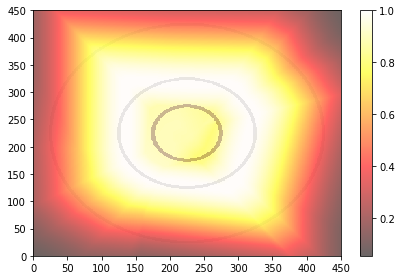

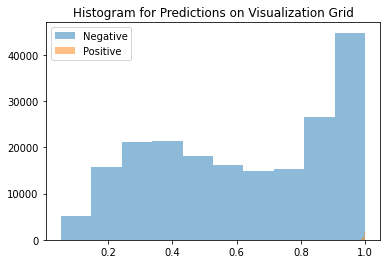

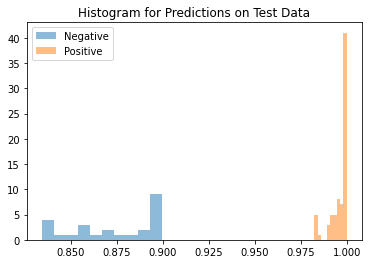

Average Difference between Positive and Negative Class: 0.12296634912490845


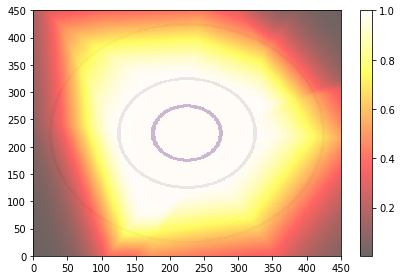

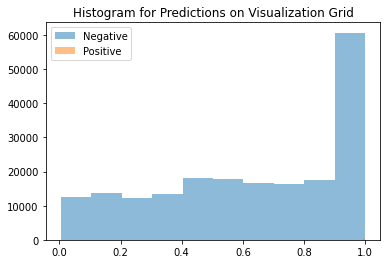

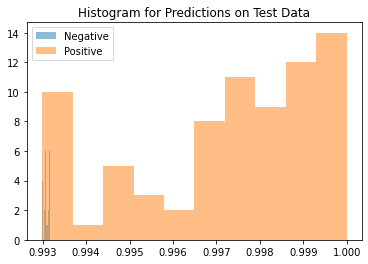

Average Difference between Positive and Negative Class: 0.004223942756652832


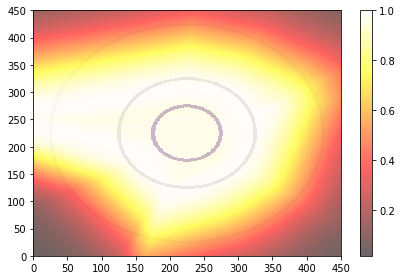

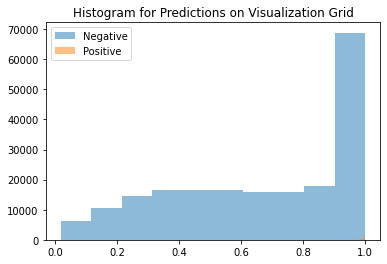

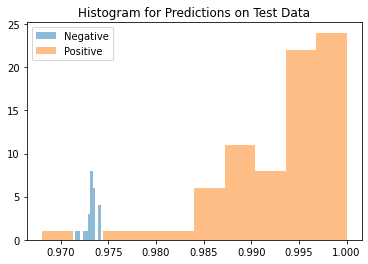

Average Difference between Positive and Negative Class: 0.020136237144470215
AUPR (Train): 0.9873871190648931+-0.026159380382156018
AUPR (Test): 0.844024868319792+-0.1589246765728317
Average Distance between Means: 0.010977163910865784+-0.06344995647668839


([0.9570371488438687,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9596045722525894,
  0.9999999999999999,
  0.9999999999999999,
  0.8977539209292646,
  0.994147555717004,
  0.9466487709070148,
  0.9925504126481214,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999],
 [0.869257820136267,
  0.8784021597391855,
  0.6438259839332723,
  0.7825929889168505,
  0.9999999999999999,
  0.7764691179245022,
  0.7301794969034792,
  0.9930731193545549,
  0.9793744995078367,
  0.78378379896807,
  0.6318674497429718,
  0.7185543134273776,
  0.5455925734746043,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.5590797238166368,
  0.9999999999999999,
  0.9917944889003988,
  0.9966498316498316],
 [0.027026534,
  0.001219213,
  -0.054789484,
  -0.00021594763,
  0.02514249,
  -0.008650839,
  -0.04358512,
  0.0044329762,
  0.00887525

In [13]:
# ES3 with MSE fixed sigma=0.5
separation = "ES"
bumped = ""
sigma = 0.5
hidden_layers = 3
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='mse',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

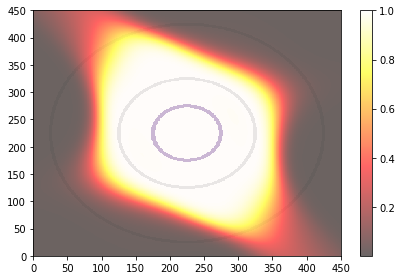

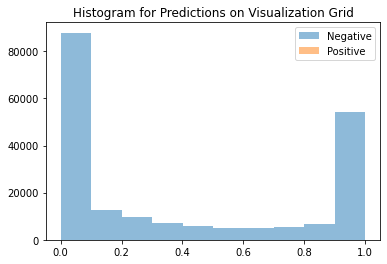

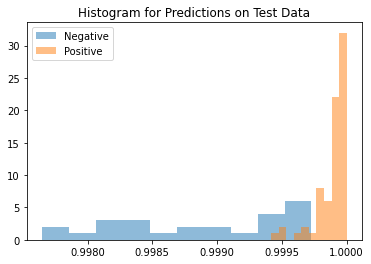

Average Difference between Positive and Negative Class: 0.001031339168548584


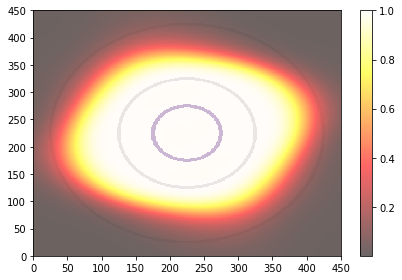

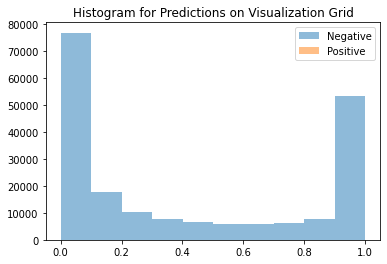

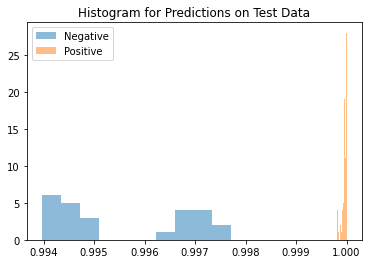

Average Difference between Positive and Negative Class: 0.004380762577056885


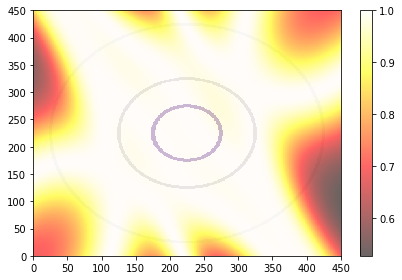

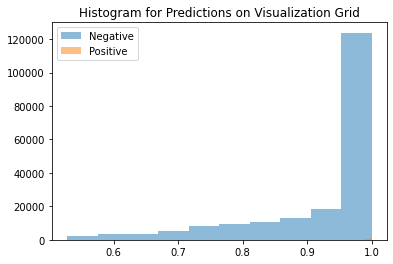

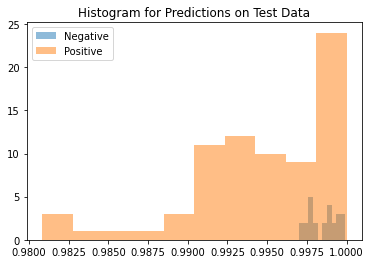

Average Difference between Positive and Negative Class: -0.0036658048629760742


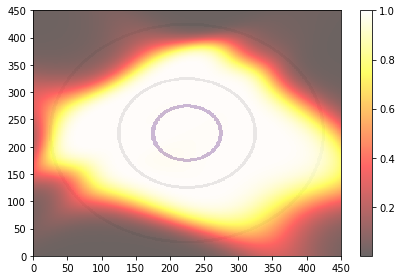

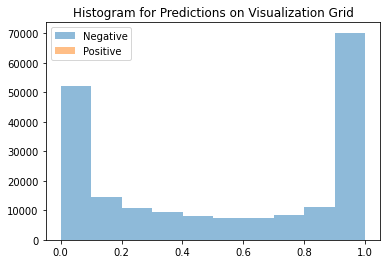

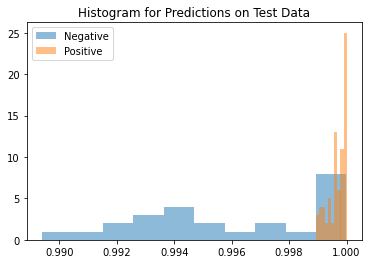

Average Difference between Positive and Negative Class: 0.003775179386138916


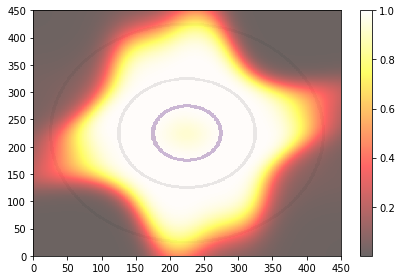

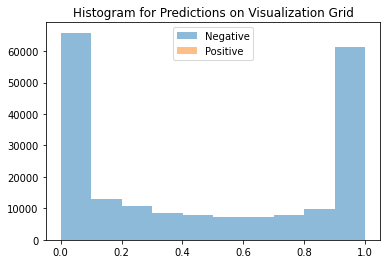

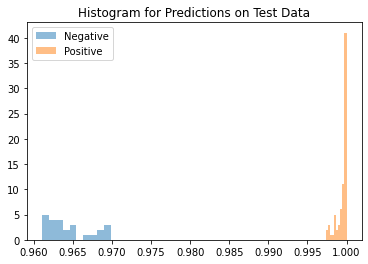

Average Difference between Positive and Negative Class: 0.034947335720062256


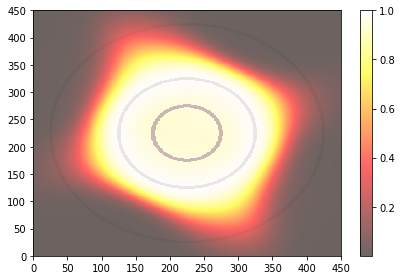

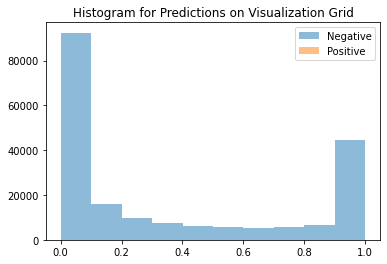

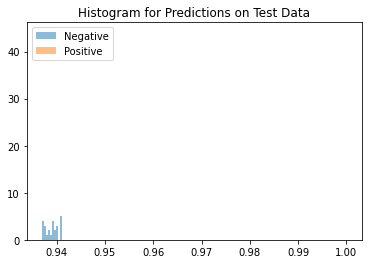

Average Difference between Positive and Negative Class: 0.06090885400772095


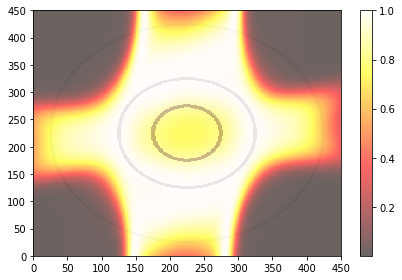

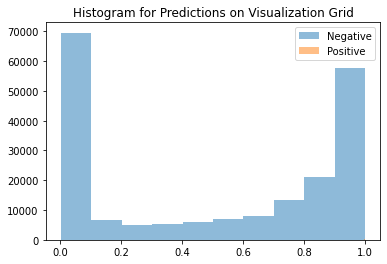

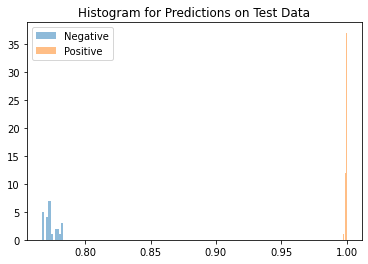

Average Difference between Positive and Negative Class: 0.22548460960388184


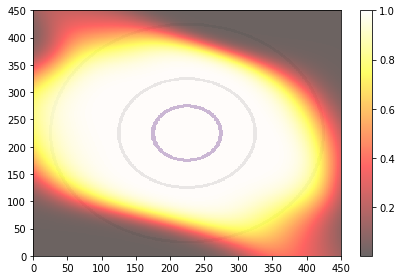

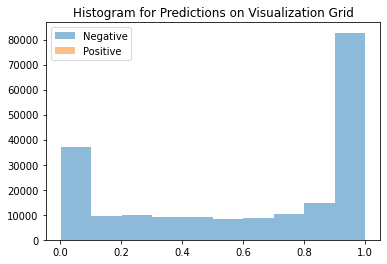

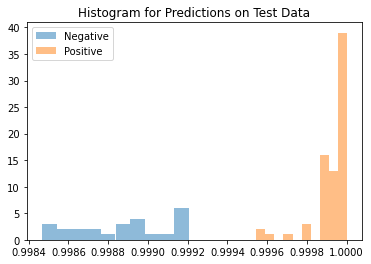

Average Difference between Positive and Negative Class: 0.0010515451431274414


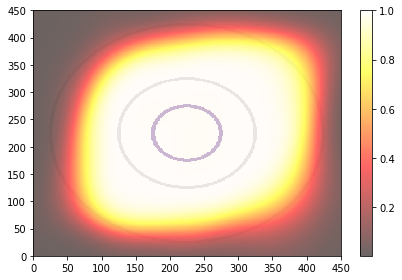

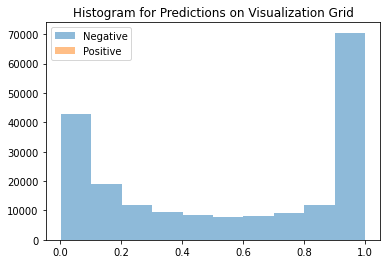

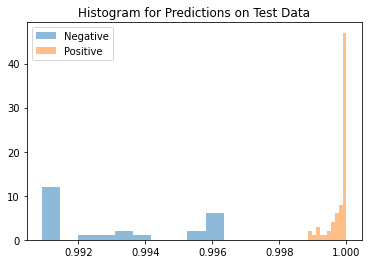

Average Difference between Positive and Negative Class: 0.0066727399826049805


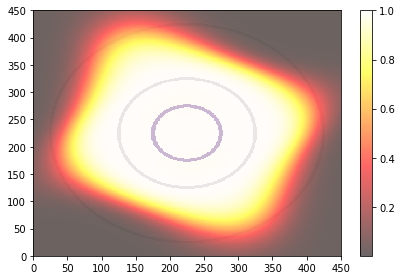

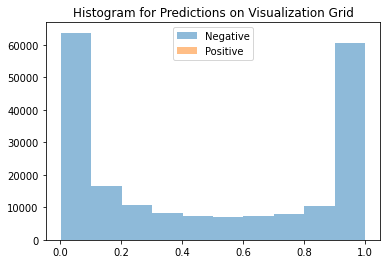

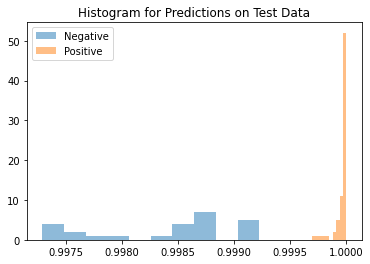

Average Difference between Positive and Negative Class: 0.001572251319885254


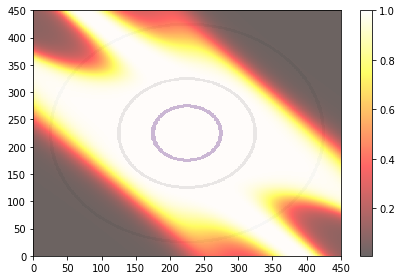

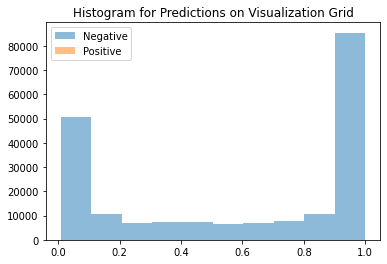

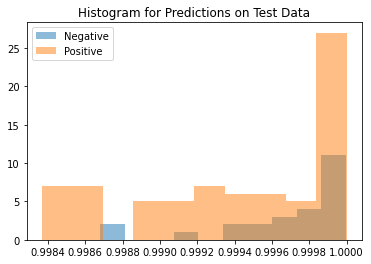

Average Difference between Positive and Negative Class: -0.0002747774124145508


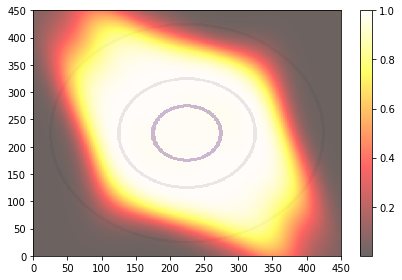

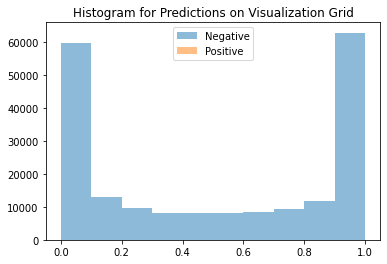

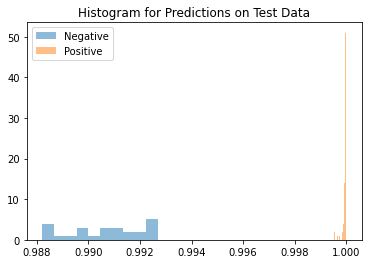

Average Difference between Positive and Negative Class: 0.009282410144805908


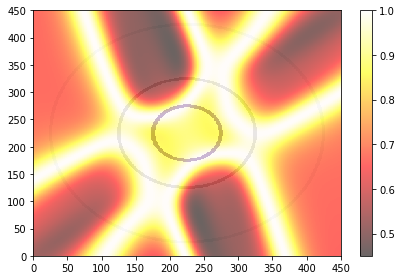

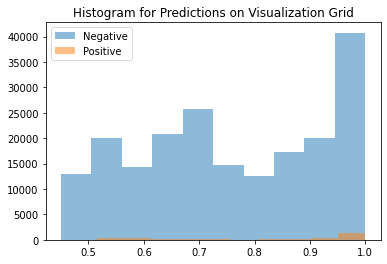

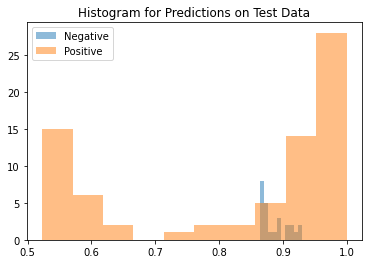

Average Difference between Positive and Negative Class: -0.06180053949356079


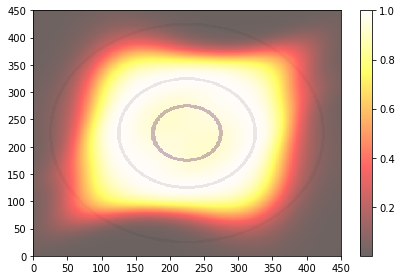

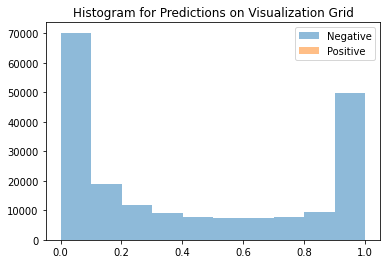

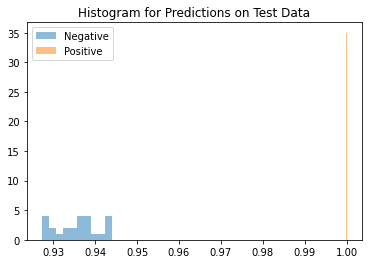

Average Difference between Positive and Negative Class: 0.06416153907775879


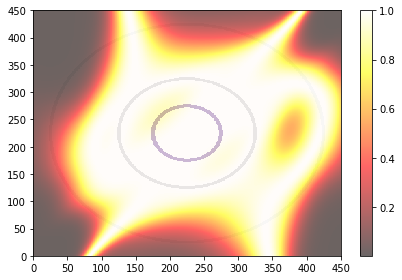

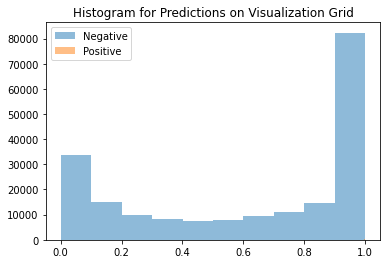

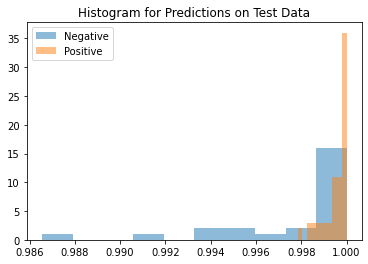

Average Difference between Positive and Negative Class: 0.0017293691635131836


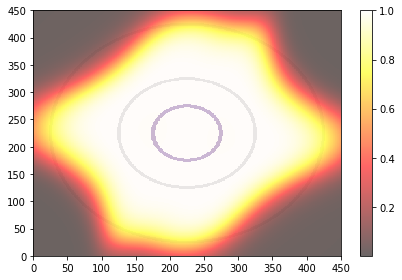

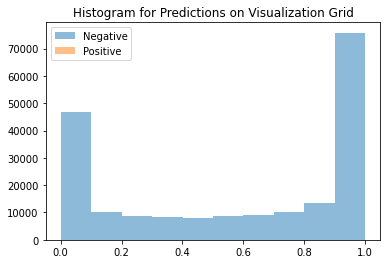

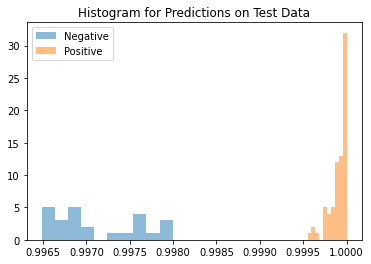

Average Difference between Positive and Negative Class: 0.002791166305541992


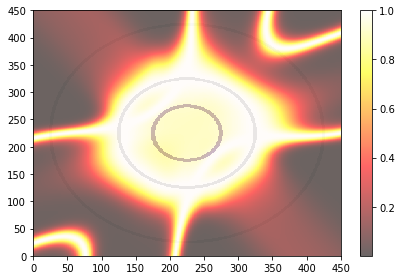

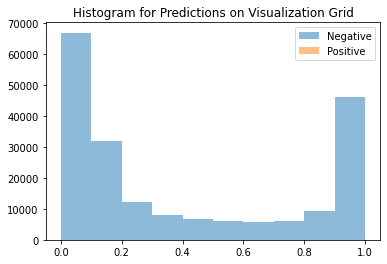

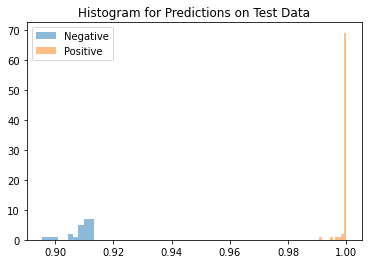

Average Difference between Positive and Negative Class: 0.0908157229423523


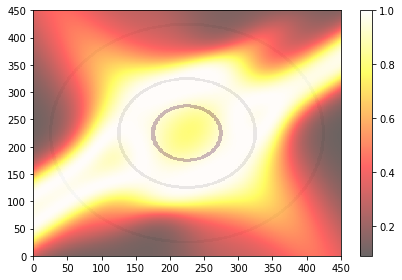

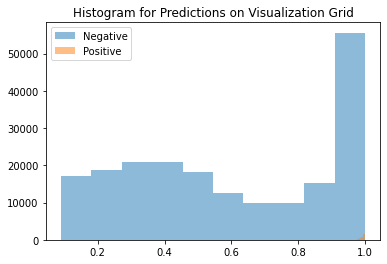

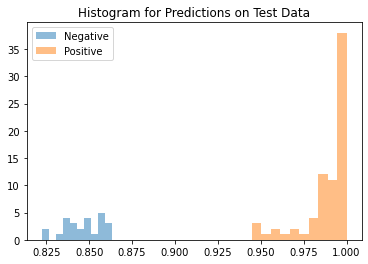

Average Difference between Positive and Negative Class: 0.14249920845031738


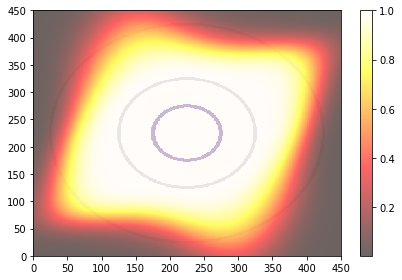

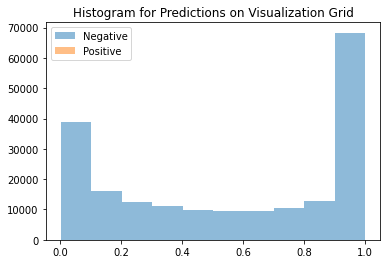

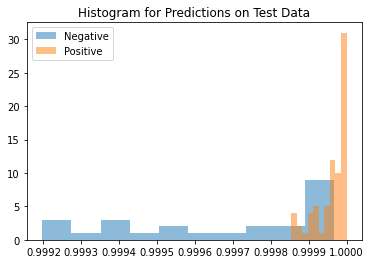

Average Difference between Positive and Negative Class: 0.00030034780502319336


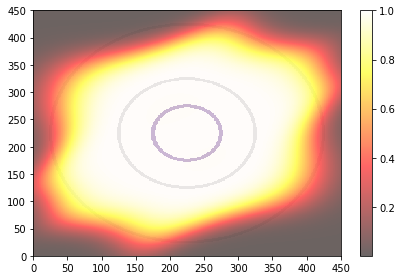

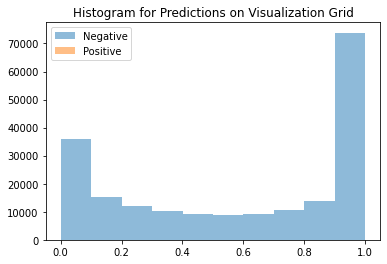

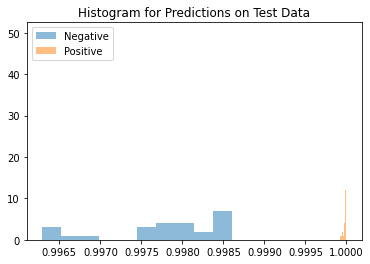

Average Difference between Positive and Negative Class: 0.0021958351135253906
AUPR (Train): 0.9935086656520861+-0.026941963706335514
AUPR (Test): 0.945060578919404+-0.0988416609403515
Average Distance between Means: 0.02939295396208763+-0.06131195276975632


([0.9999999999999999,
  1.0,
  0.994147555717004,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  1.0,
  0.9999999999999998,
  1.0,
  0.9999999999999999,
  1.0,
  0.8762023655118532,
  1.0,
  1.0,
  1.0,
  1.0,
  0.9998233918128654,
  0.9999999999999999,
  1.0],
 [0.9952041464499399,
  1.0,
  0.6988137007174173,
  0.8868458946969041,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  0.9999999999999998,
  0.7204497263577047,
  0.9999999999999999,
  0.8601573457671519,
  1.0,
  0.7682621108963406,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9714786535026233,
  1.0000000000000002],
 [0.0010313392,
  0.0043807626,
  -0.0036658049,
  0.0037751794,
  0.034947336,
  0.060908854,
  0.22548461,
  0.0010515451,
  0.00667274,
  0.0015722513,
  -0.0002747774,
  0.00928241,
  -0.06180054,
  0.06416154,
  0.0017293692,
  0.0027911663,
  0.09081572,
  0.14249921,
  0.0003003478,
  0.002195835])

In [14]:
# ES3b with BCE fixed sigma=0.5
separation = "ES"
bumped = "b"
sigma = 0.5
hidden_layers = 3
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []
models = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='binary_crossentropy',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    models.append(model)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

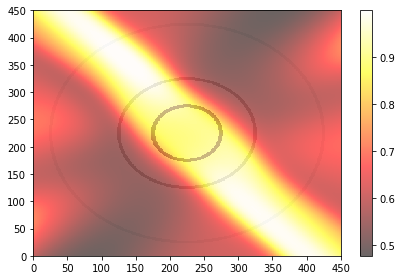

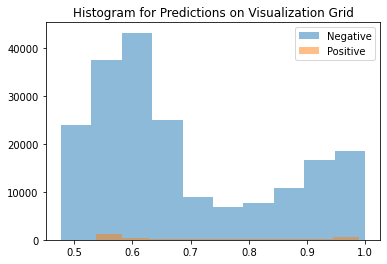

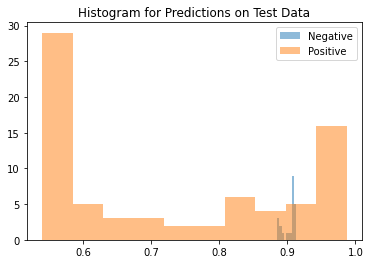

Average Difference between Positive and Negative Class: -0.17180973291397095


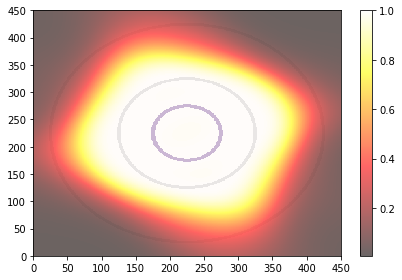

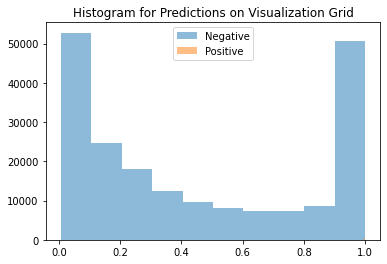

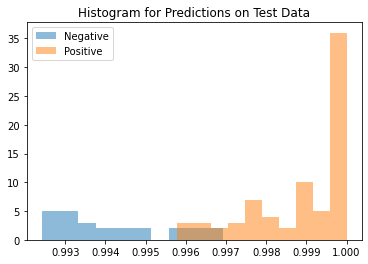

Average Difference between Positive and Negative Class: 0.004765927791595459


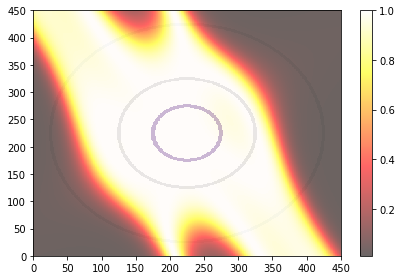

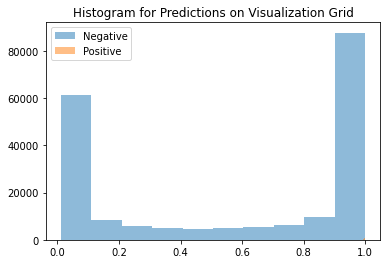

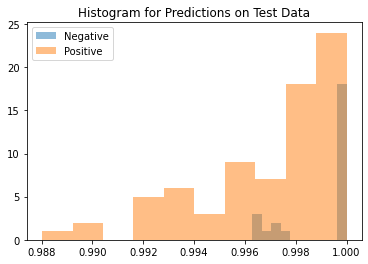

Average Difference between Positive and Negative Class: -0.0020213723182678223


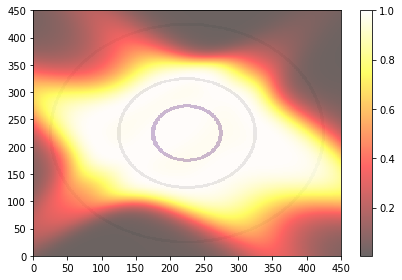

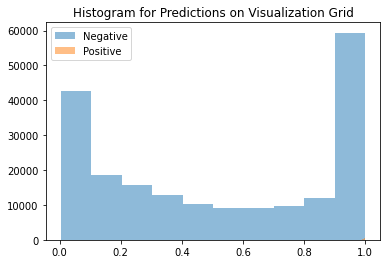

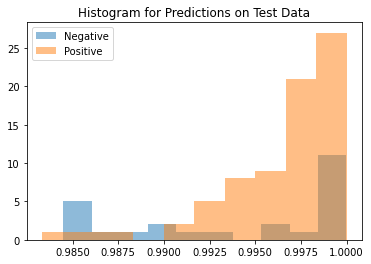

Average Difference between Positive and Negative Class: 0.002560138702392578


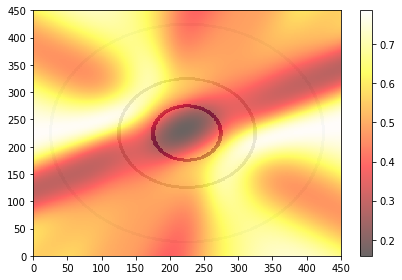

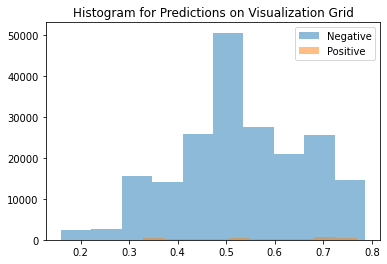

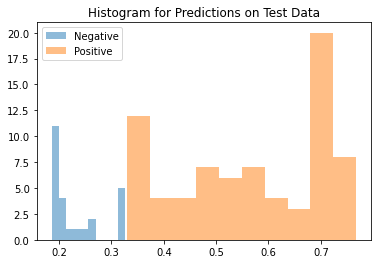

Average Difference between Positive and Negative Class: 0.33736979961395264


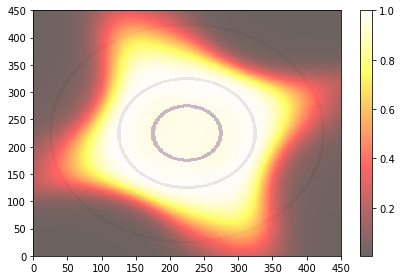

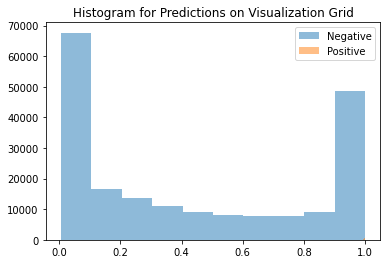

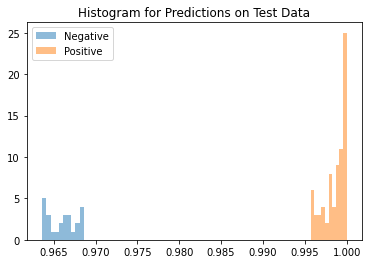

Average Difference between Positive and Negative Class: 0.03263115882873535


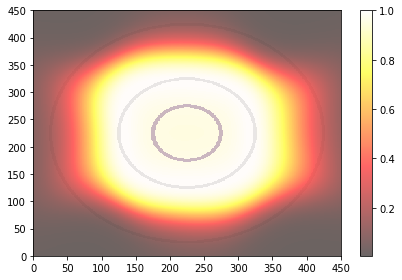

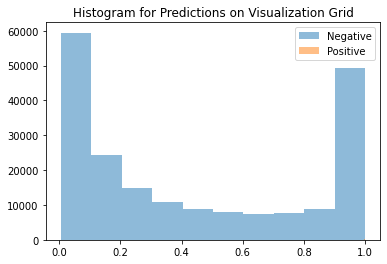

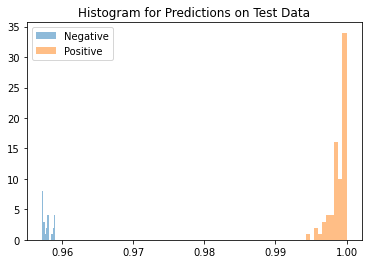

Average Difference between Positive and Negative Class: 0.04093354940414429


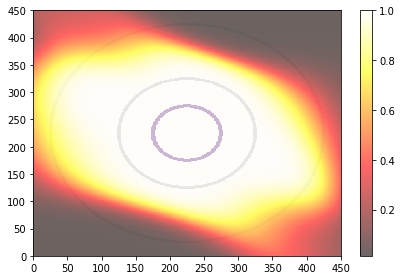

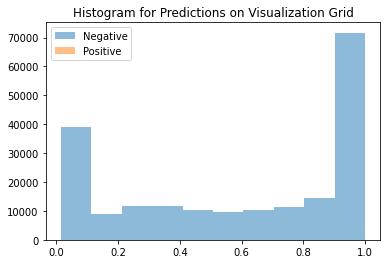

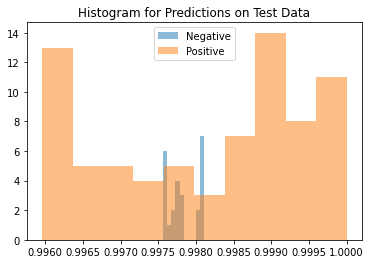

Average Difference between Positive and Negative Class: 0.00031697750091552734


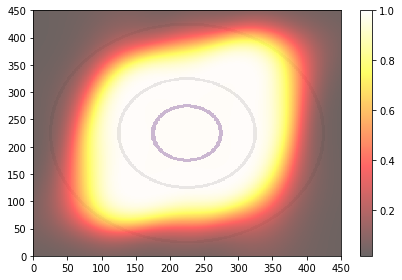

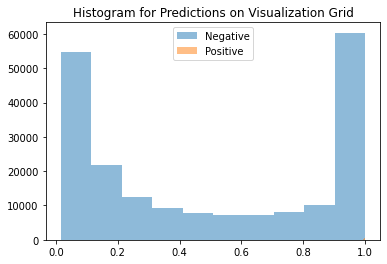

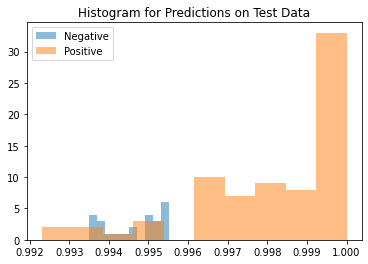

Average Difference between Positive and Negative Class: 0.0035797953605651855


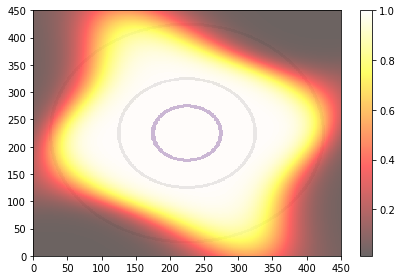

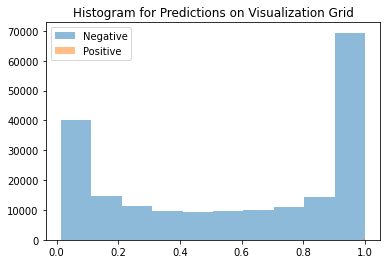

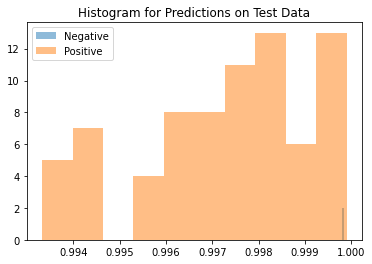

Average Difference between Positive and Negative Class: -0.002532482147216797


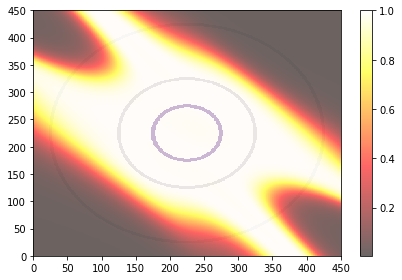

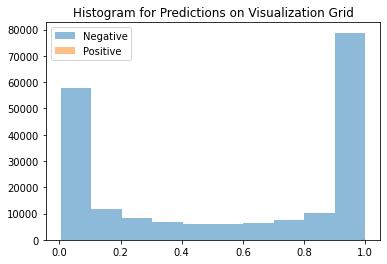

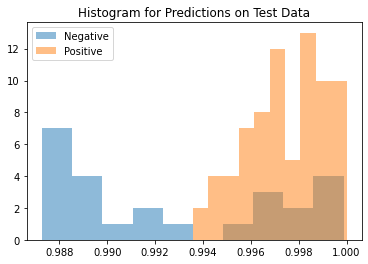

Average Difference between Positive and Negative Class: 0.004923701286315918


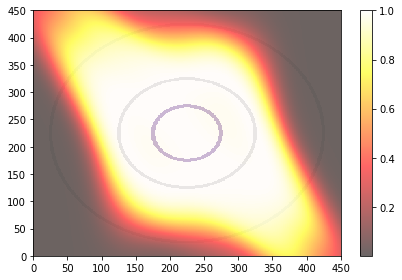

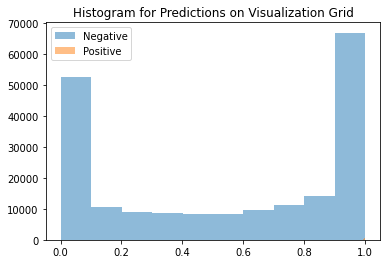

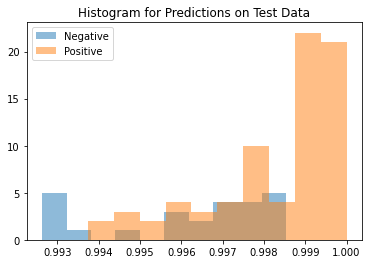

Average Difference between Positive and Negative Class: 0.0021643638610839844


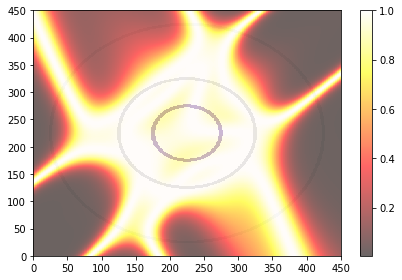

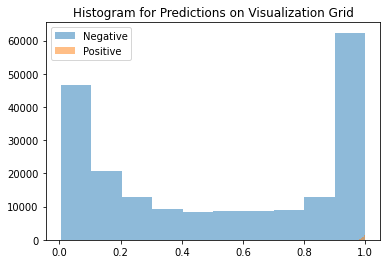

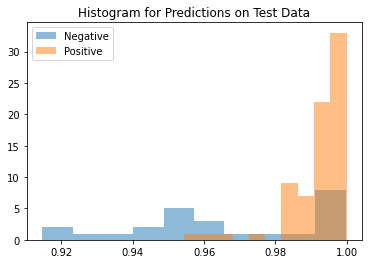

Average Difference between Positive and Negative Class: 0.027415752410888672


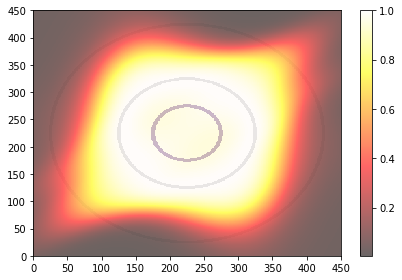

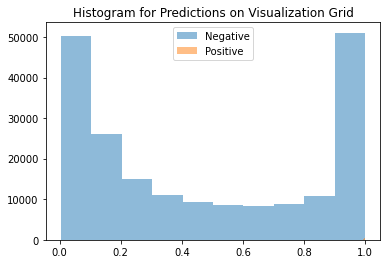

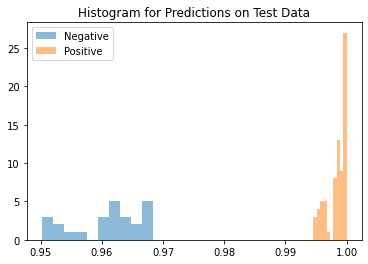

Average Difference between Positive and Negative Class: 0.037458598613739014


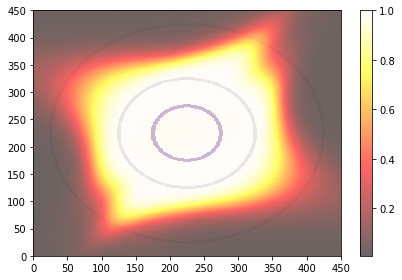

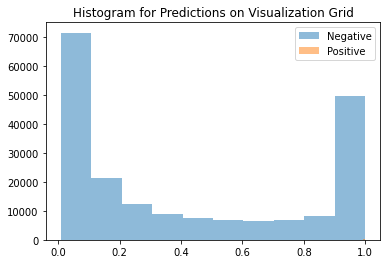

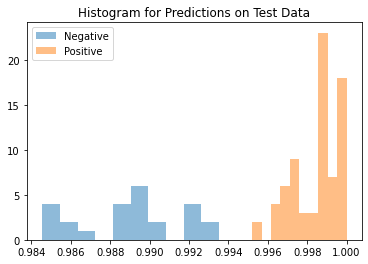

Average Difference between Positive and Negative Class: 0.00954216718673706


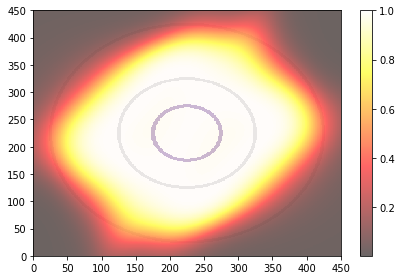

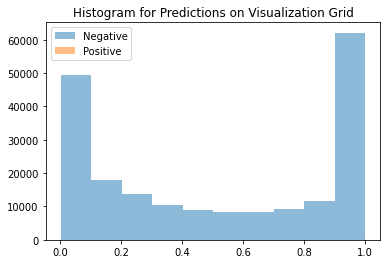

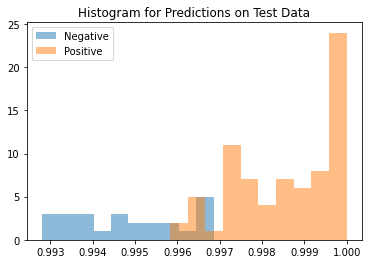

Average Difference between Positive and Negative Class: 0.0037803053855895996


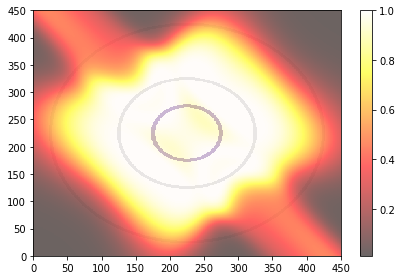

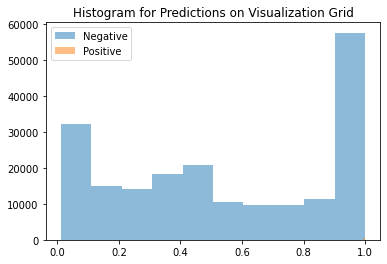

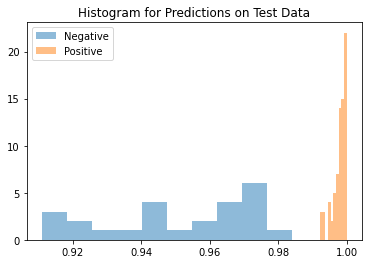

Average Difference between Positive and Negative Class: 0.04655224084854126


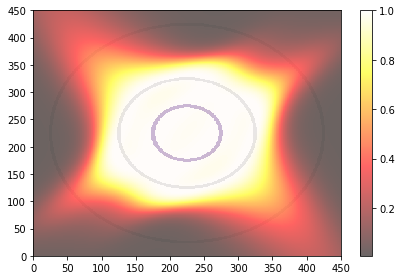

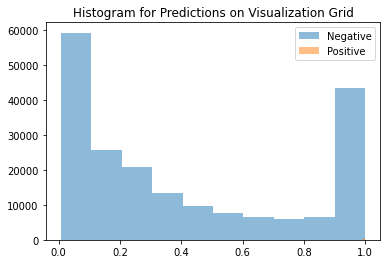

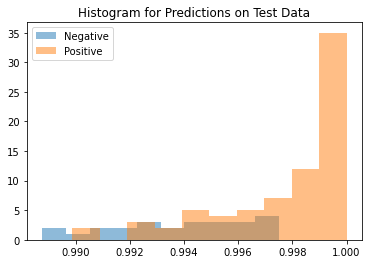

Average Difference between Positive and Negative Class: 0.003933966159820557


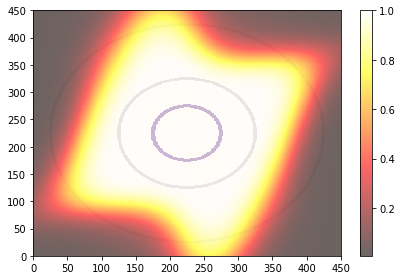

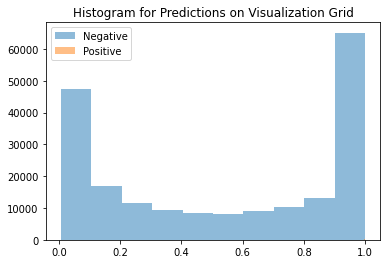

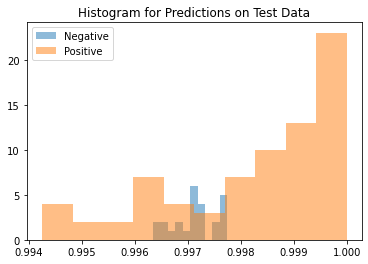

Average Difference between Positive and Negative Class: 0.0010986924171447754


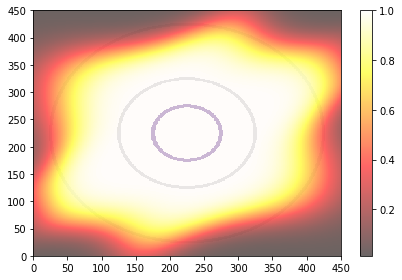

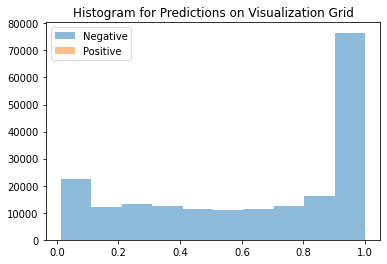

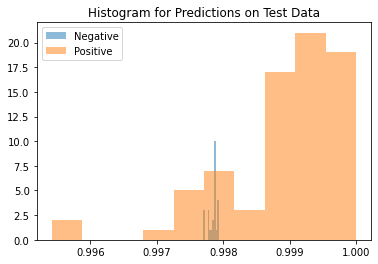

Average Difference between Positive and Negative Class: 0.001073598861694336
AUPR (Train): 0.9783485113201781+-0.07078794786099712
AUPR (Test): 0.9043341741742996+-0.12515367187691118
Average Distance between Means: 0.01918685808777809+-0.08462897688150406


([0.8724711179384375,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.6944991084651272,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999],
 [0.7357259768472507,
  0.9961329931110002,
  0.649294113013736,
  0.7228841680186106,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.8794812582403128,
  0.978178874129788,
  0.588423627736929,
  0.867429663702549,
  0.9408633528483552,
  0.8858987608396136,
  1.0,
  0.9999999999999999,
  0.9941045096450347,
  0.9999999999999999,
  0.9577405438332436,
  0.931768099809255,
  0.958757541710314],
 [-0.17180973,
  0.004765928,
  -0.0020213723,
  0.0025601387,
  0.3373698,
  0.03263116,
  0.04093355,
  0.0003169775,
  0.0035797954,
  -0.0025324821,
  0.0049237013,


In [15]:
# ES3b with MSE fixed sigma=0.5
separation = "ES"
bumped = "b"
sigma = 0.5
hidden_layers = 3
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='mse',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

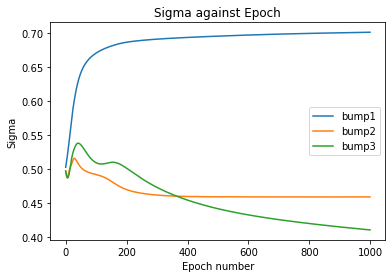

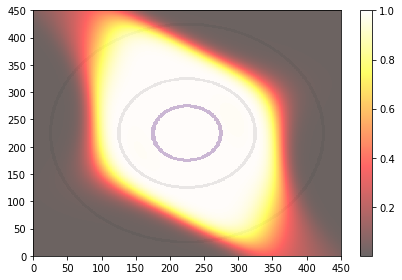

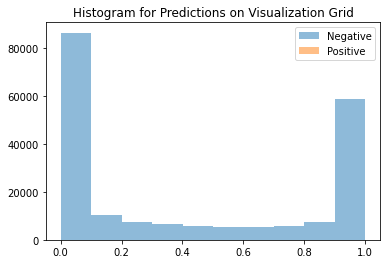

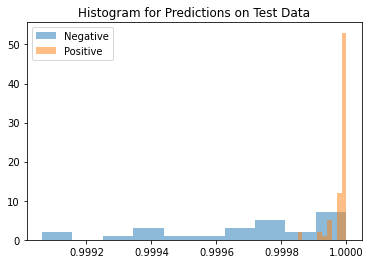

Average Difference between Positive and Negative Class: 0.0002942085266113281


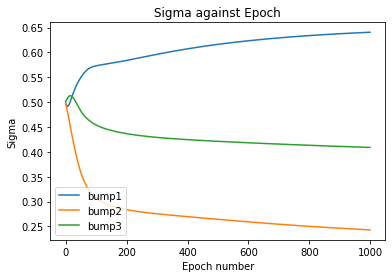

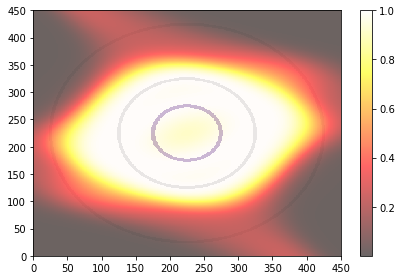

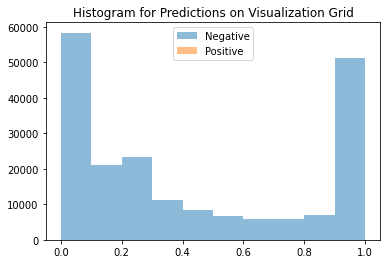

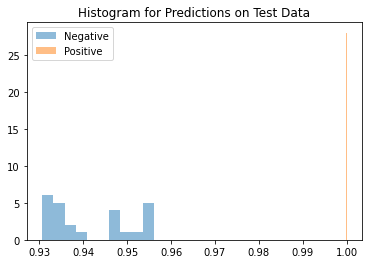

Average Difference between Positive and Negative Class: 0.058389246463775635


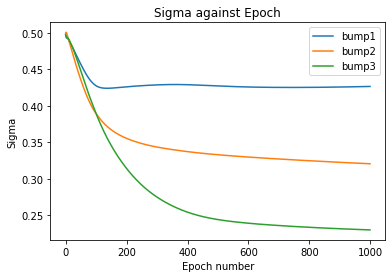

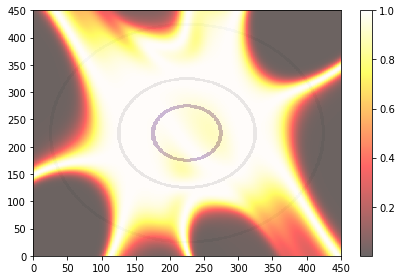

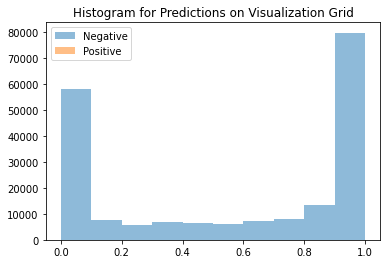

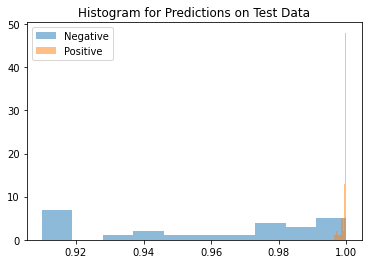

Average Difference between Positive and Negative Class: 0.041518986225128174


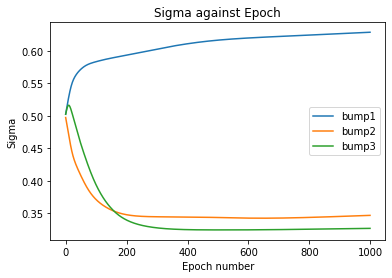

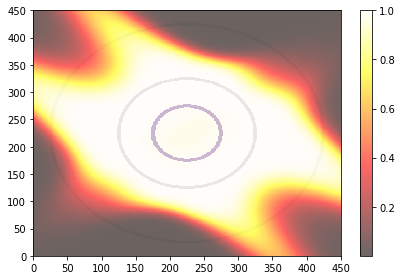

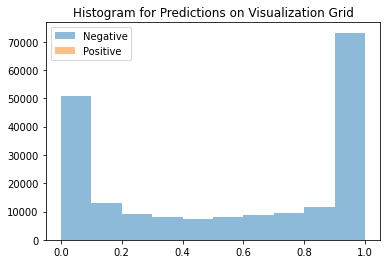

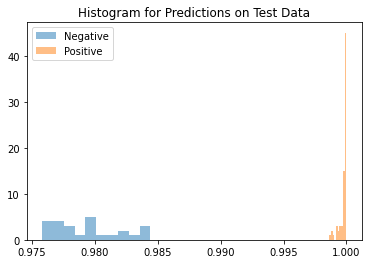

Average Difference between Positive and Negative Class: 0.0203477144241333


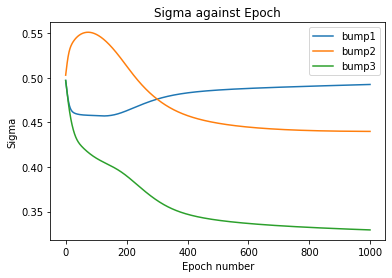

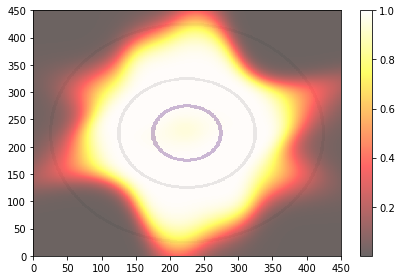

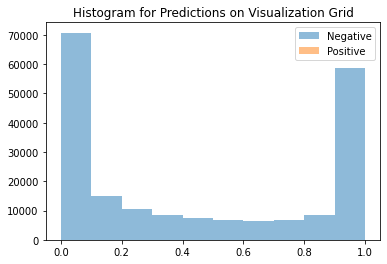

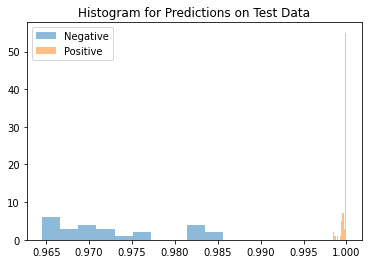

Average Difference between Positive and Negative Class: 0.02718806266784668


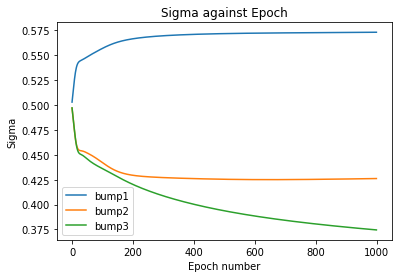

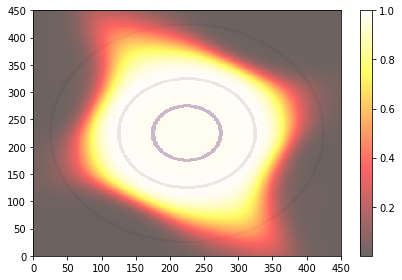

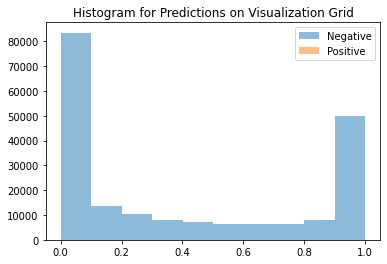

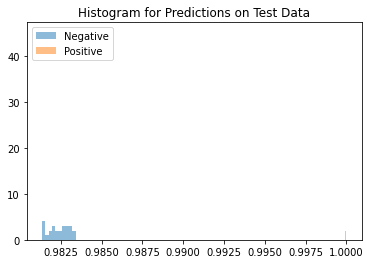

Average Difference between Positive and Negative Class: 0.017598867416381836


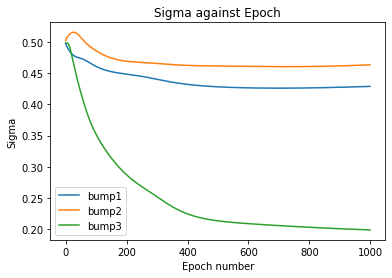

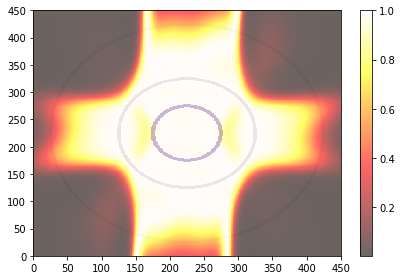

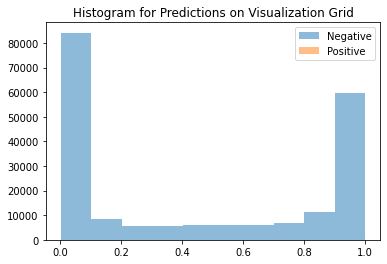

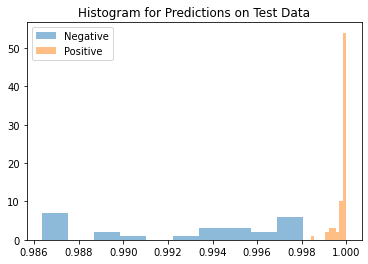

Average Difference between Positive and Negative Class: 0.0071503520011901855


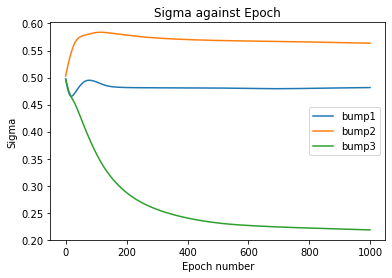

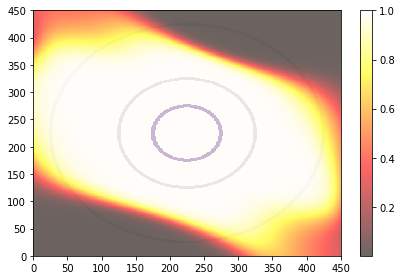

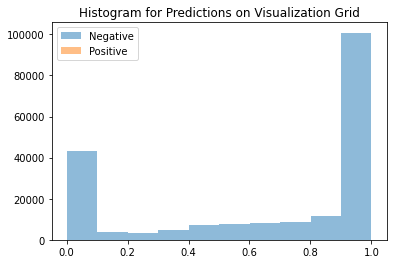

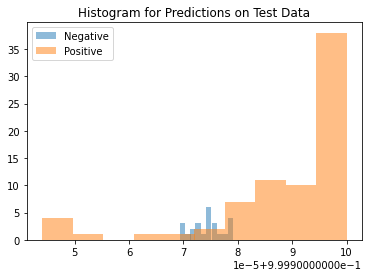

Average Difference between Positive and Negative Class: 1.4722347259521484e-05


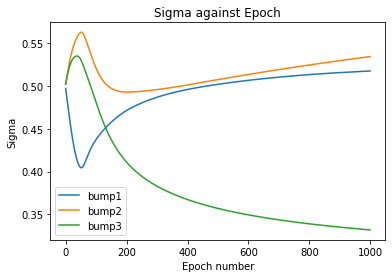

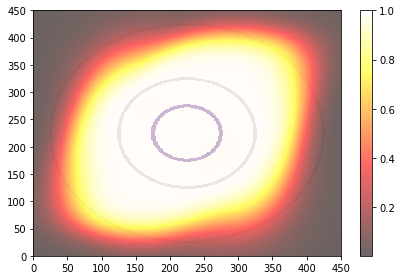

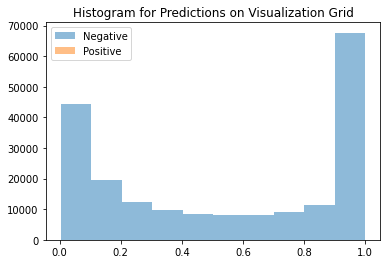

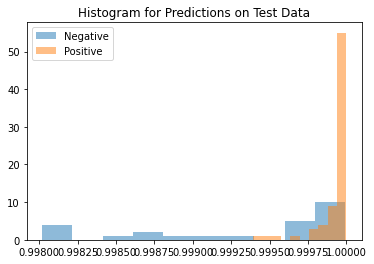

Average Difference between Positive and Negative Class: 0.0006117820739746094


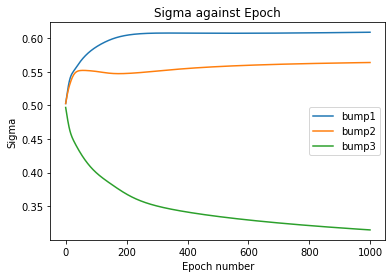

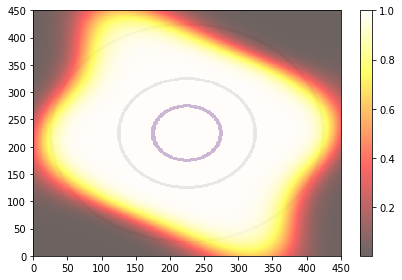

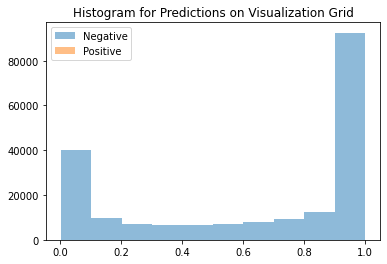

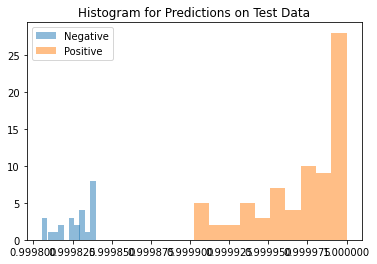

Average Difference between Positive and Negative Class: 0.00014388561248779297


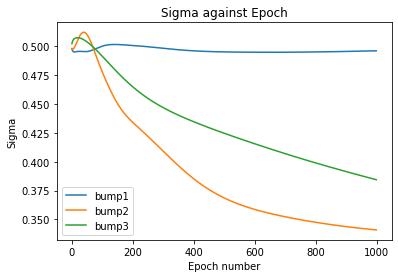

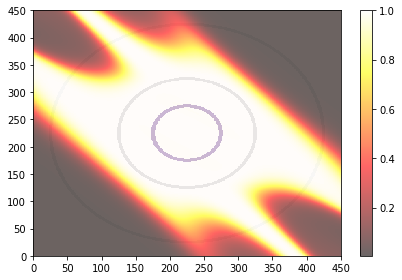

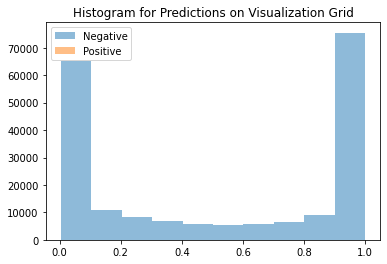

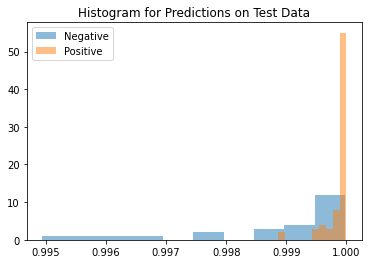

Average Difference between Positive and Negative Class: 0.0011155009269714355


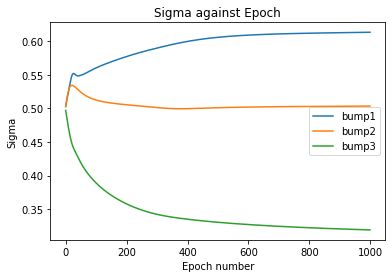

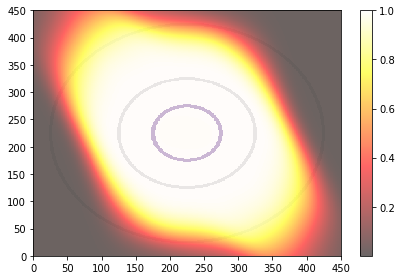

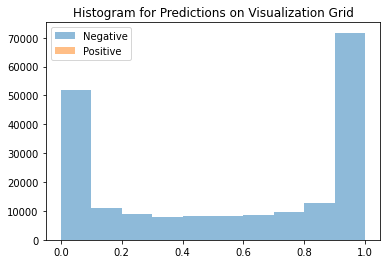

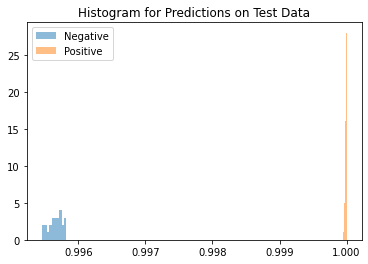

Average Difference between Positive and Negative Class: 0.004330694675445557


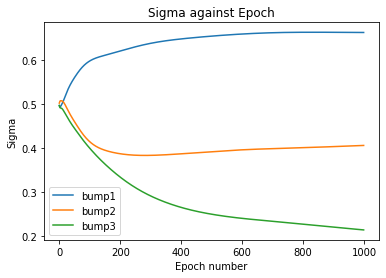

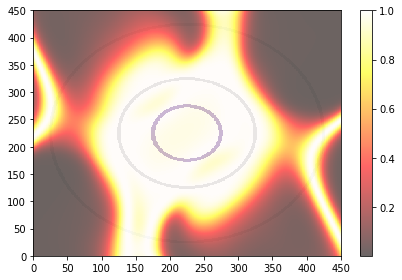

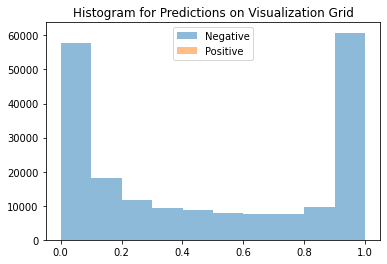

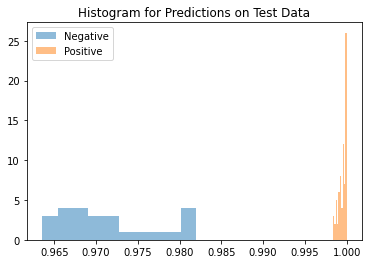

Average Difference between Positive and Negative Class: 0.02821338176727295


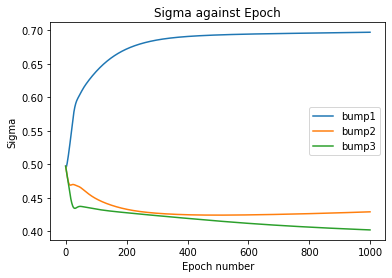

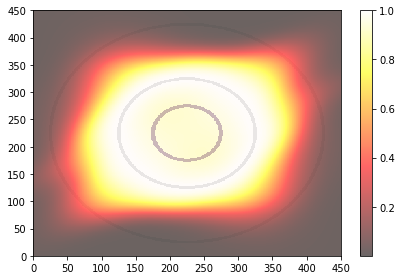

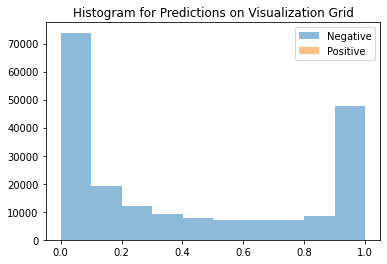

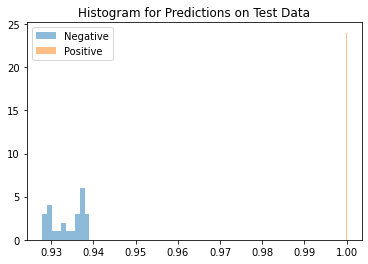

Average Difference between Positive and Negative Class: 0.0659632682800293


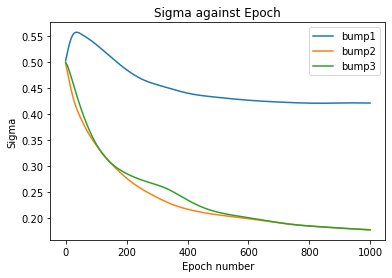

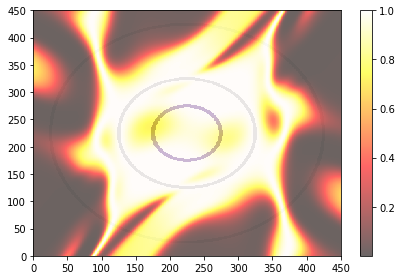

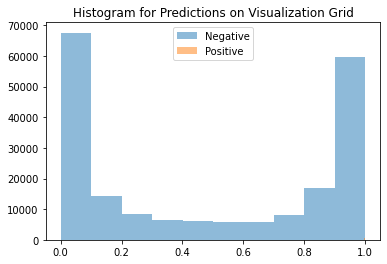

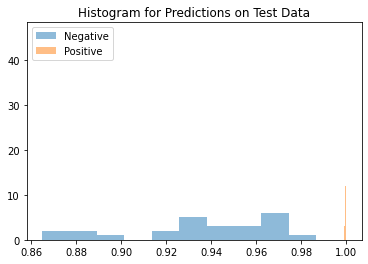

Average Difference between Positive and Negative Class: 0.06365692615509033


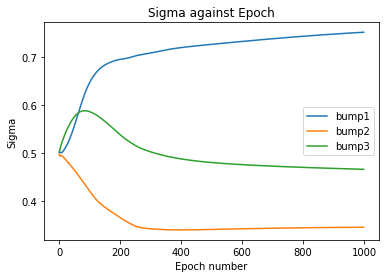

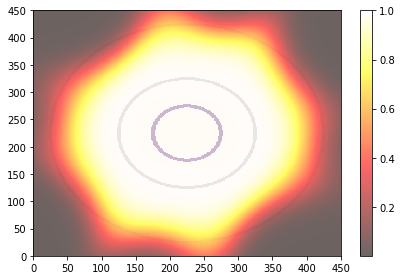

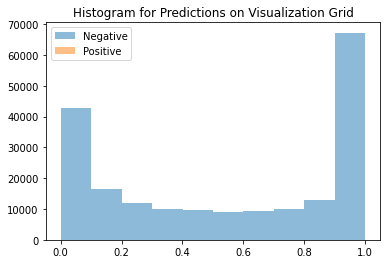

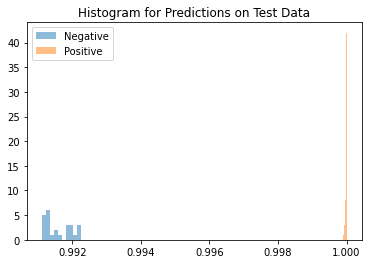

Average Difference between Positive and Negative Class: 0.00838857889175415


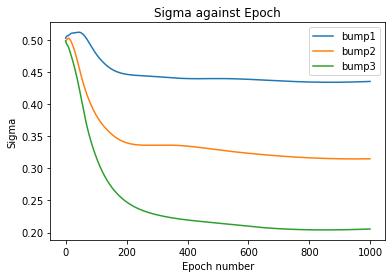

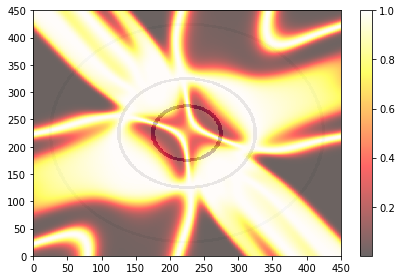

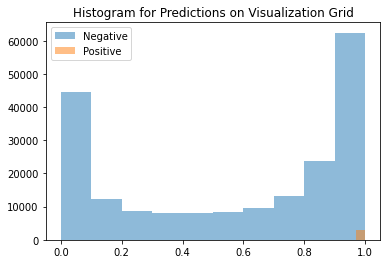

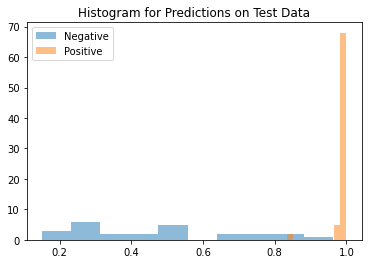

Average Difference between Positive and Negative Class: 0.5153098106384277


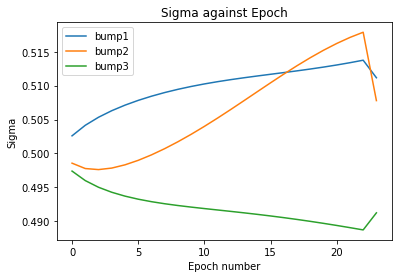

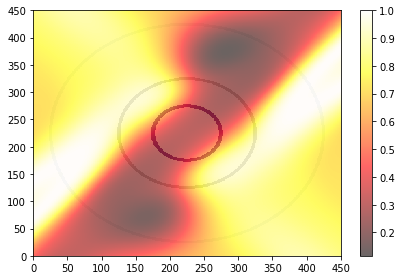

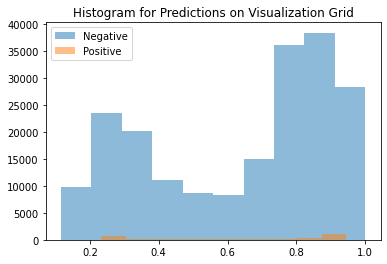

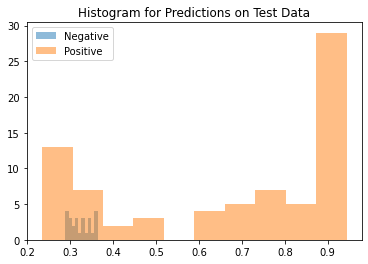

Average Difference between Positive and Negative Class: 0.34853342175483704


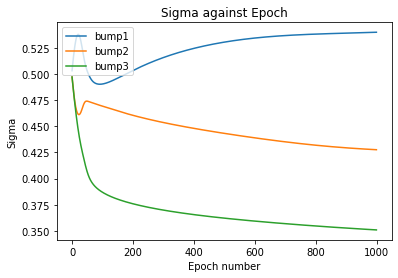

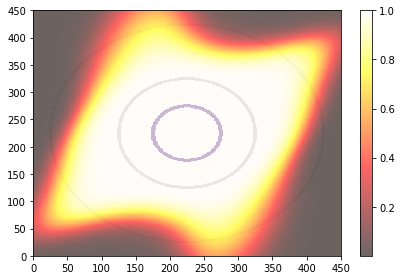

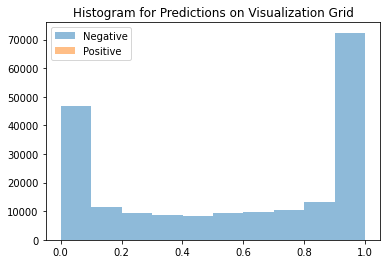

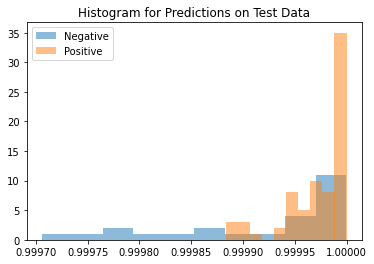

Average Difference between Positive and Negative Class: 5.3822994232177734e-05


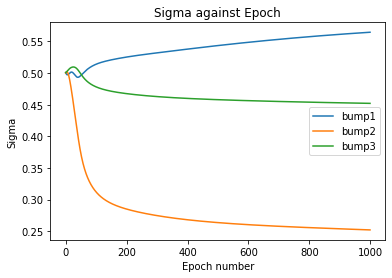

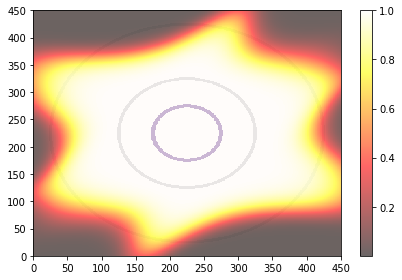

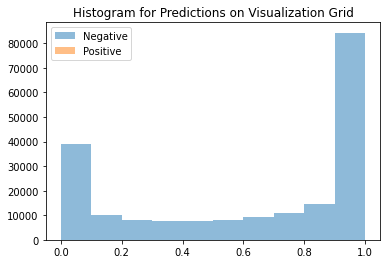

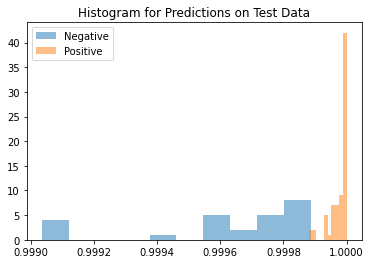

Average Difference between Positive and Negative Class: 0.00035303831100463867
AUPR (Train): 0.9886731109388143+-0.04937276476240523
AUPR (Test): 0.977242562940923+-0.038917626349361134
Average Distance between Means: 0.06045881658792496+-0.12842349708080292


([1.0,
  0.9999999999999998,
  1.0,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999998,
  1.0,
  0.9999999999999999,
  1.0,
  1.0,
  0.9999999999999998,
  0.9999999999999999,
  0.7734622187762837,
  0.9999999999999999,
  0.9999999999999999],
 [0.8973191307333568,
  1.0,
  0.9636717584842139,
  1.0,
  0.9999999999999998,
  0.9999999999999999,
  1.0,
  0.9725650655885112,
  0.9561905936599235,
  0.9999999999999999,
  0.9597864470073907,
  1.0000000000000002,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9991306331095804,
  0.941844769206694,
  0.8546914597984455,
  0.9996514012303485],
 [0.00029420853,
  0.058389246,
  0.041518986,
  0.020347714,
  0.027188063,
  0.017598867,
  0.007150352,
  1.4722347e-05,
  0.0006117821,
  0.00014388561,
  0.0011155009,
  0.0043306947,
  0.028213382,
  0.06596327,
  0.063656926,
  0.008388579,
  0.5153098,
  0.34853342,
  5.3822994e-05,
  0.0003530383])

In [16]:
# ES3b with BCE trainable sigma=0.5
separation = "ES"
bumped = "b"
sigma = 0.5
hidden_layers = 3
train = True     # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='binary_crossentropy',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, hidden_layers=hidden_layers, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

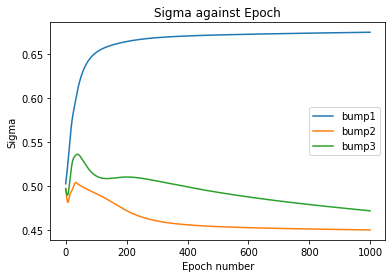

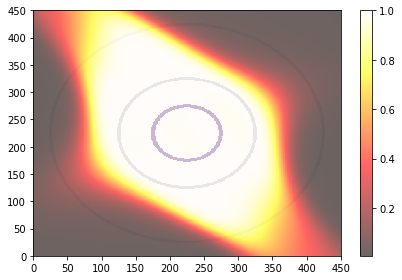

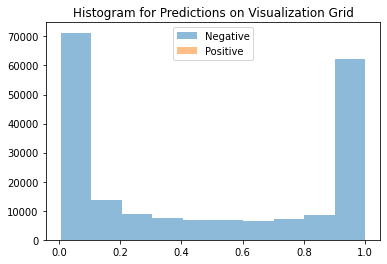

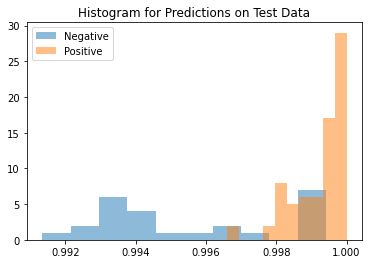

Average Difference between Positive and Negative Class: 0.003671586513519287


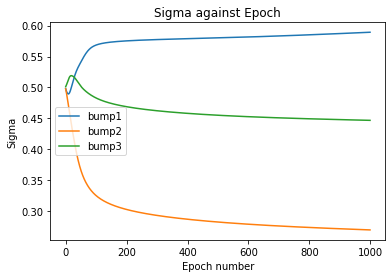

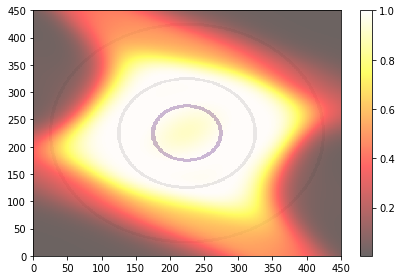

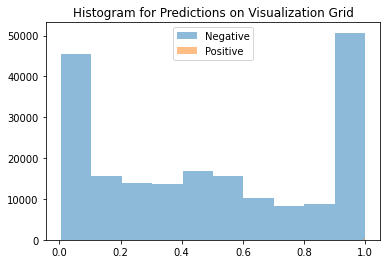

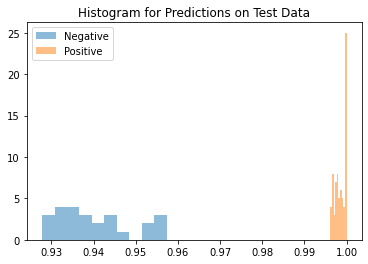

Average Difference between Positive and Negative Class: 0.05833792686462402


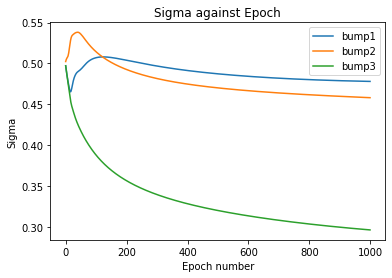

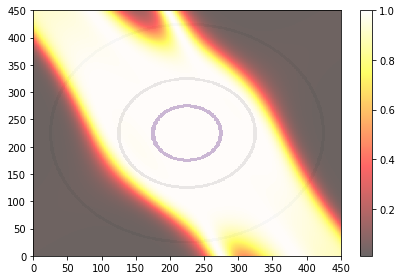

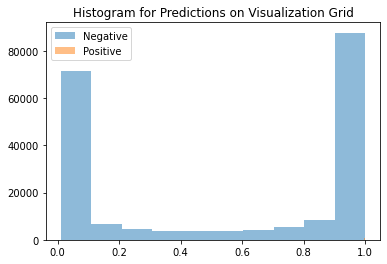

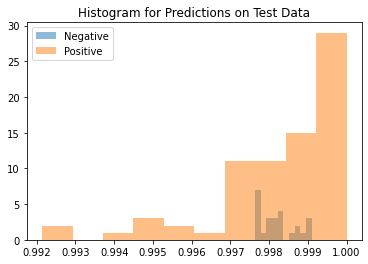

Average Difference between Positive and Negative Class: 0.00011688470840454102


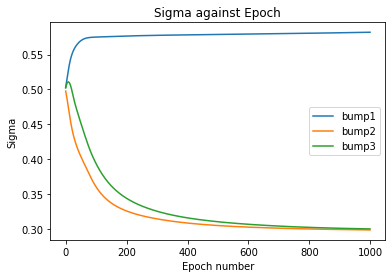

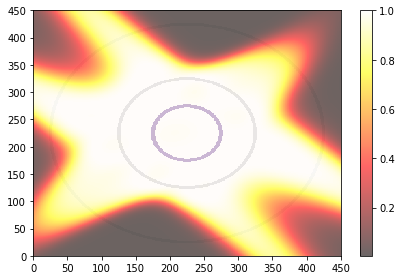

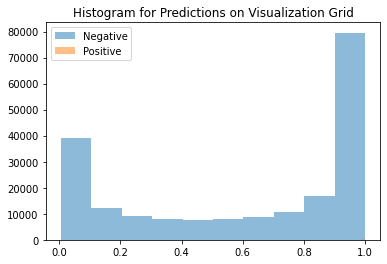

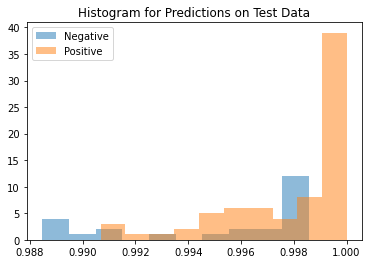

Average Difference between Positive and Negative Class: 0.0028108954429626465


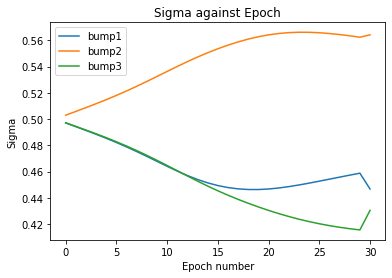

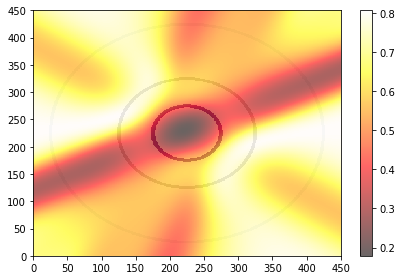

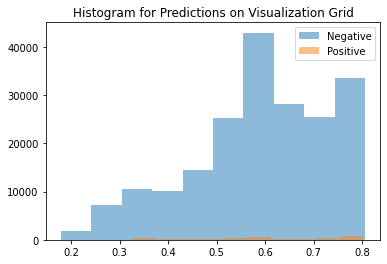

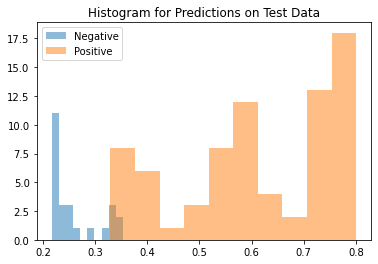

Average Difference between Positive and Negative Class: 0.3537704348564148


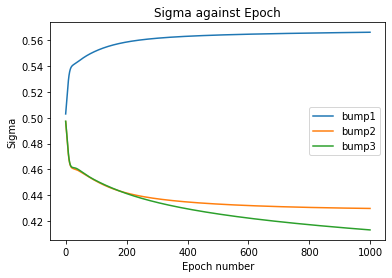

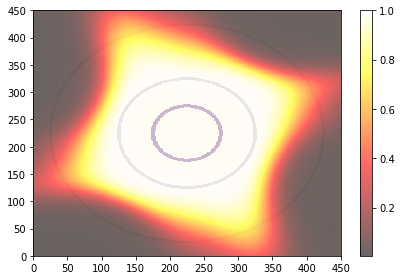

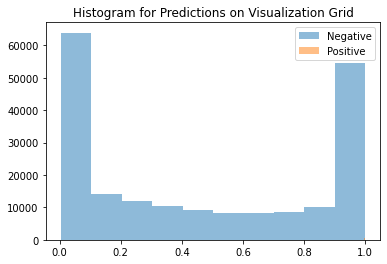

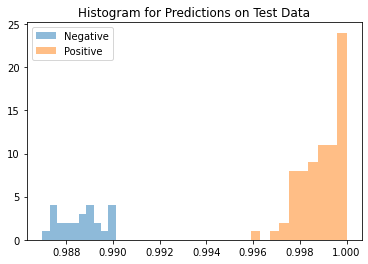

Average Difference between Positive and Negative Class: 0.01031637191772461


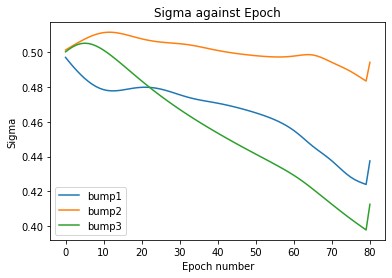

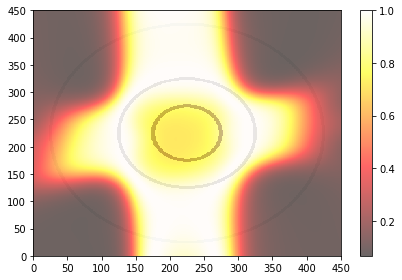

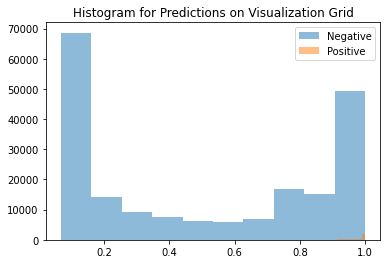

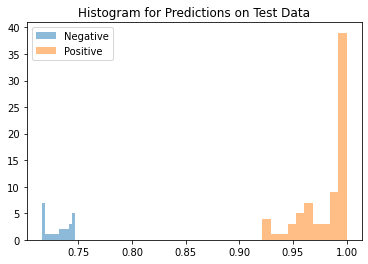

Average Difference between Positive and Negative Class: 0.2498074769973755


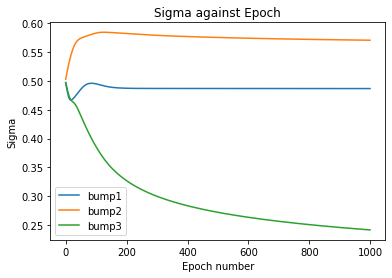

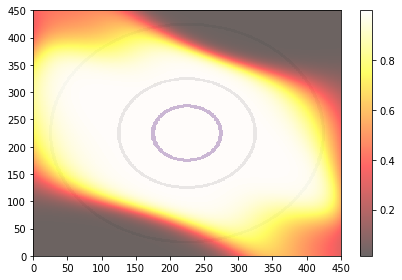

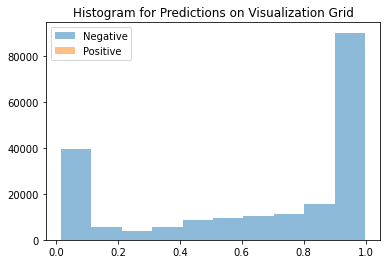

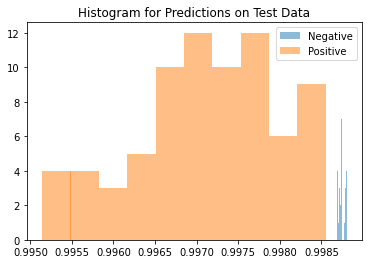

Average Difference between Positive and Negative Class: -0.0016384124755859375


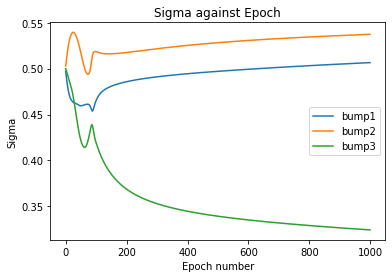

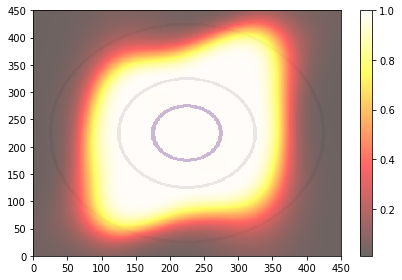

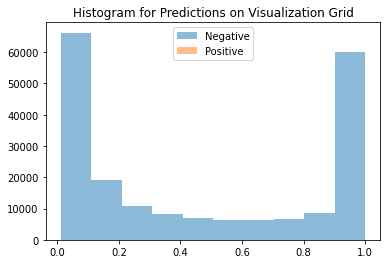

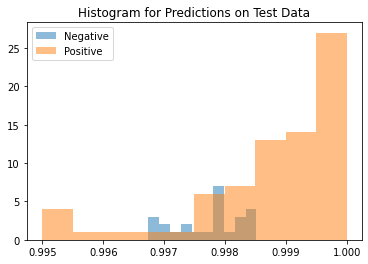

Average Difference between Positive and Negative Class: 0.0010439753532409668


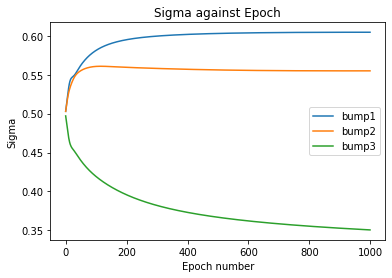

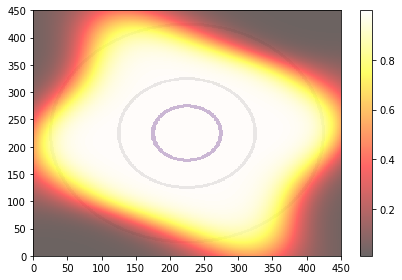

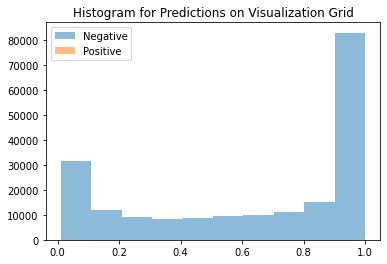

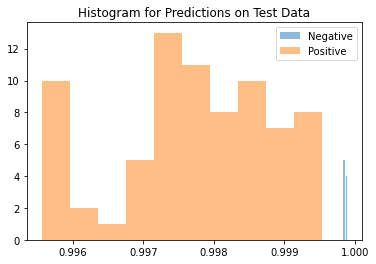

Average Difference between Positive and Negative Class: -0.0021238327026367188


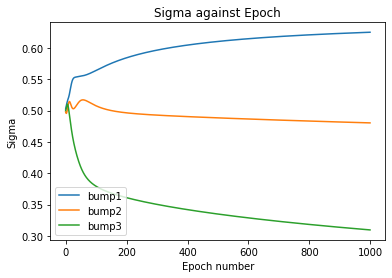

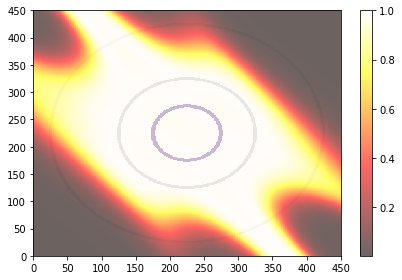

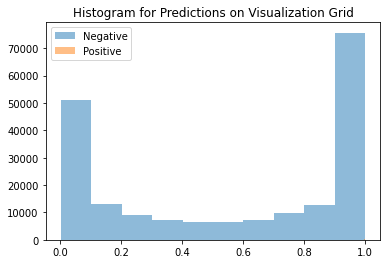

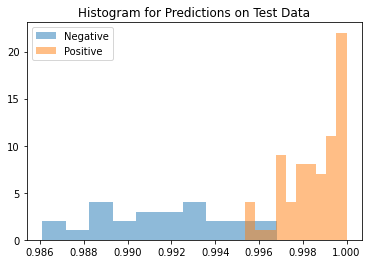

Average Difference between Positive and Negative Class: 0.007138729095458984


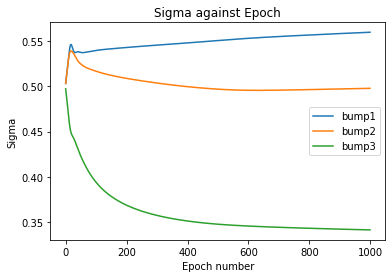

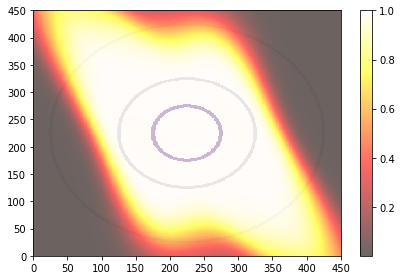

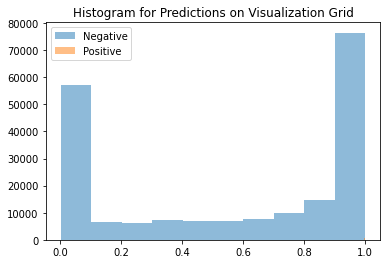

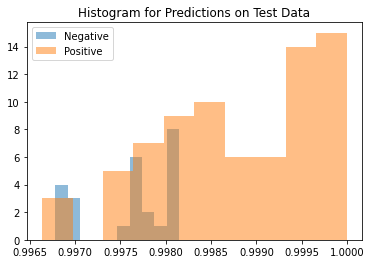

Average Difference between Positive and Negative Class: 0.0012205839157104492


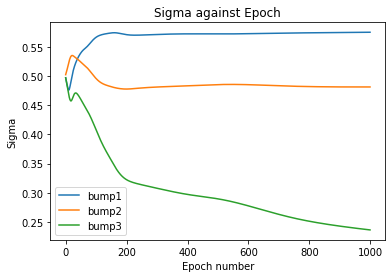

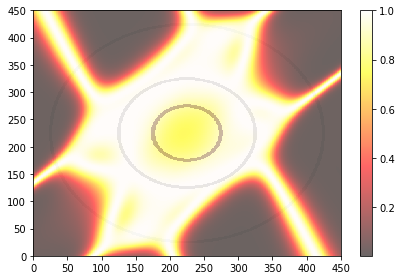

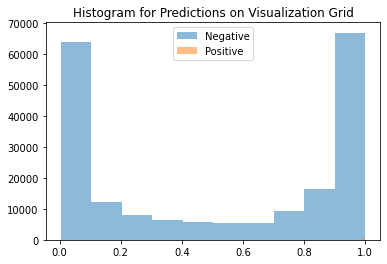

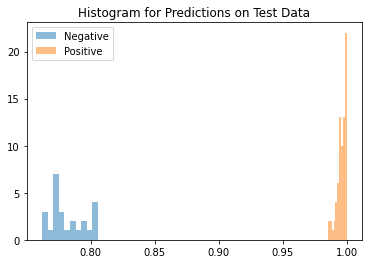

Average Difference between Positive and Negative Class: 0.21379375457763672


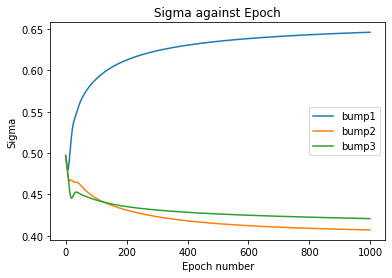

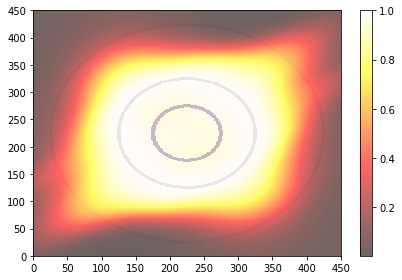

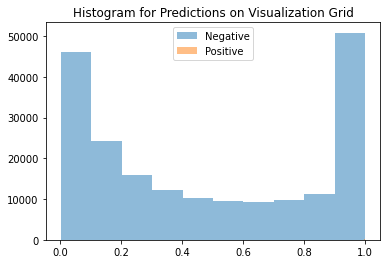

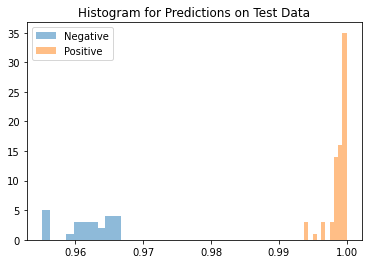

Average Difference between Positive and Negative Class: 0.037047624588012695


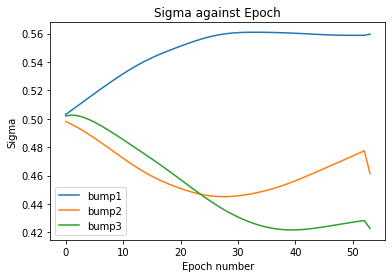

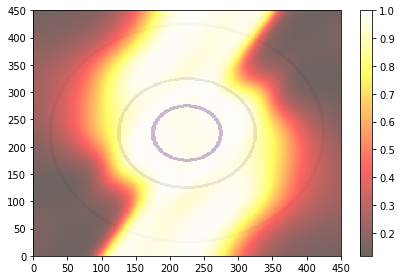

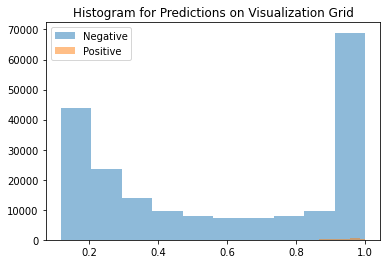

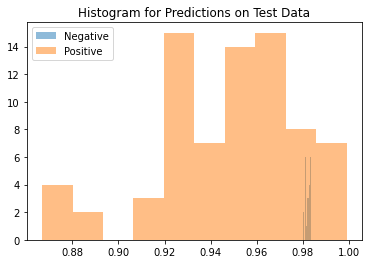

Average Difference between Positive and Negative Class: -0.03465229272842407


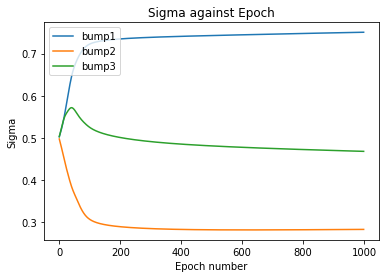

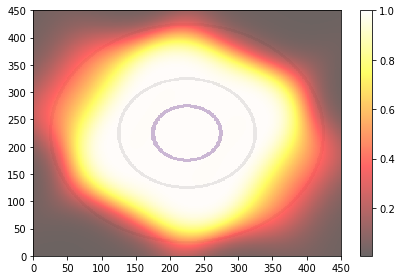

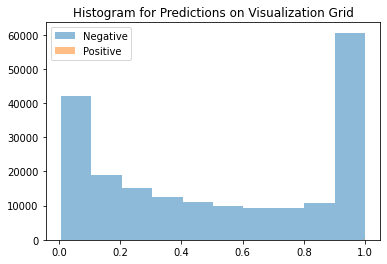

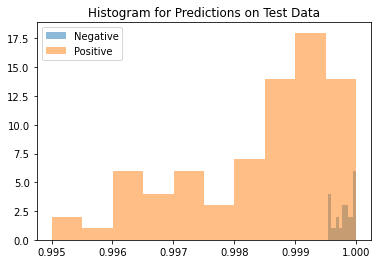

Average Difference between Positive and Negative Class: -0.0013465285301208496


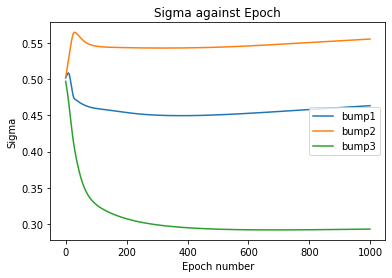

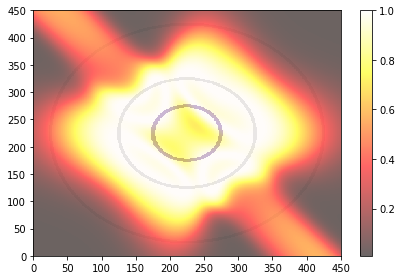

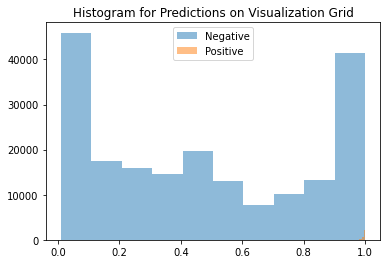

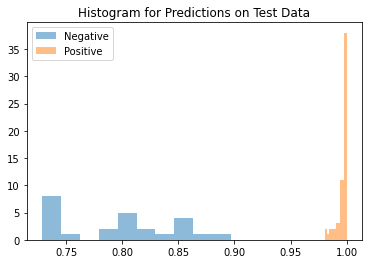

Average Difference between Positive and Negative Class: 0.20034855604171753


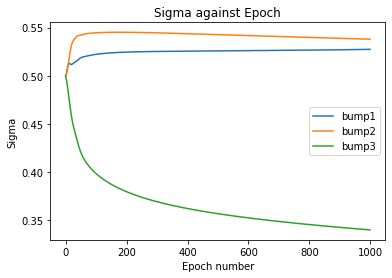

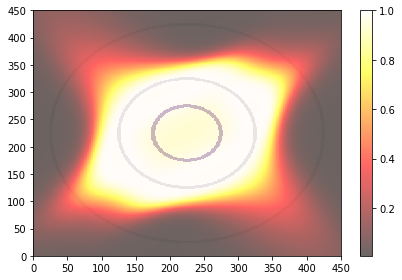

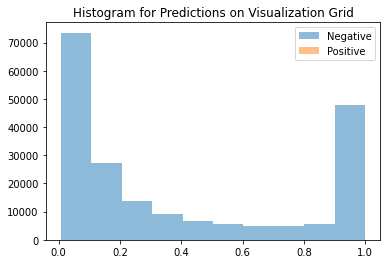

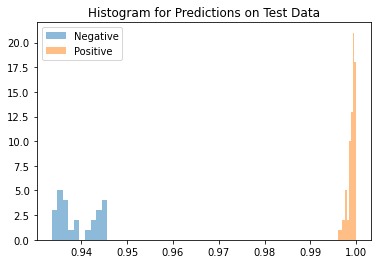

Average Difference between Positive and Negative Class: 0.05980479717254639


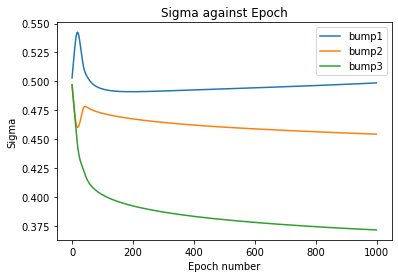

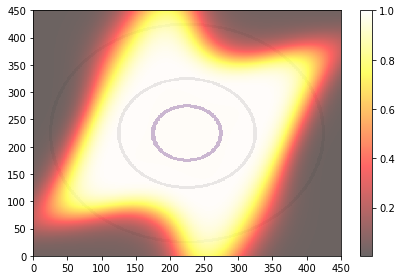

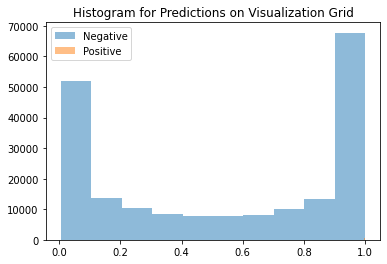

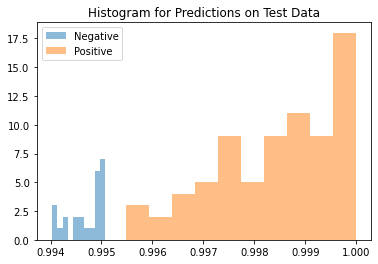

Average Difference between Positive and Negative Class: 0.00376814603805542


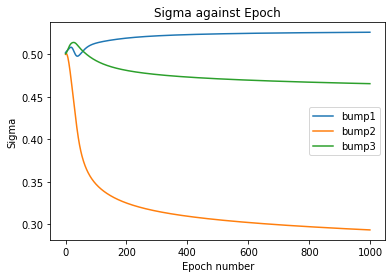

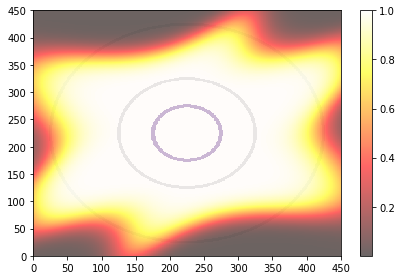

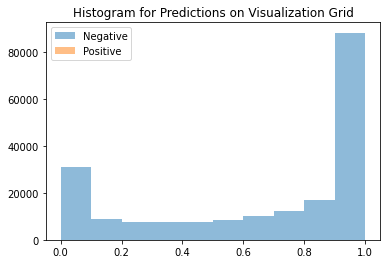

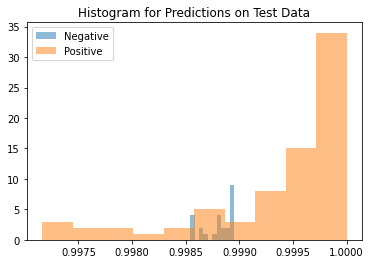

Average Difference between Positive and Negative Class: 0.0005827546119689941
AUPR (Train): 0.9788882257812217+-0.07342959738137536
AUPR (Test): 0.8954812970692722+-0.16484529545042978
Average Distance between Means: 0.0581909641623497+-0.10378799587488174


([0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.6713857610300209,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9063787545944157,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999],
 [0.9594170700262428,
  0.9999999999999999,
  0.8832181186688898,
  0.9185976310482338,
  0.9977397130838926,
  1.0,
  0.9999999999999999,
  0.5378602200379622,
  0.9485995887219638,
  0.5378602200379622,
  0.9976926740709013,
  0.9626829173057867,
  0.9999999999999999,
  0.9999999999999999,
  0.6210412793114879,
  0.5968169576759759,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.948099551396143],
 [0.0036715865,
  0.058337927,
  0.00011688471,
  0.0028108954,
  0.35377043,
  0.010316372,
  0.24980748,
  -0.0016384125,
  0.0010439754,
  -0.0021238327,
  0.007

In [17]:
# ES3b with MSE trainable sigma=0.5
separation = "ES"
bumped = "b"
sigma = 0.5
hidden_layers = 3
train = True     # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='mse',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, hidden_layers=hidden_layers, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

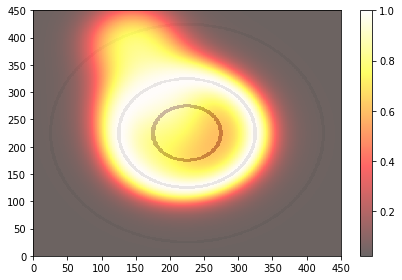

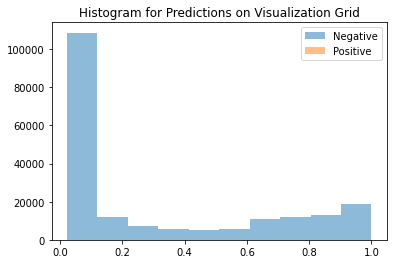

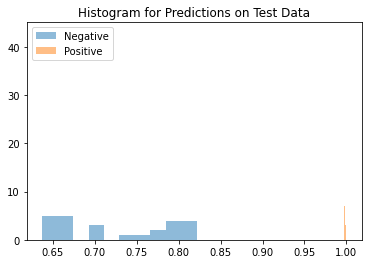

Average Difference between Positive and Negative Class: 0.2749600410461426


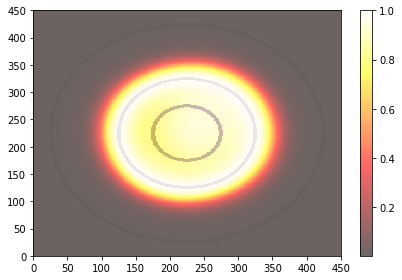

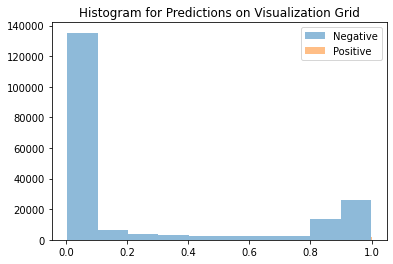

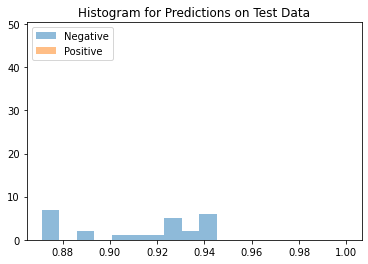

Average Difference between Positive and Negative Class: 0.08824121952056885


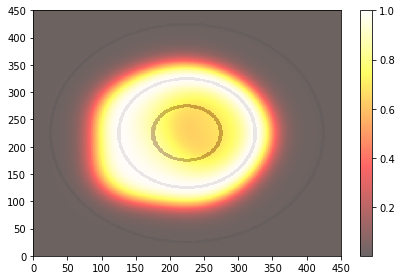

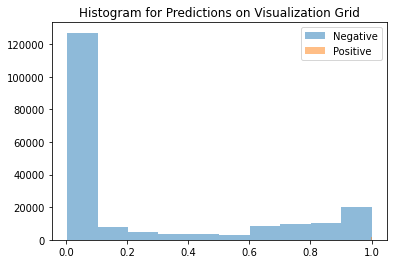

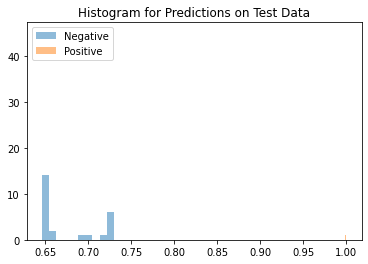

Average Difference between Positive and Negative Class: 0.32380735874176025


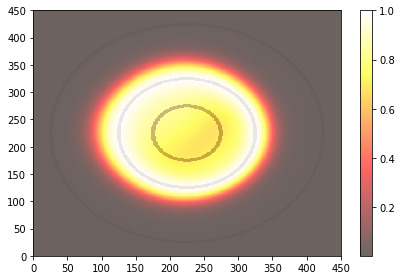

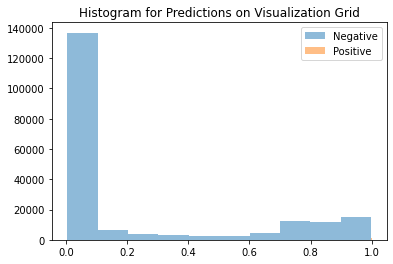

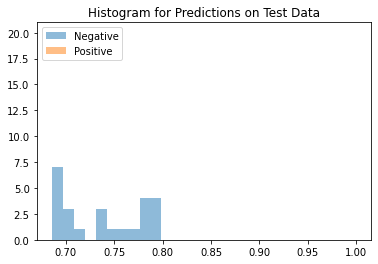

Average Difference between Positive and Negative Class: 0.26272261142730713


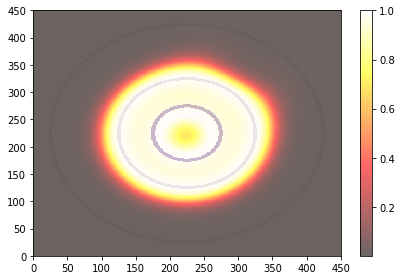

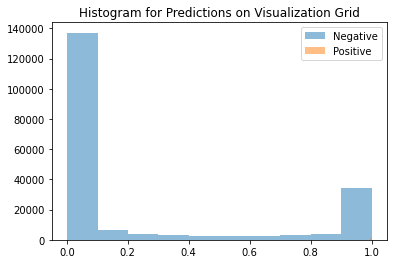

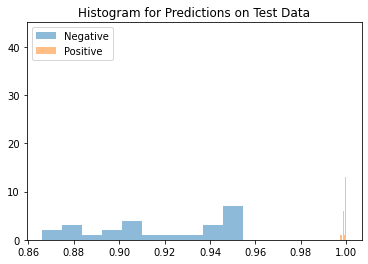

Average Difference between Positive and Negative Class: 0.08255875110626221


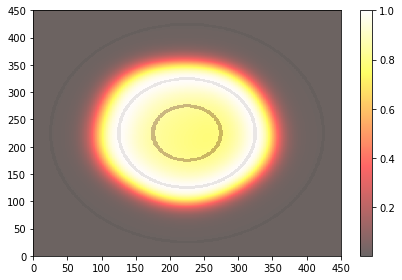

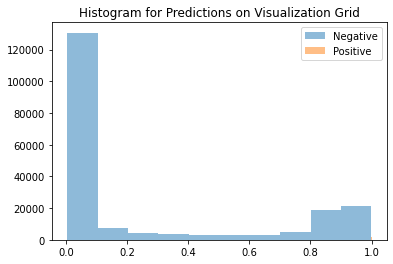

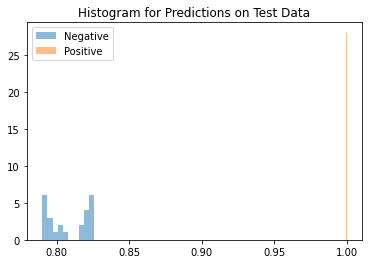

Average Difference between Positive and Negative Class: 0.19173216819763184


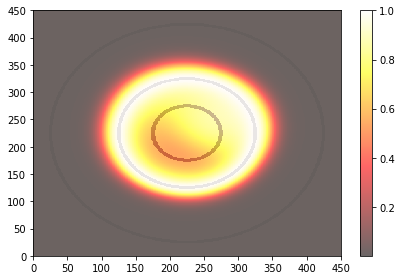

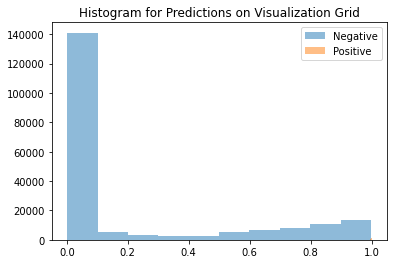

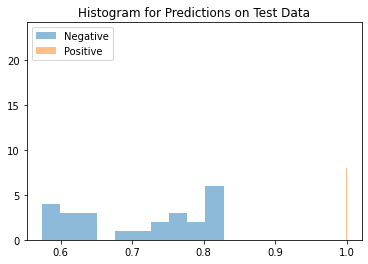

Average Difference between Positive and Negative Class: 0.2889672517776489


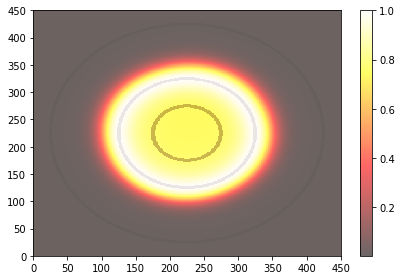

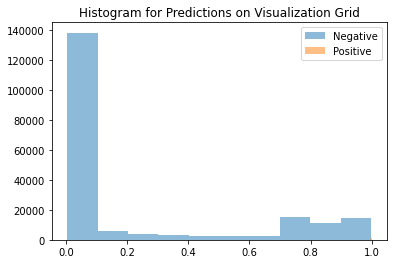

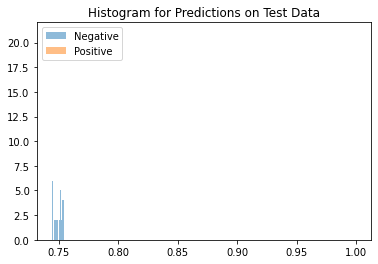

Average Difference between Positive and Negative Class: 0.25058257579803467


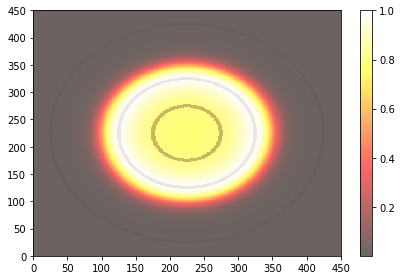

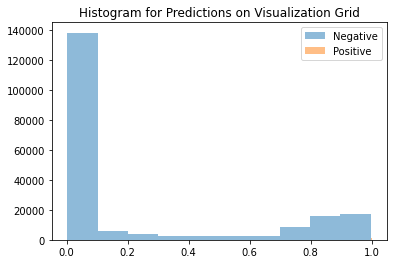

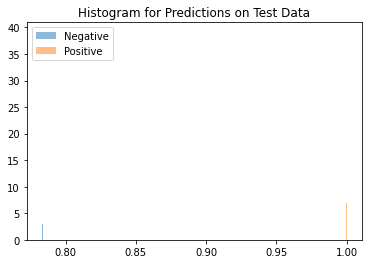

Average Difference between Positive and Negative Class: 0.21630656719207764


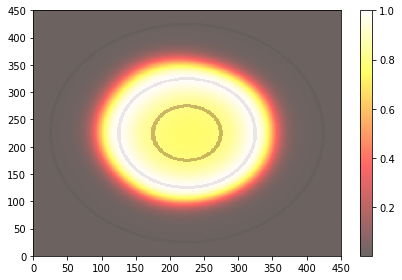

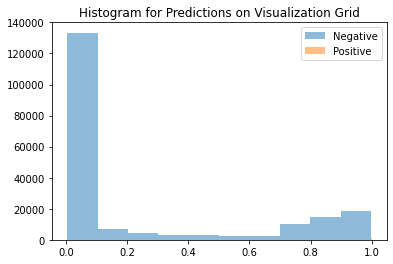

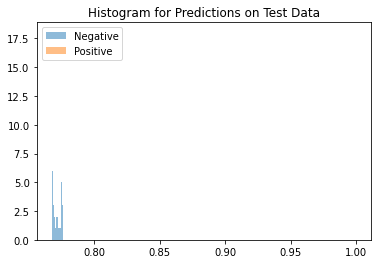

Average Difference between Positive and Negative Class: 0.2280193567276001


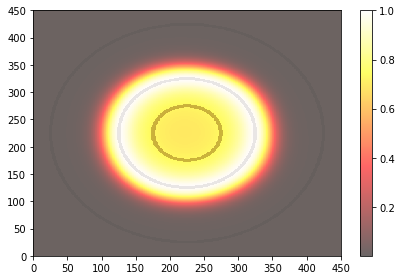

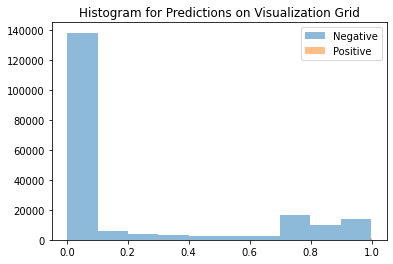

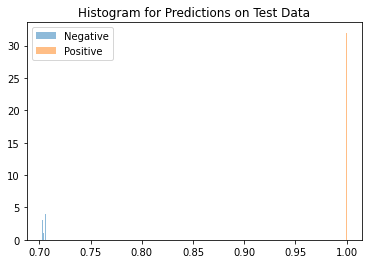

Average Difference between Positive and Negative Class: 0.29511159658432007


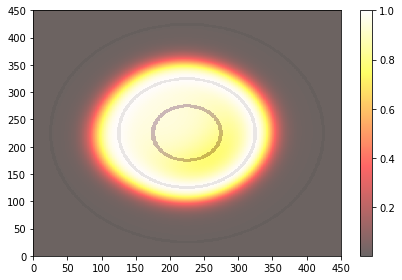

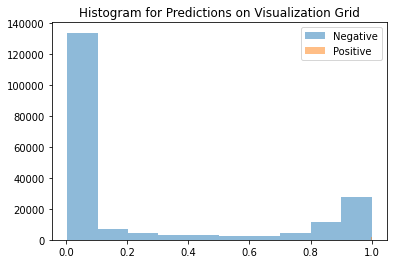

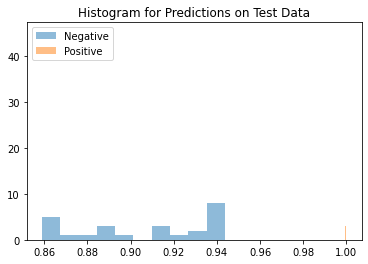

Average Difference between Positive and Negative Class: 0.09300357103347778


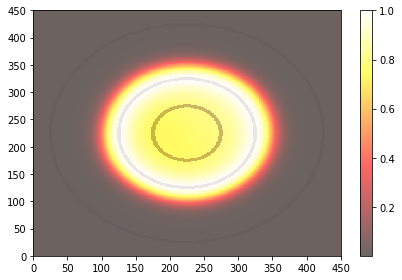

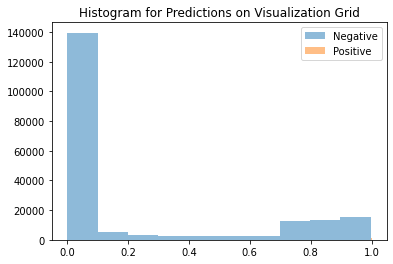

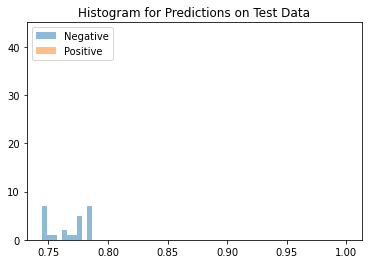

Average Difference between Positive and Negative Class: 0.23290324211120605


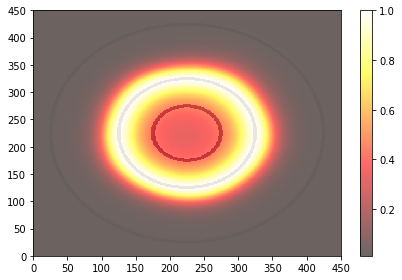

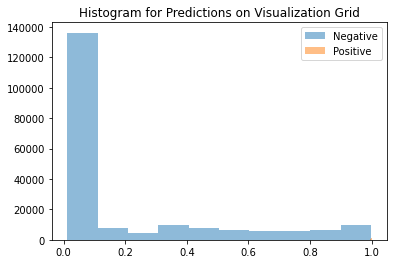

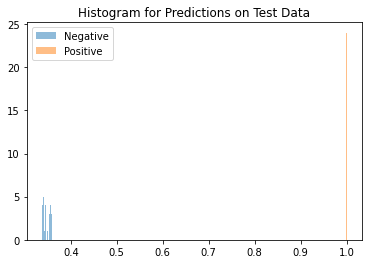

Average Difference between Positive and Negative Class: 0.6525552868843079


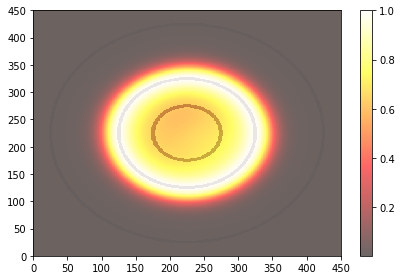

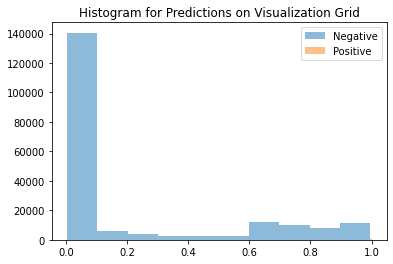

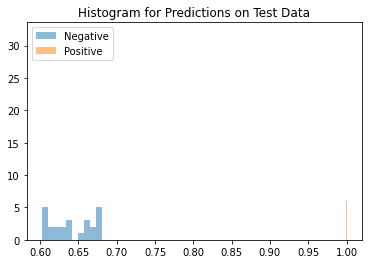

Average Difference between Positive and Negative Class: 0.3582450747489929


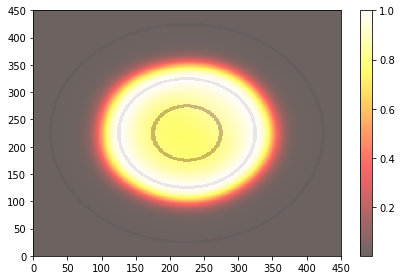

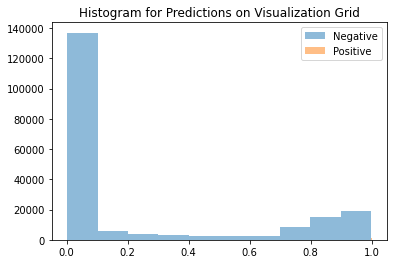

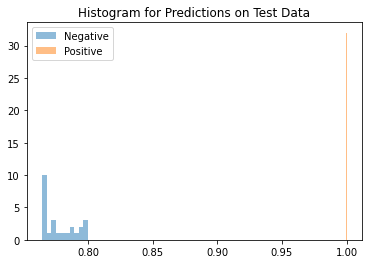

Average Difference between Positive and Negative Class: 0.22202813625335693


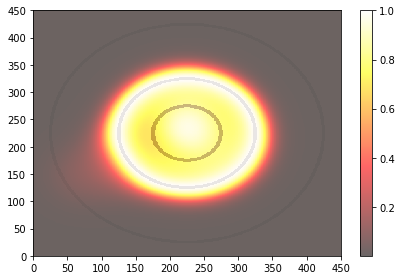

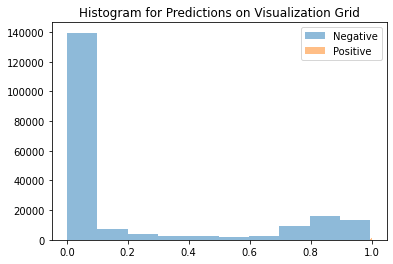

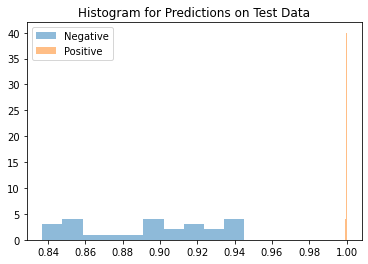

Average Difference between Positive and Negative Class: 0.10640525817871094


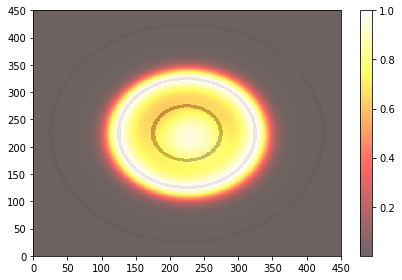

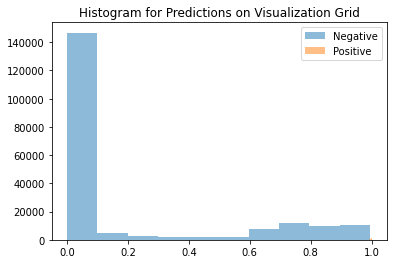

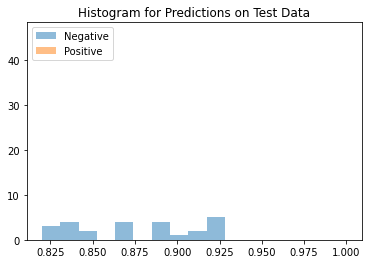

Average Difference between Positive and Negative Class: 0.12451547384262085


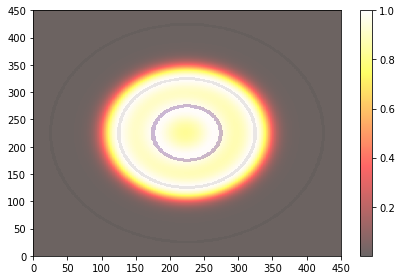

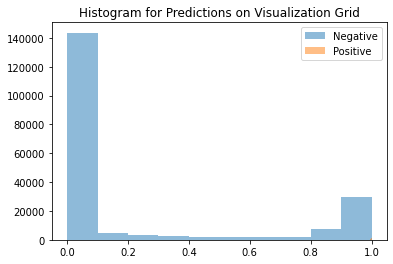

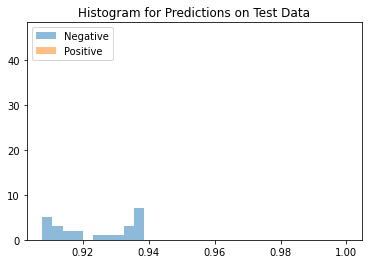

Average Difference between Positive and Negative Class: 0.0761600136756897


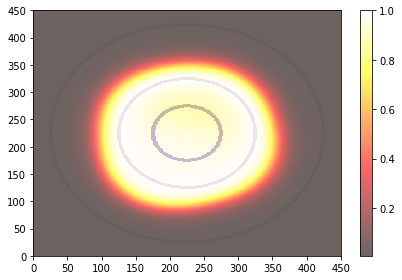

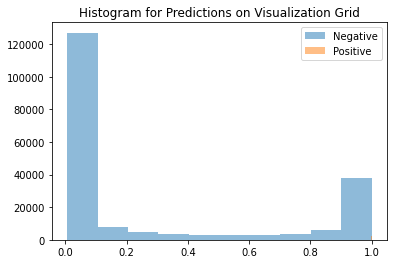

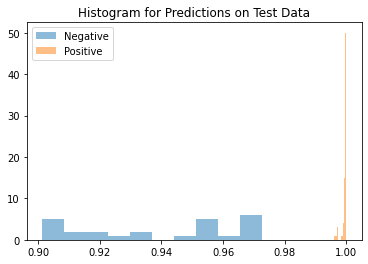

Average Difference between Positive and Negative Class: 0.06021147966384888
AUPR (Train): 1.0+-7.447602459741819e-17
AUPR (Test): 1.0+-8.233634315563857e-17
Average Distance between Means: 0.22145184874534607+-0.13319131731987


([1.0,
  0.9999999999999999,
  1.0,
  1.0,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  1.0,
  1.0,
  1.0,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  1.0],
 [1.0,
  1.0,
  1.0,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  1.0,
  1.0,
  0.9999999999999999,
  0.9999999999999998,
  1.0,
  1.0,
  1.0,
  1.0,
  0.9999999999999999],
 [0.27496004,
  0.08824122,
  0.32380736,
  0.2627226,
  0.08255875,
  0.19173217,
  0.28896725,
  0.25058258,
  0.21630657,
  0.22801936,
  0.2951116,
  0.09300357,
  0.23290324,
  0.6525553,
  0.35824507,
  0.22202814,
  0.10640526,
  0.124515474,
  0.07616001,
  0.06021148])

In [18]:
# ES3r with BCE
separation = "ES"
bumped = "r"
sigma = 0.5
hidden_layers = 3
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='binary_crossentropy',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test, 
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

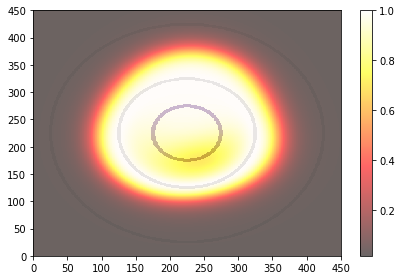

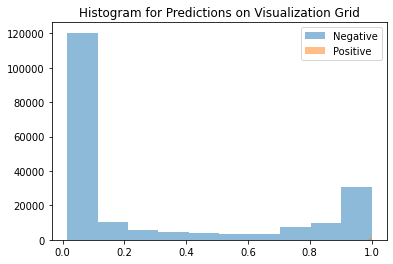

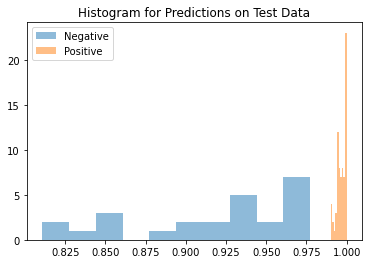

Average Difference between Positive and Negative Class: 0.08039653301239014


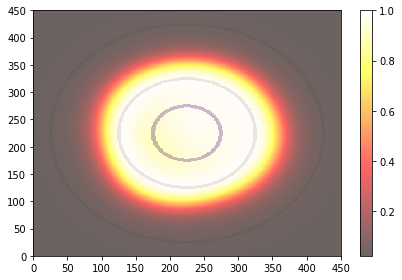

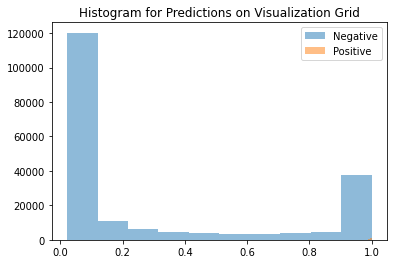

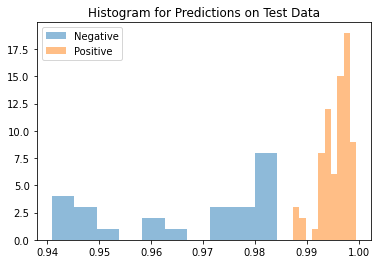

Average Difference between Positive and Negative Class: 0.028953075408935547


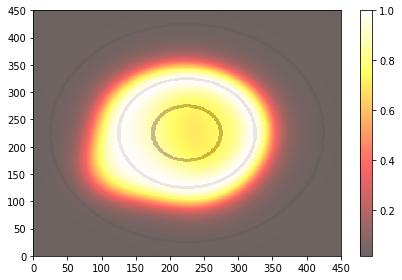

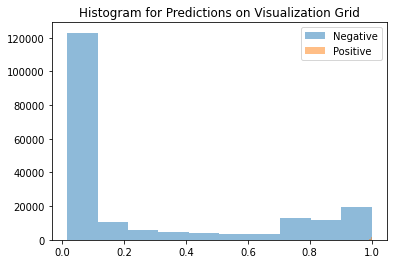

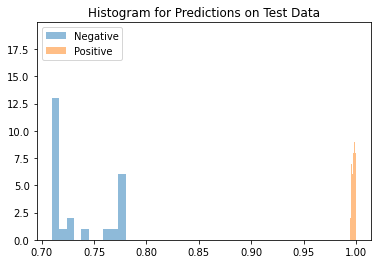

Average Difference between Positive and Negative Class: 0.26258599758148193


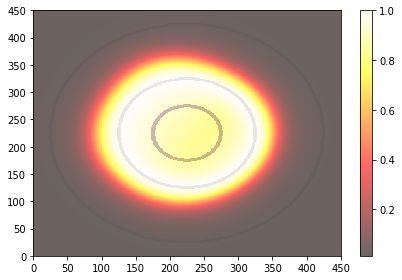

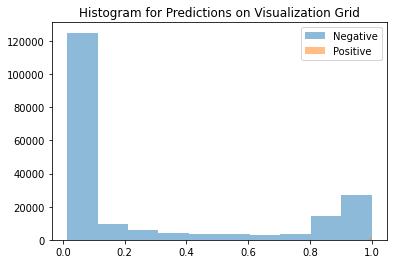

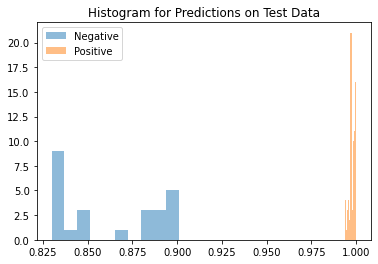

Average Difference between Positive and Negative Class: 0.1359601616859436


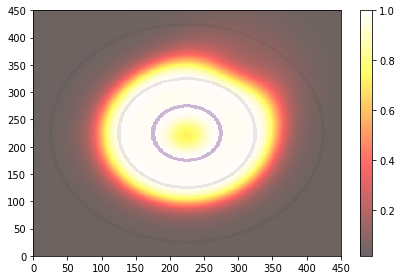

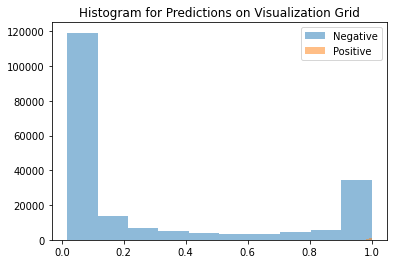

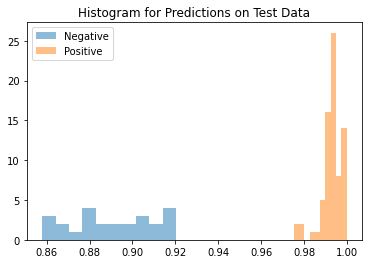

Average Difference between Positive and Negative Class: 0.10190826654434204


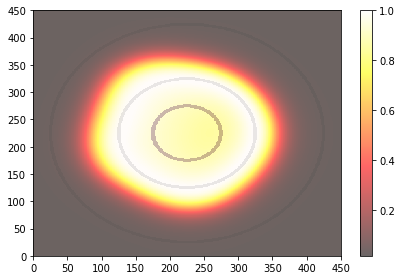

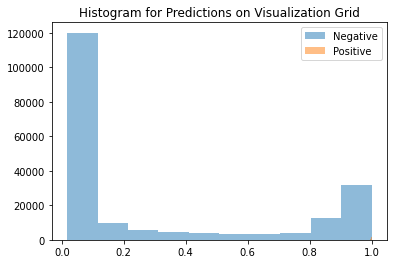

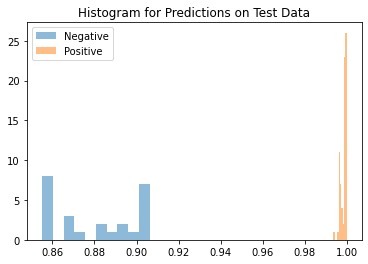

Average Difference between Positive and Negative Class: 0.11857062578201294


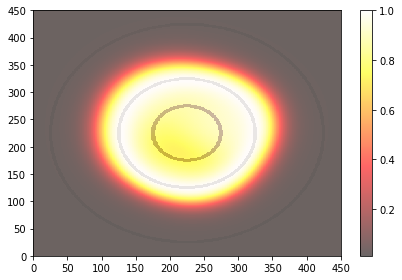

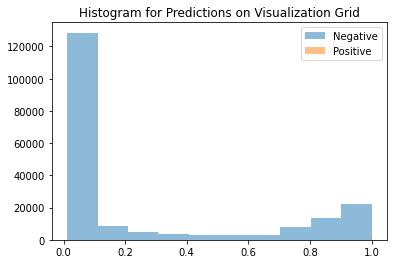

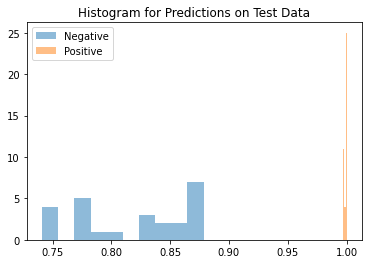

Average Difference between Positive and Negative Class: 0.18003249168395996


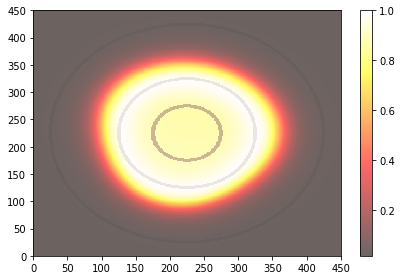

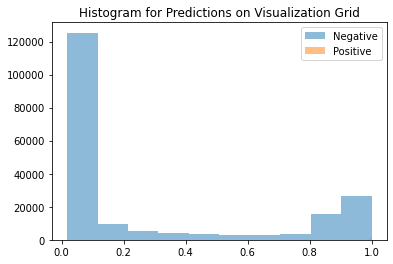

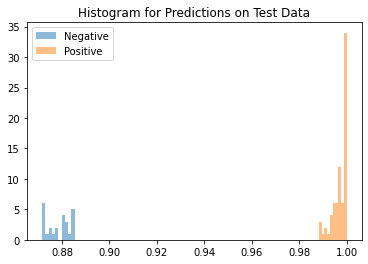

Average Difference between Positive and Negative Class: 0.11876815557479858


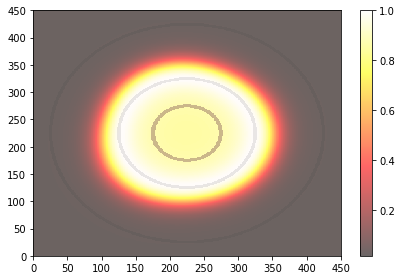

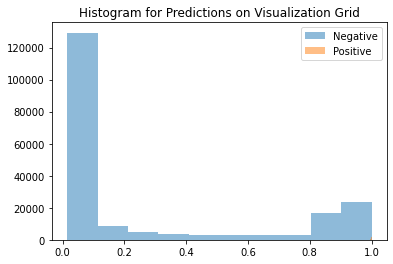

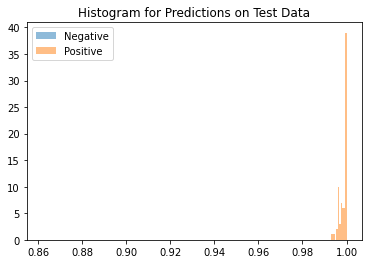

Average Difference between Positive and Negative Class: 0.136383056640625


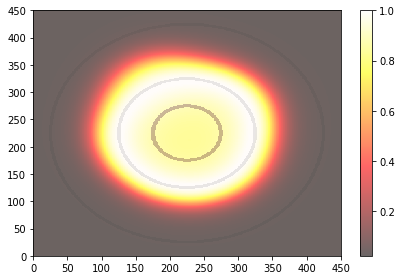

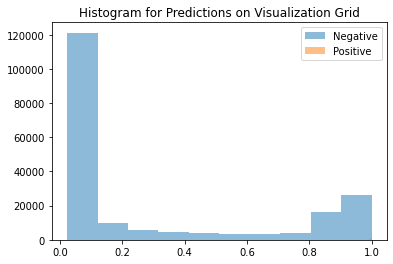

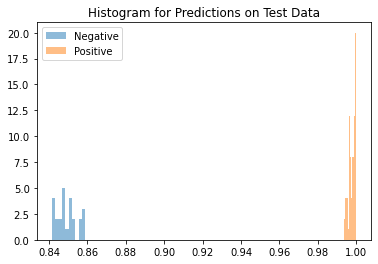

Average Difference between Positive and Negative Class: 0.14853298664093018


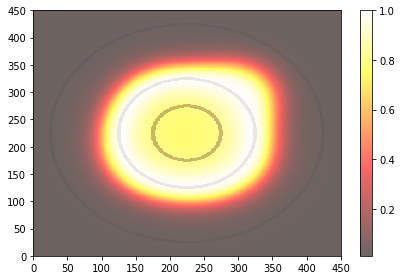

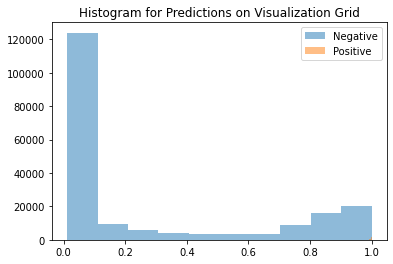

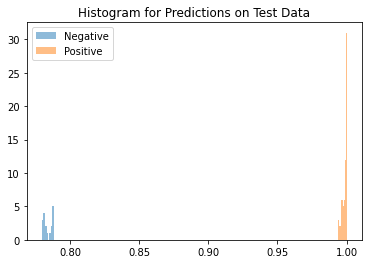

Average Difference between Positive and Negative Class: 0.2137972116470337


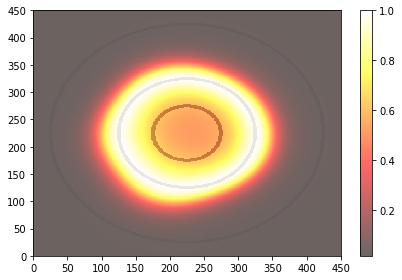

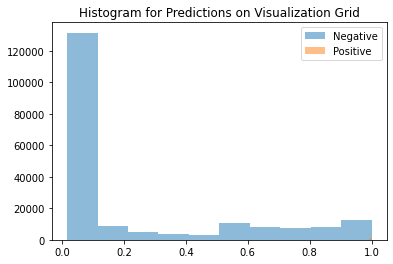

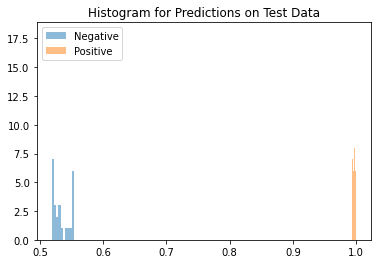

Average Difference between Positive and Negative Class: 0.46370744705200195


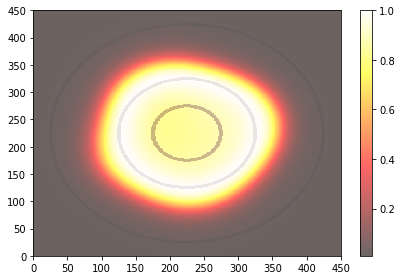

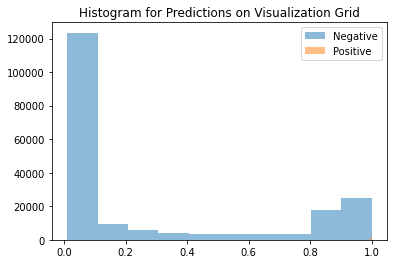

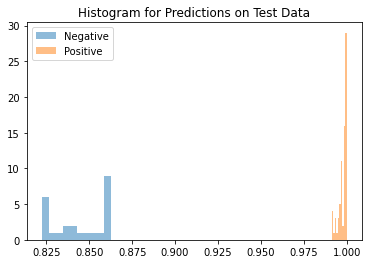

Average Difference between Positive and Negative Class: 0.15317273139953613


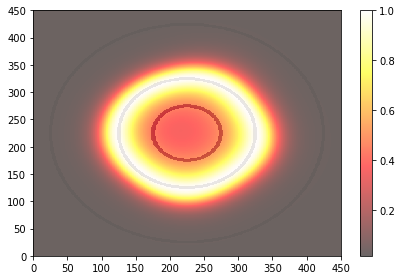

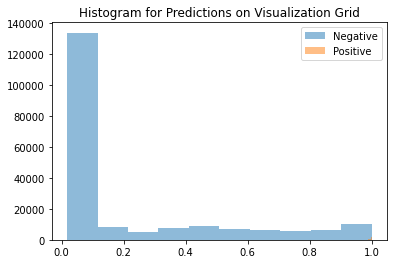

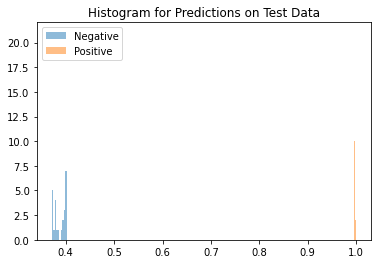

Average Difference between Positive and Negative Class: 0.6099984645843506


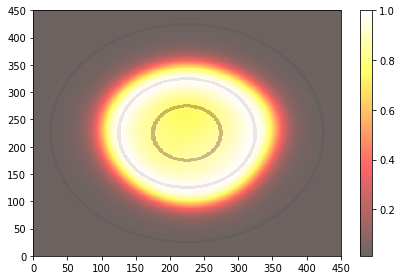

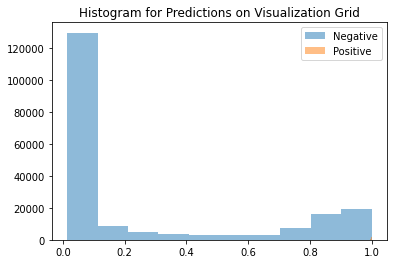

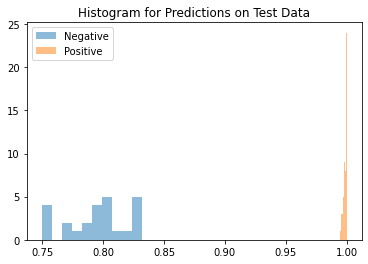

Average Difference between Positive and Negative Class: 0.20283246040344238


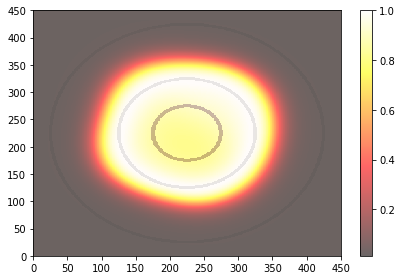

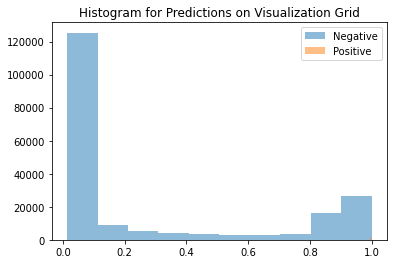

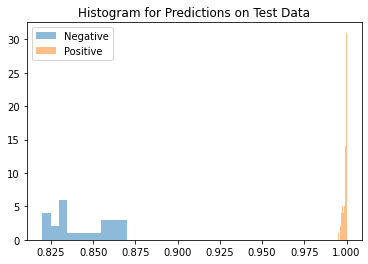

Average Difference between Positive and Negative Class: 0.15526074171066284


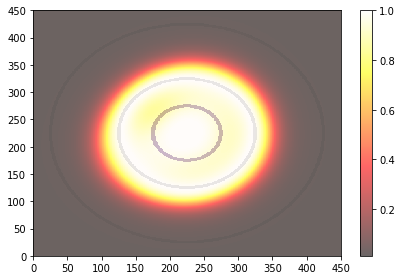

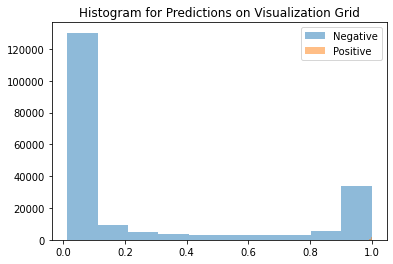

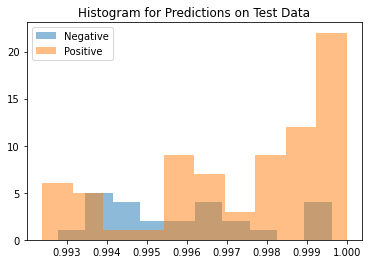

Average Difference between Positive and Negative Class: 0.0014690160751342773


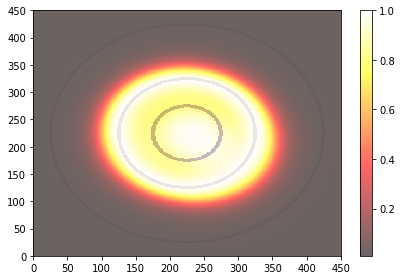

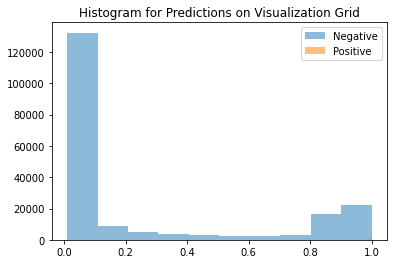

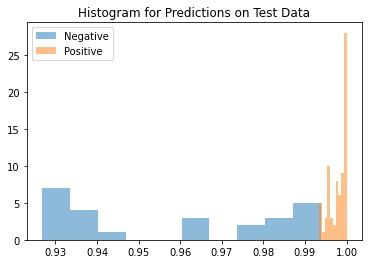

Average Difference between Positive and Negative Class: 0.03929787874221802


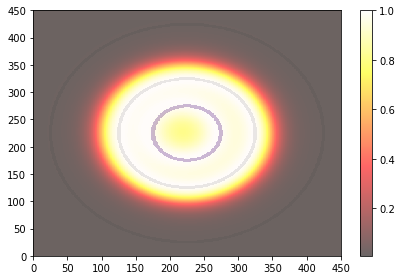

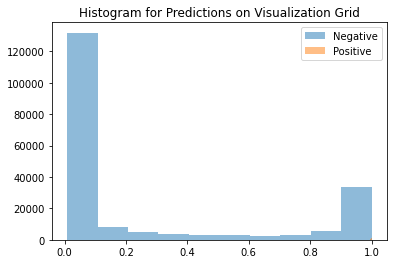

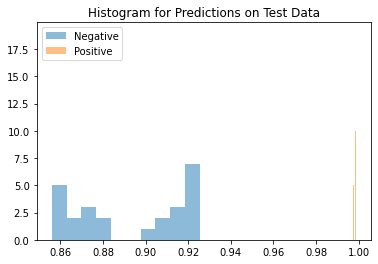

Average Difference between Positive and Negative Class: 0.10413849353790283


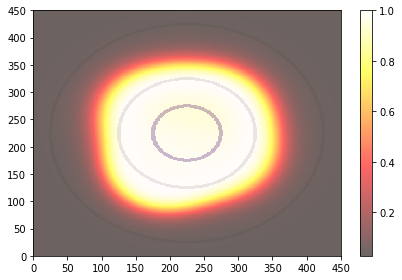

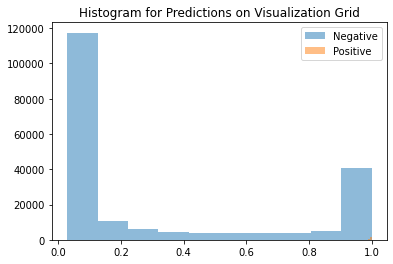

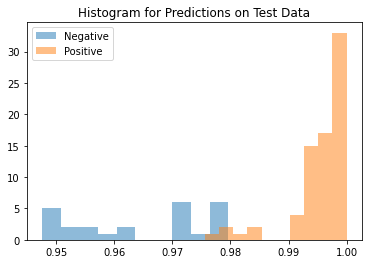

Average Difference between Positive and Negative Class: 0.030906498432159424
AUPR (Train): 1.0+-9.930136612989092e-17
AUPR (Test): 0.9936129891196662+-0.02709273511023822
Average Distance between Means: 0.16433361172676086+-0.1416226178407669


([0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  1.0,
  0.9999999999999999,
  1.0,
  0.9999999999999999],
 [0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  1.0,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.9999999999999999,
  0.8755385277421247,
  0.9980682981859621,
  0.9999999999999999,
  0.9986529564652371],
 [0.08039653,
  0.028953075,
  0.262586,
  0.13596016,
  0.10190827,
  0.118570626,
  0.18003249,
  0.118768156,
  0.13638306,
  0.14853299,
  0.21379721,
  0.46370745,
  0.15317273,
  0.60999846,
  0.2028324

In [19]:
# ES3r with MSE
separation = "ES"
bumped = "r"
sigma = 0.5
hidden_layers = 3
train = False    # train sigma. if NA, then False

verbose = 0      # can change this to 0 to suppress verbosity during training
plot = False
shuffle = False
val_split = 0.1

auprs_train = []
auprs_test = []
diff_means = []

# Train and Evaluate the Model
for i in range(20):
    
    # Create the model
    tf.keras.utils.set_random_seed(i)
    model = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
                 sigma=sigma, train=train, loss='mse',
                 seed=i)
    
    # Train the model
    aupr_train, aupr_test, diff_mean = train_eval(model, X, y, x_test, y_test,
               train=train, verbose=verbose, shuffle=shuffle, plot=plot,
               val_split=val_split, callbacks=[early_stopping], seed=i, diff=True)
    
    auprs_train.append(aupr_train)
    auprs_test.append(aupr_test)
    diff_means.append(diff_mean)
    
print(f"AUPR (Train): {np.mean(auprs_train)}+-{np.std(auprs_train)}")
print(f"AUPR (Test): {np.mean(auprs_test)}+-{np.std(auprs_test)}")
print(f"Average Distance between Means: {np.mean(diff_means)}+-{np.std(diff_means)}")
auprs_train, auprs_test, diff_means

## ES3b fixed $\sigma=0.5$ Model Averaging

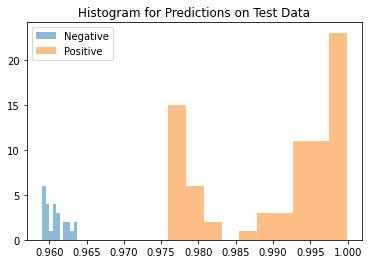

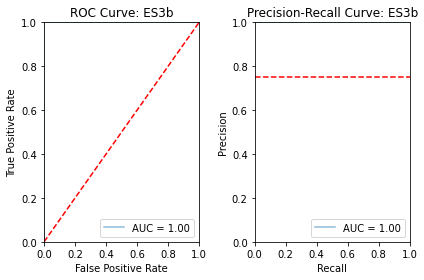

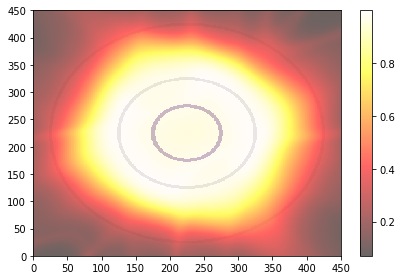

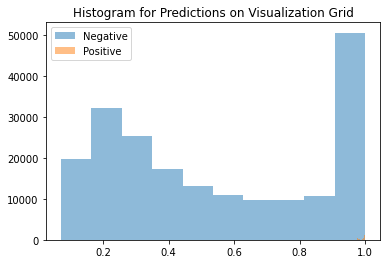

In [20]:
y_pred_list = [model(x_test) for model in models]
y_pred = tf.reduce_mean(y_pred_list, axis=0).numpy()

y_pred_pos = y_pred[y_test == 1]
y_pred_neg = y_pred[y_test == 0]
plt.title("Histogram for Predictions on Test Data")
plt.hist(y_pred_neg, bins=10, label="Negative", alpha=0.5)
plt.hist(y_pred_pos, bins=10, label="Positive", alpha=0.5)
plt.legend()
plt.show()

fpr, tpr, threshold = metrics.roc_curve(y_test, y_pred, pos_label=1)
roc_auc = metrics.auc(fpr, tpr)
precision, recall, threshold = metrics.precision_recall_curve(
    y_test, y_pred, pos_label=1)
pr_auc = metrics.auc(recall, precision)

fig, axs = plt.subplots(nrows=1, ncols=2)

axs[0].plot(fpr, tpr, alpha=0.5,
         label=f'AUC = %0.2f' % roc_auc)
axs[1].plot(recall, precision, alpha=0.5,
         label=f'AUC = %0.2f' % pr_auc)

axs[0].set_title(f'ROC Curve: {models[0].name}')
axs[0].legend(loc = 'lower right')
axs[0].plot([0, 1], [0, 1],'r--')
axs[0].set_xlim([0, 1])
axs[0].set_ylim([0, 1])
axs[0].set_ylabel('True Positive Rate')
axs[0].set_xlabel('False Positive Rate')
axs[1].set_title(f'Precision-Recall Curve: {models[0].name}')
axs[1].legend(loc = 'lower right')
axs[1].axhline(y_test.sum()/len(y_test), linestyle='--', color='r')
axs[1].set_xlim([0, 1])
axs[1].set_ylim([0, 1])
axs[1].set_ylabel('Precision')
axs[1].set_xlabel('Recall')
plt.tight_layout()
plt.show()

import csv
outcsv = open("heatmap_predictions.csv", mode="a")
writer = csv.writer(outcsv, delimiter=',', lineterminator='\n')

y_pred_list = [model(data_viz) for model in models]
y_pred = tf.reduce_mean(y_pred_list, axis=0).numpy()

transparency = 0.7
plt.pcolormesh(radius2, cmap="YlGn", alpha=transparency)
plt.pcolormesh(radius1, cmap="Greys", alpha=transparency)
plt.pcolormesh(radius05, cmap="RdPu", alpha=transparency)
y_im = y_pred.reshape(grid, grid)
norm = matplotlib.colors.Normalize(y_pred.min(), y_pred.max())
plt.pcolormesh(y_im, cmap="hot", norm=norm, alpha=0.6)
plt.colorbar()
plt.tight_layout()
plt.show()

plt.title("Histogram for Predictions on Visualization Grid")
y_pred_pos = y_pred[radius1.reshape(-1) == 1]
y_pred_neg = y_pred[radius1.reshape(-1) == 0]
plt.hist(y_pred_neg, bins=10, label="Negative", alpha=0.5)
plt.hist(y_pred_pos, bins=10, label="Positive", alpha=0.5)
plt.legend()
plt.show()

writer.writerow(np.hstack([[models[0].name + "_ensemble"], y_pred.squeeze()]))
outcsv.close()

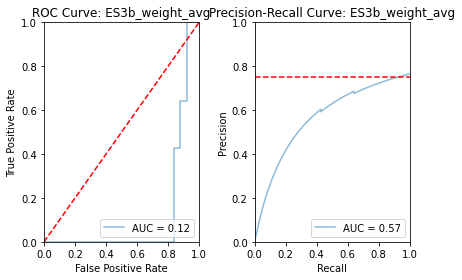

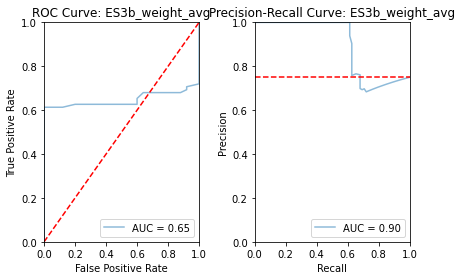

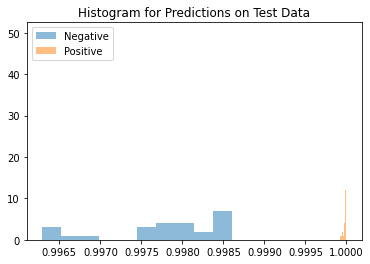

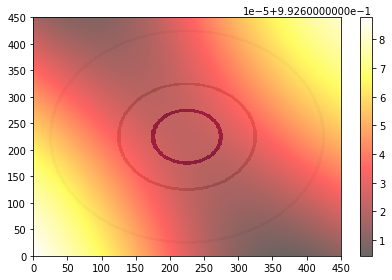

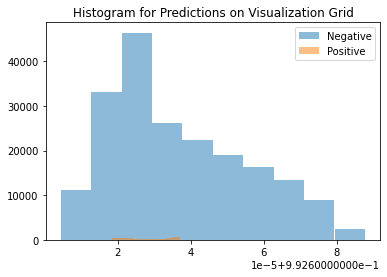

In [21]:
# Weight Averaging

weights = [model.get_weights() for model in models]

new_weights = list()

for weights_list_tuple in zip(*weights):
    if type(weights_list_tuple[0]) is np.float32:
        new_weights.append(np.mean(weights_list_tuple))
    else:
        new_weights.append(
            np.array([np.array(w).mean(axis=0)\
                for w in zip(*weights_list_tuple)]))

model_ensemble = create_model(separation, activation=bumped, hidden_layers=hidden_layers,
             sigma=sigma, train=train, loss='binary_crossentropy',
             seed=0, name_suffix="_weight_avg")

model_ensemble.set_weights(new_weights)

get_metrics(X, y, model_ensemble, plot=True)
get_metrics(x_test, y_test, model_ensemble, plot=True)

plt.title("Histogram for Predictions on Test Data")
y_pred = model(x_test).numpy()
y_pred_neg = y_pred[y_test == 0]
y_pred_pos = y_pred[y_test == 1]
plt.hist(y_pred_neg, bins=10, label="Negative", alpha=0.5)
plt.hist(y_pred_pos, bins=10, label="Positive", alpha=0.5)
plt.legend()
plt.show()

viz_boundary(data_viz, model_ensemble, grid=grid)